In [1]:
from cdlib import algorithms


Note: to be able to use all crisp methods, you need to install some additional packages:  {'infomap', 'karateclub', 'leidenalg', 'graph_tool', 'wurlitzer'}
Note: to be able to use all overlapping methods, you need to install some additional packages:  {'karateclub', 'ASLPAw'}
Note: to be able to use all bipartite methods, you need to install some additional packages:  {'wurlitzer', 'infomap', 'leidenalg'}


# <font color='red'>6.1 Importing libraries</font>

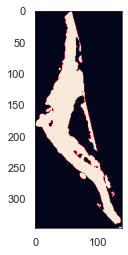

In [17]:
plt.imshow(ResultsDF.loc[0]['Patches'][1]!=0*1)

In [23]:
np.arange(0,360,15)

array([  0,  15,  30,  45,  60,  75,  90, 105, 120, 135, 150, 165, 180,
       195, 210, 225, 240, 255, 270, 285, 300, 315, 330, 345])

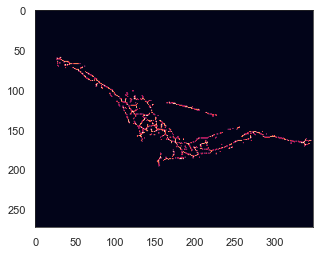

In [27]:
from skimage.transform import rotate
c = rotate(ResultsDF.loc[0]['Patches'][0],60,resize=True)

plt.imshow(c)

In [42]:
props[1]

IndexError: list index out of range

In [47]:
orientation*180/np.pi

9.679664112497882

In [65]:
orientation*np.pi/180

0.014670844890212975

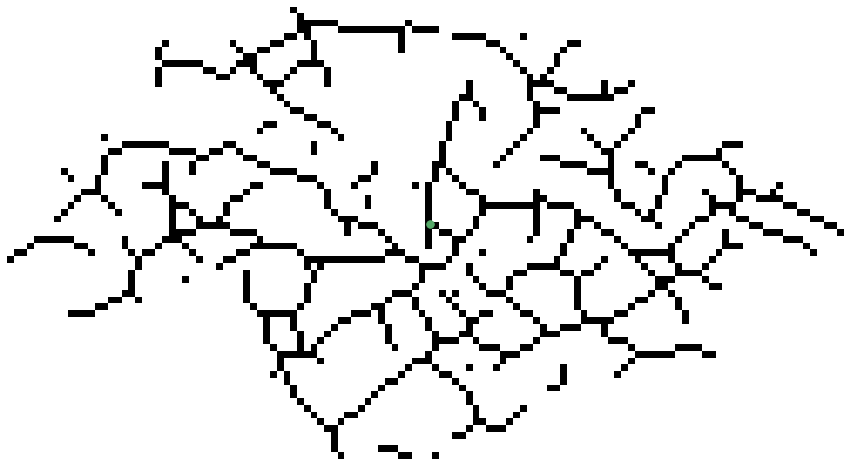

In [113]:
#plt.imshow(ResultsDF.loc[0]['Patches'][0])
sk = data.loc[8]['Patches'][0]
props    = regionprops(sk*1,sk*1)

orientation = props[0].orientation
skrot = rotate(sk,90-orientation*180/np.pi,resize=True)
fig,ax=plt.subplots(figsize=(15,15))
plt.imshow(1-sk,cmap='gray',zorder=2)
y0, x0 = props[0].centroid
x1 = x0 + math.cos(orientation) * 0.5 * props[0].axis_minor_length
y1 = y0 - math.sin(orientation) * 0.5 * props[0].axis_minor_length
x2 = x0 - math.sin(orientation) * 0.5 * props[0].axis_major_length
y2 = y0 - math.cos(orientation) * 0.5 * props[0].axis_major_length
ax.plot(x0, y0, '.g', markersize=15,zorder=8)

ax.plot(ResultsRow['Nucleus Centroid'][1],ResultsRow['Nucleus Centroid'][0],'o',color='#6495ED',markersize=12,zorder=8)
ax.plot(ResultsRow['Nucleus Contour'][:,0],ResultsRow['Nucleus Contour'][:,1],'--',color='#6495ED',zorder=11,linewidth=2.5)
         

# #ax.plot(y0, y1, 'r', linewidth=5,zorder=5)
# ax.plot((x0, x1),(y0, y1), 'r', linewidth=5,zorder=5)
# ax.plot((x0, x1),(y0, y1), 'r', linewidth=5,zorder=5)
# ax.plot((x0, x2), (y0, y2), '-r', linewidth=5,zorder=6)
plt.axis('off')
plt.savefig(".//CytoskeletonOrganisationExamples//complexity_skrot2" + str(i) + ".png",format='png',transparent=True,bbox_inches='tight',dpi=500)
plt.show()

In [98]:
x0,x2

(62.10831234256927, 6.36891063718042)

In [1]:
data

NameError: name 'data' is not defined

In [28]:
from fractal_dimension import fractal_dimension
from skimage.transform import rotate
i = 0
res = []
for index,row in ResultsDF.iterrows():
    sk = row['Patches'][0]
    #dv = row['Patches'][1]
    props    = regionprops(sk*1,sk*1)
    orientation = props[0].orientation
    skrot = rotate(sk,90-orientation*180/np.pi,resize=True)
    act = []
    
    for ang in np.arange(0,360,15):
        # Get cell major axis
        #props    = regionprops((dv!=0)*1,dv)
        rot = rotate(skrot,ang,resize=True)
        act += [fractal_dimension(rot,threshold=1)]
    
    res += [np.mean(act)]


#temp['DCF:Fractal Dimension New'] = res 

In [1]:
# Math, image processing and other useful libraries
from __future__ import print_function, unicode_literals, absolute_import, division
import os

import pandas as pd
import numpy as np
import cv2
from collections import OrderedDict
import copy
import math
import pickle
from matplotlib.ticker import MaxNLocator
from itertools import combinations

# Image processing
from skimage.measure import regionprops
from skimage.filters import meijering, sato, frangi, hessian, threshold_otsu
from skimage.morphology import extrema, skeletonize
from skimage.transform import probabilistic_hough_line
from skimage.draw import disk, circle_perimeter
from scipy.ndimage import gaussian_filter, grey_closing
from scipy.spatial import distance_matrix
from skimage import data, restoration, util
from roipoly import RoiPoly
from matplotlib_scalebar.scalebar import ScaleBar
from biosppy.signals import tools
from biosppy.stats import pearson_correlation
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Plotting
import matplotlib.pyplot as plt
import matplotlib.cm as pltc
import matplotlib.colors as colors
import seaborn as sns

# Widgets
import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual
from IPython.display import display

# Feature Extraction (.py files by Teresa Parreira)
# from CytoSkeletonPropsMorph import CytoSkeletonPropsMorph
# from CytoSkeletonRegionPropsInt import RegionPropsInt
# from FreqAnalysis import FreqAnalysis
# from GLCM import GLCM

# Graph
import sknw
import networkx as nx
from scipy.signal import argrelextrema

# 
from skan import Skeleton, summarize,draw
from skan.csr import skeleton_to_csgraph, sholl_analysis,make_degree_image
import scipy as sp
import scipy.sparse
from matplotlib.patches import Circle
from ImageFeatures import ImageFeatures,getvoxelsize
from Functions import FeaturesFromCentroid, cv2toski,pylsdtoski,polar_to_cartesian, truncate_colormap, plot_hist, plot_pie, remove_not1D, quantitative_analysis,hist_bin,hist_lim,create_separate_DFs,branch,graphAnalysis
from Importing import label_image,init_import
from PreProcessingCYTO import cytoskeleton_preprocessing, df_cytoskeleton_preprocessing
from PreProcessingNUCL import excludeborder, nuclei_preprocessing, df_nuclei_preprocessing, nuclei_segmentation
#from Processing import analyze_cell

#from fractal_dimension import fractal_dimension
#from fractal_analysis_fxns import boxcount,boxcount_grayscale,fractal_dimension,fractal_dimension_grayscale,fractal_dimension_grayscale_DBC

print('📚 All libraries successfully imported 📚')

ModuleNotFoundError: No module named 'ImageFeatures'

In [2]:
# Math, image processing and other useful libraries
from __future__ import print_function, unicode_literals, absolute_import, division
import os
import pandas as pd
import numpy as np
import cv2
from collections import OrderedDict
import copy
import math
import pickle
from matplotlib.ticker import MaxNLocator
from itertools import combinations

# Image processing
from skimage.measure import regionprops
from skimage.filters import meijering, sato, frangi, hessian, threshold_otsu
from skimage.morphology import extrema, skeletonize
from skimage.transform import probabilistic_hough_line
from skimage.draw import disk, circle_perimeter
from scipy.ndimage import gaussian_filter, grey_closing
from scipy.spatial import distance_matrix
from skimage import data, restoration, util
from roipoly import RoiPoly
fr# Math, image processing and other useful libraries
from __future__ import print_function, unicode_literals, absolute_import, division
import os

import pandas as pd
import numpy as np
import cv2
from collections import OrderedDict
import copy
import math
import pickle
from matplotlib.ticker import MaxNLocator
from itertools import combinations

# Image processing
from skimage.measure import regionprops
from skimage.filters import meijering, sato, frangi, hessian, threshold_otsu
from skimage.morphology import extrema, skeletonize
from skimage.transform import probabilistic_hough_line
from skimage.draw import disk, circle_perimeter
from scipy.ndimage import gaussian_filter, grey_closing
from scipy.spatial import distance_matrix
from skimage import data, restoration, util
from roipoly import RoiPoly
from matplotlib_scalebar.scalebar import ScaleBar
from biosppy.signals import tools
from biosppy.stats import pearson_correlation
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Plotting
import matplotlib.pyplot as plt
import matplotlib.cm as pltc
import matplotlib.colors as colors
import seaborn as sns

# Widgets
import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual
from IPython.display import display

# Feature Extraction (.py files by Teresa Parreira)
# from CytoSkeletonPropsMorph import CytoSkeletonPropsMorph
# from CytoSkeletonRegionPropsInt import RegionPropsInt
# from FreqAnalysis import FreqAnalysis
# from GLCM import GLCM

# Graph
import sknw
import networkx as nx
from scipy.signal import argrelextrema

# 
from skan import Skeleton, summarize,draw
from skan.csr import skeleton_to_csgraph, sholl_analysis,make_degree_image
import scipy as sp
import scipy.sparse
from matplotlib.patches import Circle
from ImageFeatures import ImageFeatures
from Functions import FeaturesFromCentroid, cv2toski,pylsdtoski,polar_to_cartesian, truncate_colormap, plot_hist, plot_pie, remove_not1D, quantitative_analysis,hist_bin,hist_lim,create_separate_DFs,branch,graphAnalysis
from Importing import label_image,init_import
from PreProcessingCYTO import cytoskeleton_preprocessing, df_cytoskeleton_preprocessing
from PreProcessingNUCL import excludeborder, nuclei_segmentation ,nuc_pre, df_nuclei_preprocessing
from Processing import analyze_cell

#from fractal_dimension import fractal_dimension
#from fractal_analysis_fxns import boxcount,boxcount_grayscale,fractal_dimension,fractal_dimension_grayscale,fractal_dimension_grayscale_DBC

print('📚 All libraries successfully imported 📚')om matplotlib_scalebar.scalebar import ScaleBar
from biosppy.signals import tools
from biosppy.stats import pearson_correlation
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Plotting
import matplotlib.pyplot as plt
import matplotlib.cm as pltc
import matplotlib.colors as colors
import seaborn as sns

# Widgets
import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual
from IPython.display import display

# Feature Extraction (.py files by Teresa Parreira)
# from CytoSkeletonPropsMorph import CytoSkeletonPropsMorph
# from CytoSkeletonRegionPropsInt import RegionPropsInt
# from FreqAnalysis import FreqAnalysis
# from GLCM import GLCM

# Graph
import sknw
import networkx as nx
from scipy.signal import argrelextrema

# 
from skan import Skeleton, summarize,draw
from skan.csr import skeleton_to_csgraph, sholl_analysis,make_degree_image
import scipy as sp
import scipy.sparse
from matplotlib.patches import Circle
from ImageFeatures import ImageFeatures
from Functions import label_image, FeaturesFromCentroid, cv2toski,pylsdtoski,init_import,polar_to_cartesian, truncate_colormap, plot_hist, plot_pie, remove_not1D, quantitative_analysis,hist_bin,hist_lim,create_separate_DFs,branch,graphAnalysis
#from fractal_dimension import fractal_dimension
#from fractal_analysis_fxns import boxcount,boxcount_grayscale,fractal_dimension,fractal_dimension_grayscale,fractal_dimension_grayscale_DBC

print('📚')

SyntaxError: invalid syntax (873145575.py, line 92)

In [1]:
# Math, image processing and other useful libraries
from __future__ import print_function, unicode_literals, absolute_import, division
import os

import pandas as pd
import numpy as np
import cv2
from collections import OrderedDict
import copy
import math
import pickle
from matplotlib.ticker import MaxNLocator
from itertools import combinations

# Image processing
from skimage.measure import regionprops
from skimage.filters import meijering, sato, frangi, hessian, threshold_otsu
from skimage.morphology import extrema, skeletonize
from skimage.transform import probabilistic_hough_line
from skimage.draw import disk, circle_perimeter
from scipy.ndimage import gaussian_filter, grey_closing
from scipy.spatial import distance_matrix
from skimage import data, restoration, util
from roipoly import RoiPoly
from matplotlib_scalebar.scalebar import ScaleBar
from biosppy.signals import tools
from biosppy.stats import pearson_correlation
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Plotting
import matplotlib.pyplot as plt
import matplotlib.cm as pltc
import matplotlib.colors as colors
import seaborn as sns

# Widgets
import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual
from IPython.display import display

# Feature Extraction (.py files by Teresa Parreira)
# from CytoSkeletonPropsMorph import CytoSkeletonPropsMorph
# from CytoSkeletonRegionPropsInt import RegionPropsInt
# from FreqAnalysis import FreqAnalysis
# from GLCM import GLCM

# Graph
import sknw
import networkx as nx
from scipy.signal import argrelextrema

# 
from skan import Skeleton, summarize,draw
from skan.csr import skeleton_to_csgraph, sholl_analysis,make_degree_image
import scipy as sp
import scipy.sparse
from matplotlib.patches import Circle
from framework.ImageFeatures import ImageFeatures,getvoxelsize
from framework.Functions import cv2toski,pylsdtoski,polar_to_cartesian, remove_not1D, quantitative_analysis,hist_bin,hist_lim,create_separate_DFs,branch,graphAnalysis
from framework.Importing import label_image,init_import
from framework.PreProcessingCYTO import cytoskeleton_preprocessing, df_cytoskeleton_preprocessing
from framework.PreProcessingNUCL import excludeborder, nuclei_preprocessing, df_nuclei_preprocessing, nuclei_segmentation
from framework.Processing import process3Dnuclei,analyze_cell
from framework.visualization import truncate_colormap, plot_hist, plot_pie
#from fractal_dimension import fractal_dimension
#from fractal_analysis_fxns import boxcount,boxcount_grayscale,fractal_dimension,fractal_dimension_grayscale,fractal_dimension_grayscale_DBC

print('📚 All libraries successfully imported 📚')

📚 All libraries successfully imported 📚


# <font color='red'>6.2 Import and Create DataFrame with available images</font>

In [2]:
global OriginalDF,DeconvDF,DenoisedDF,NoiseDF,NucleiDeconvDF,SyntheticDF

### DATASET #1 (2D)
folder    = os.path.dirname(os.getcwd()) + "\\Datasets\\Set 1-a-tubulin_Sofia"
options   = ["RGB","CYTO_DECONV","NUCL_DECONV"]



data = init_import(folder,options)


#res = init_import(folder=os.getcwd() + "\\Datasets\\Set 1-a-tubulin_Sofia",
                 # options=["RGB","CYTO_DECONV","NUCL_DECONV"])

#OriginalDF,DeconvDF,NucleiDeconvDF = res[0],res[1],res[2]

ResultsDF = pd.read_pickle(".//ResultsDF_LSD_Last2.p")    # este método nao CAUSA O EVAL!!!
#ResultsDF = pd.read_excel(os.getcwd() + '\\ResultsSofia.xlsx',index_col=0)
#maximos = pickle.load(open('maximos.p', 'rb')) 
#maximos

print('🌠')

>>> [RGB] added.
>>> [CYTO_DECONV] added.
>>> [NUCL_DECONV] added.
🌠


In [14]:
nucDF = pd.read_pickle(".//nucDF_4SL.pkl")  

In [ ]:
nucDF = pd.read_pickle(".//nucDF_27jan.pkl")  

In [2]:
nucDF = pd.read_pickle(".//nucDF_14fev_notfilt.pkl")

In [6]:
nucDF = pd.read_pickle(".//nucDF_16fev_clean.pkl")

In [4]:
nucDF = pd.read_pickle(".//nucDF_9mar_lastversion.pkl")

# <font color='red'>6.3 Plot Results</font>

## <font color='red'>6.3.2 Dataset Description</font>

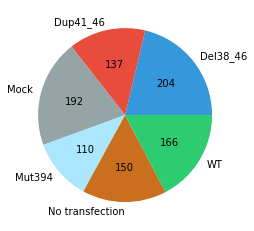

In [4]:
colors  = ['#3498DB','#E74C3C','#95A5A6','#ABE6FF','#CA6F1E','#2ECC71']
labels  = list(np.unique(ResultsDF['Label']))
try:
    labels.remove('Synthetic')
except:
    pass

def absolute_value(val):
    a  = int(np.round(val/100.*np.array([204, 137, 192, 110,150,166]).sum(), 0))
    return a


plt.pie(np.array([204, 137, 192, 110,150,166]),labels = labels,autopct=absolute_value,colors=colors)
plt.show()

## <font color='red'>6.3.2 Feature Histograms</font>

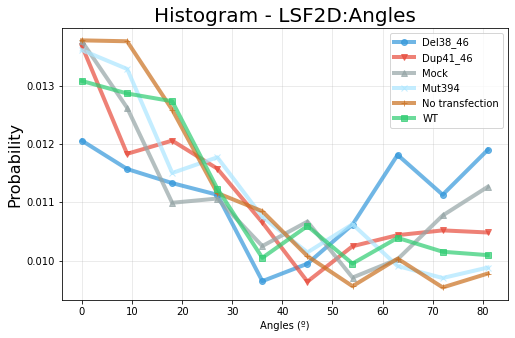

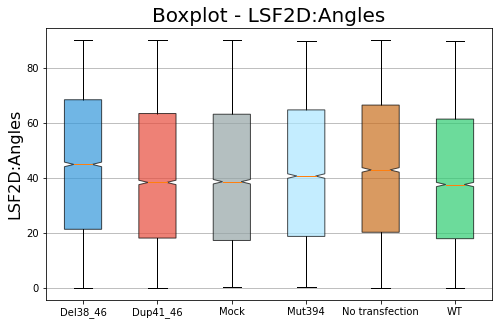

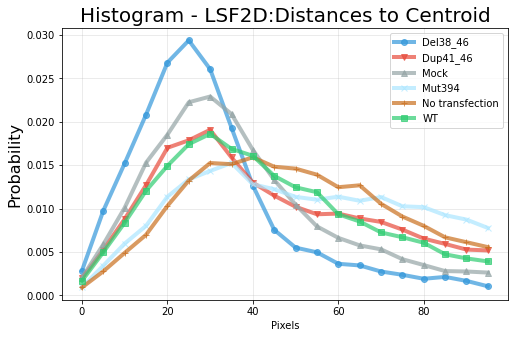

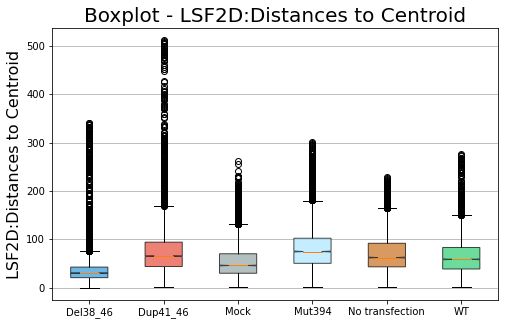

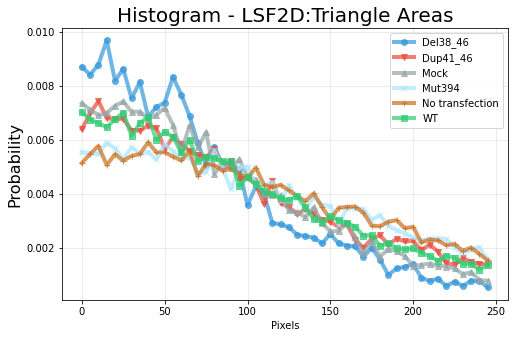

...

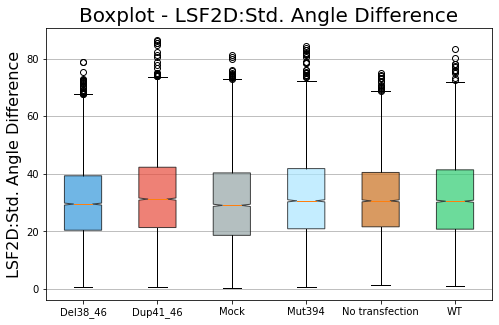

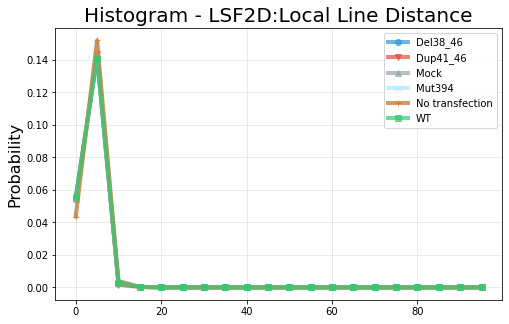

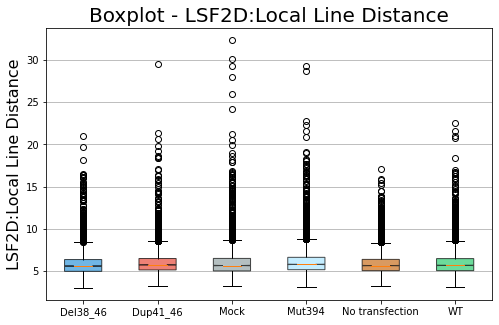

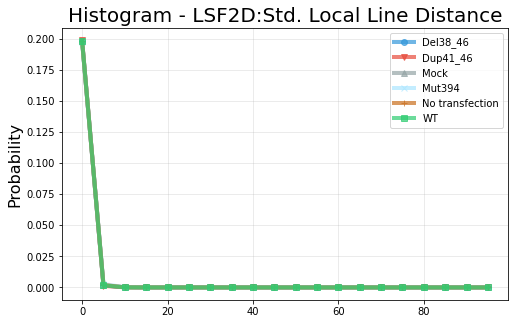

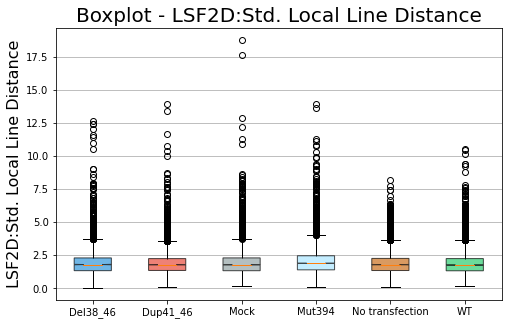

TypeError: eval() arg 1 must be a string, bytes or code object

<Figure size 576x360 with 0 Axes>

In [37]:
plot_generalized(ResultsDF)

## <font color='red'>6.3.3 2D Histograms</font>

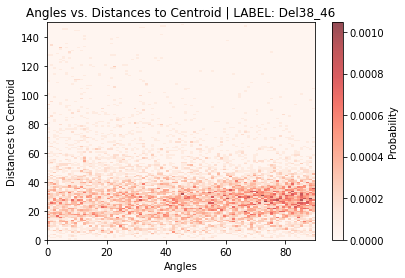

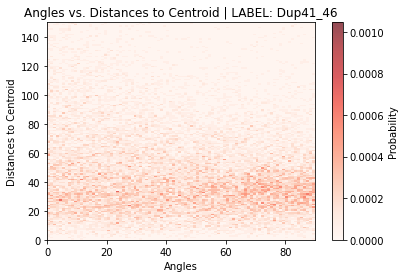

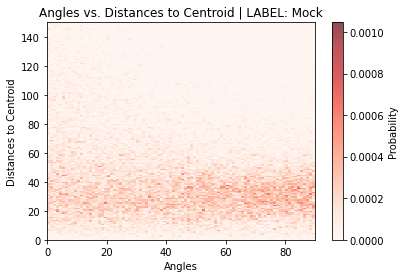

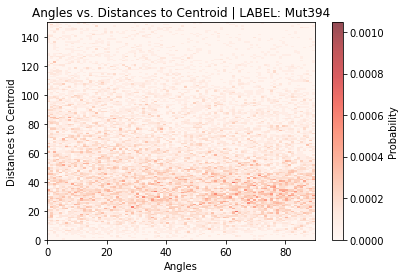

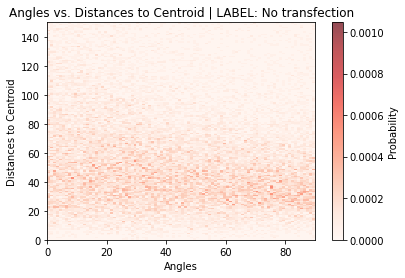

...

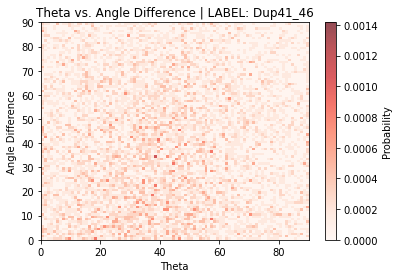

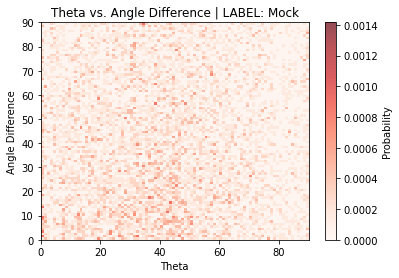

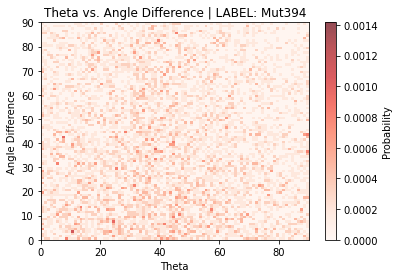

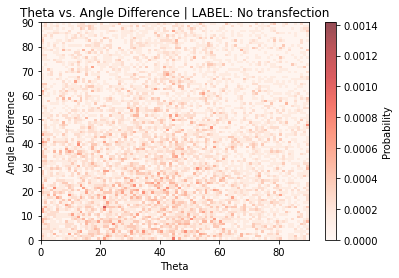

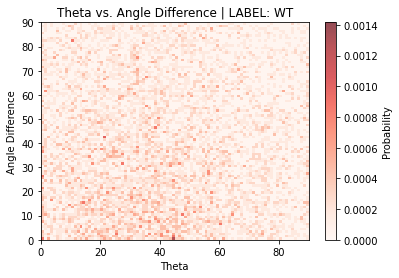

In [12]:
feats = list(ResultsDF.columns[2:8])
cmap = pltc.Reds
global new_cmap
new_cmap = truncate_colormap(cmap, 0.3, 1, 300)
labels  = list(np.unique(ResultsDF['Label']))

#print('MAXIMOS')
#maximos = []

#histog = np.histogram(np.array(feat_concat[~np.isnan(feat_concat)]),bins=30)
# plt.plot(histog[1][:-1],histog[0]/np.sum(histog[0]),color=colors[labels.index(label)],linewidth=4,label = label,alpha=0.7)

global comb,f1,f2
comb = combinations(range(len(feats)), 2)
#data = ImageLinesDF.tail(1)

c = 0
for f in list(comb):

    f1 = feats[f[0]]
    f2 = feats[f[1]]
    bin1 = hist_bin(f1)
    bin2 = hist_bin(f2)
    #print(bin1,bin2)
    
    global dat,getmax,hi
    getmax = []
    for label in labels:
        dat = ResultsDF[ResultsDF['Label'] == label]

        feat_concat_1 = []
        for x in dat[f1]:
            if type(x) == list:
                feat_concat_1 += x
            else:
                feat_concat_1 += [x]
        feat_concat_1 = pd.Series(feat_concat_1)

        feat_concat_2 = []
        for y in dat[f2]:
            if type(y) == list:
                feat_concat_2 += y
            else:
                feat_concat_2 += [y]
        feat_concat_2 = pd.Series(feat_concat_2)
            
        fig, ax = plt.subplots()
        
        # CHANGE !!!
        hi, xedges, yedges, image = plt.hist2d(feat_concat_1,feat_concat_2,bins=[bin1,bin2],cmap=cmap,alpha=0.7,density=True,vmax=maximos[c])   
        #hi, xedges, yedges, image = plt.hist2d(feat_concat_1,feat_concat_2,bins=[bin1,bin2],cmap=cmap,alpha=0.7,density=True)   
        
        
        getmax += [np.max(hi)]
        #ax.set_xticks(np.linspace(0,xedges[-1],10,endpoint=True,dtype=int))
        #ax.set_xlim(hist_lim(f1))
        
        #ax.set_yticks(np.linspace(0,yedges[-1],10,endpoint=True,dtype=int))
        #ax.set_xticks(hist_lim(f1))
        #ax.set_yticks(hist_lim(f2))
        #ax.set_ylim(hist_lim(f2))
        #print(hist_lim(f1),hist_lim(f2))
        ax.set_facecolor(cmap(0))
        plt.xlabel(feats[f[0]])
        plt.ylabel(feats[f[1]])
        plt.title(str(f1) + str(" vs. ") + str(f2) + str(" | LABEL: ") + str(label))
        cbar = fig.colorbar(image, ax=ax)
        cbar.set_label("Probability")
        #plt.savefig(".//ResultsGenAnalysis//Hough26Mar//2DHeatmaps//" + str(feats[f[0]]) + str("_vs_") + str(feats[f[1]]) + ".png",format='png',transparent=True,bbox_inches='tight')
        plt.show()
    
    # CHANGE !!!
    #maximos += [np.max(getmax)]
    c += 1

## <font color='red'>6.3.4 Barplots</font>

In [3]:
cols     = [x for x in data.columns if x.startswith("LSF2D") or x.startswith("LSF1D") or x.startswith("DCF") or x.startswith("DNF") or x.startswith("SKNW") or x.startswith("OTHERS")]


AttributeError: 'collections.OrderedDict' object has no attribute 'columns'

NameError: name 'cols' is not defined

In [103]:
aux.columns[1:]

Index(['LSF1D:Line Lengths sigma_mu', 'N over A', 'LSF2D:Line Lengths mean',
       'AreaRatio'],
      dtype='object')

In [32]:
import statannot
def plot_barplot1(data):
    cols = list(data.columns[1:])
    #cols     = [x for x in data.columns if x.startswith("LSF2D") or x.startswith("LSF1D") or x.startswith("DCF") or x.startswith("DNF") or x.startswith("SKNW") or x.startswith("OTHERS")]
    #feats_1D = [x for x in df.columns if x.startswith("LSF2D")]
    #feats    = [x for x in df.columns if x.startswith("LSF1D") or x.startswith("DCF") or x.startswith("DNF") or x.startswith("SKNW") or x.startswith("OTHERS")]
    
    # 4
    colors   = ["#2ECC71","#FFA500","#E74C3C","#BC544B"]
    labels   = ['WT','NP','P1','P2']
    pairs    = [ (('WT', 'Dup41_46')), (('WT', 'Del38_46')), (('WT', 'Mut394')), (('Dup41_46', 'Del38_46')), (('Dup41_46', 'Mut394')),]  

    # 6
    #     colors   = ["#2ECC71","#DECF77","#5AB7BD","#FFA500","#E74C3C","#BC544B",]
    #     labels   = ['WT','No transfection','Mock','Dup41_46','Del38_46','Mut394']
    #     pairs    = [(('WT', 'No transfection')),(('WT', 'Mock')),(('WT', 'Dup41_46')), (('WT', 'Del38_46')), (('WT', 'Mut394'))] 

    

    for f in cols:
        try:
            data[f] = data[f].astype(float)
            print('floated')
        except: 
            continue

        
        print(data.groupby(['Label']).describe()[[(f,'mean'),(f,'std')]])

        fig,ax = plt.subplots()
        sns.set_theme(style="white")
        # 4
        sns.barplot(x="Label", y=f, data=data,order=['WT','Dup41_46','Del38_46','Mut394'],capsize=.1,errorbar=('ci', 95),edgecolor=colors,fill=False,linewidth=2)
        

        
        #cis = [container.get_yerr()[1]/2 for container in containers]
        
        ax.set_xticks(ax.get_xticks(),labels,font='arial',color='k')
        ax.set_yticks(ax.get_yticks(),font='arial',color='k')
        



        patches = ax.patches
        lines_per_err = 3

        for i, line in enumerate(ax.get_lines()):
            newcolor = patches[i // lines_per_err].get_edgecolor()
            line.set_color(newcolor)

        ax.set_xlabel(None)
        plt.rcParams['axes.linewidth'] = 0.75  
        statannot.add_stat_annotation(plt.gca(),data=data,x="Label",y=f, order=['WT','Dup41_46','Del38_46','Mut394'],box_pairs=pairs,test='t-test_ind',text_format="star",loc="outside",fontsize='small',comparisons_correction=None,color='k',linewidth=0.75)

        sns.despine(left=True)
        plt.grid(alpha=0.2,axis='y')




        plt.show()
        
        

In [48]:
list(ResultsDF.groupby(['Label']).describe().columns)

[('LSF1D:Number of Lines', 'count'),
 ('LSF1D:Number of Lines', 'mean'),
 ('LSF1D:Number of Lines', 'std'),
 ('LSF1D:Number of Lines', 'min'),
 ('LSF1D:Number of Lines', '25%'),
 ('LSF1D:Number of Lines', '50%'),
 ('LSF1D:Number of Lines', '75%'),
 ('LSF1D:Number of Lines', 'max'),
 ('LSF1D:Radial Score', 'count'),
 ('LSF1D:Radial Score', 'mean'),
 ('LSF1D:Radial Score', 'std'),
 ('LSF1D:Radial Score', 'min'),
 ('LSF1D:Radial Score', '25%'),
 ('LSF1D:Radial Score', '50%'),
 ('LSF1D:Radial Score', '75%'),
 ('LSF1D:Radial Score', 'max'),
 ('DCF:AAI', 'count'),
 ('DCF:AAI', 'mean'),
 ('DCF:AAI', 'std'),
 ('DCF:AAI', 'min'),
 ('DCF:AAI', '25%'),
 ('DCF:AAI', '50%'),
 ('DCF:AAI', '75%'),
 ('DCF:AAI', 'max'),
 ('DCF:Fractal Dim B', 'count'),
 ('DCF:Fractal Dim B', 'mean'),
 ('DCF:Fractal Dim B', 'std'),
 ('DCF:Fractal Dim B', 'min'),
 ('DCF:Fractal Dim B', '25%'),
 ('DCF:Fractal Dim B', '50%'),
 ('DCF:Fractal Dim B', '75%'),
 ('DCF:Fractal Dim B', 'max'),
 ('DCF:Fractal Dim D', 'count'),
 ('

In [3]:
LSF,DCF,DNF,SKNW,OTHERS,FULL = create_separate_DFs(ResultsDF)

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt =

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt =

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  skew = stats.skew(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:994: DeprecationWarning: Please use `kurtosis` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  kurt = stats.kurtosis(signal, bias=False)
C:\Users\diogo\anaconda3\envs\Cytosk_recentpy\lib\site-packages\biosppy\signals\tools.py:997: DeprecationWarning: Please use `skew` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  sk

In [4]:
FULL['Label'] = ResultsDF['Label']

In [5]:
FULL.to_excel('full1.xlsx')

In [71]:
#FULL['LSF1D:Line Lengths sigma_mu'] = FULL['LSF2D:Line Lengths std_dev'] / FULL['LSF2D:Line Lengths mean']


In [19]:
FULL['LSF1D:N over A'] = ResultsDF['LSF1D:Number of Lines'] / ResultsDF['DCF:Area']


In [24]:
FULL['Label'] = ResultsDF['Label']
FULL['AreaRatio'] = [est_area(row) for index,row in ResultsDF.iterrows()]
abcd = [exp_area(row) for index,row in ResultsDF.iterrows()]
FULL['N over A'] = ResultsDF['LSF1D:Number of Lines'] / abcd 
FULL['AreaRatio2'] = ResultsDF['DNF:Area'] / abcd

In [27]:
FULL['AreaRatio3'] = ResultsDF['DNF:Area'] / ResultsDF['DCF:Area']

In [10]:
FULL

,LSF2D:Angles mean,LSF2D:Angles median,LSF2D:Angles min,LSF2D:Angles max,LSF2D:Angles max_amp,LSF2D:Angles var,LSF2D:Angles std_dev,LSF2D:Angles abs_dev,LSF2D:Angles kurtosis,LSF2D:Angles skewness,...,SKNW:Sholl Crossings Nuclei abs_dev,SKNW:Sholl Crossings Nuclei kurtosis,SKNW:Sholl Crossings Nuclei skewness,OTHERS:Cytoskeleton-Nuclei Centroid Distance,OTHERS:Weighted Cytoskeleton-Nuclei Centroid Distance,OTHERS:Area Ratio (Cyto vs. Nucl),OTHERS:Main Vector Magnitude,Label,AreaRatio,N over A
0,42.118819,42.6135,0.653,88.564,46.445181,681.446097,26.104523,22.294162,-1.156904,0.015657,...,2.731707,-0.364165,0.803558,49.774633,26.837390,0.551899,1440.873319,No transfection,1.211504,0.042381
1,38.247571,32.7200,0.110,89.821,51.573429,611.740725,24.733393,20.623371,-0.912833,0.447531,...,4.785714,-1.432878,-0.042269,12.957109,22.330308,0.560575,1762.518556,No transfection,1.024347,0.041761
2,40.988292,41.0480,0.469,89.311,48.322708,588.789910,24.264994,20.487903,-1.017673,0.141394,...,2.700000,-0.649507,0.697840,45.713312,22.855052,0.504579,1411.933387,No transfection,1.111451,0.039731
3,34.410041,29.6145,0.010,89.457,55.046959,552.630728,23.508099,19.644429,-0.744084,0.499252,...,2.687500,0.088586,0.265281,31.785819,11.760368,0.689381,1623.039870,No transfection,1.147967,0.035585
4,40.043208,34.2780,0.153,89.751,49.707792,667.581542,25.837599,21.744576,-1.110588,0.343506,...,3.193548,-0.757314,0.047207,13.882796,17.669537,0.838962,1619.936778,No transfection,1.609685,0.039807
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1041,44.940784,45.5975,0.200,89.893,44.952216,770.717599,27.761801,24.478352,-1.351367,-0.021940,...,3.782609,-0.206691,0.794692,9.726985,9.604814,0.639109,1041.488542,Del38_46,1.238769,0.028652
1042,46.319054,45.0875,0.009,89.896,46.310054,719.861266,26.830230,22.955765,-1.142417,0.015785,...,3.185185,2.941689,1.692583,3.374775,22.372585,0.998898,1065.467097,Del38_46,1.745955,0.031972
1043,46.013296,46.7640,0.134,89.480,45.879296,680.057166,26.077906,22.274704,-1.186548,0.030922,...,3.562500,-0.164782,1.115533,2.047217,6.801005,0.964766,690.681055,Del38_46,2.259528,0.03937
1044,41.532500,42.0985,0.574,88.448,46.915500,612.872823,24.756268,21.846682,-1.214958,0.114690,...,2.523810,-1.191049,0.284322,1.912660,16.950257,0.991805,770.446628,Del38_46,2.262556,0.030692


In [94]:
FULL['AreaRatio'].to_excel('arratio.xlsx')

In [60]:
ResultsDF.to_excel('results.xlsx')

In [58]:
print(c)

                LSF1D:Number of Lines            
                                 mean         std
Label                                            
Del38_46                   140.722222   78.737427
Dup41_46                   243.432258  153.212272
Mock                       194.965347   98.152302
Mut394                     262.338710  187.805032
No transfection            253.326316  164.554775
WT                         232.892655  176.898580


In [31]:
ResultsDF

,Name,Img Index,Label,Mask,Patches,Lines,Graph,LSF2D:Angles,LSF2D:Distances to Centroid,LSF2D:Triangle Areas,...,SKNW:Sholl Crossings Nuclei max_amp,SKNW:Sholl Crossings Nuclei var,SKNW:Sholl Crossings Nuclei std_dev,SKNW:Sholl Crossings Nuclei abs_dev,SKNW:Sholl Crossings Nuclei kurtosis,SKNW:Sholl Crossings Nuclei skewness,OTHERS:Cytoskeleton-Nuclei Centroid Distance,OTHERS:Weighted Cytoskeleton-Nuclei Centroid Distance,OTHERS:Area Ratio (Cyto vs. Nucl),OTHERS:Main Vector Magnitude
0,MAX_38_IF6_CHO_L-W5_Z_decon_ch02_PS.tif,38,No transfection,"[[False, False, False, False, False, False, Fa...","[[[False, False, False, False, False, False, F...","[((846.96, 125.385), (843.154, 135.458)), ((90...","[ (1, 2)\t1.0\n (2, 1)\t1.0\n (2, 4)\t1.0\n...","[24.256, 56.447, 77.093, 39.697, 65.666, 64.38...","[61.939, 143.836, 28.124, 126.194, 41.283, 66....","[137.0, 408.228, 53.471, 183.353, 64.306, 232....",...,8.073171,11.969512,3.459698,2.731707,-0.364165,0.803558,49.774633,26.837390,0.551899,1440.873319
1,MAX_38_IF6_CHO_L-W5_Z_decon_ch02_PS.tif,38,No transfection,"[[False, False, False, False, False, False, Fa...","[[[False, False, False, False, False, False, F...","[((1226.05, 591.863), (1229.906, 588.782)), ((...","[ (1, 2)\t1.0\n (2, 1)\t1.0\n (2, 4)\t1.414...","[11.074, 26.265, 40.852, 6.218, 77.168, 26.269...","[95.139, 23.384, 90.483, 73.611, 26.804, 96.53...","[45.096, 18.922, 177.546, 15.493, 70.073, 129....",...,8.928571,29.105820,5.394981,4.785714,-1.432878,-0.042269,12.957109,22.330308,0.560575,1762.518556
2,MAX_38_IF6_CHO_L-W5_Z_decon_ch02_PS.tif,38,No transfection,"[[False, False, False, False, False, False, Fa...","[[[False, False, False, False, False, False, F...","[((826.21, 118.655), (825.066, 124.886)), ((82...","[ (1, 2)\t1.0\n (2, 1)\t1.0\n (2, 3)\t1.414...","[28.672, 55.951, 31.395, 27.53, 25.057, 22.241...","[74.211, 25.097, 67.937, 28.992, 35.359, 27.39...","[112.783, 64.456, 149.307, 34.752, 69.741, 65....",...,7.050000,11.587179,3.403995,2.700000,-0.649507,0.697840,45.713312,22.855052,0.504579,1411.933387
3,MAX_38_IF6_CHO_L-W5_Z_decon_ch02_PS.tif,38,No transfection,"[[False, False, False, False, False, False, Fa...","[[[False, True, False, False, False, False, Fa...","[((881.97, 87.737), (872.975, 72.653)), ((879....","[ (1, 2)\t1.0\n (2, 1)\t1.0\n (2, 3)\t1.414...","[20.094, 57.405, 61.997, 11.955, 15.799, 30.33...","[83.948, 26.429, 102.525, 141.98, 98.202, 133....","[253.26, 118.564, 241.509, 224.165, 172.172, 6...",...,8.562500,12.963710,3.600515,2.687500,0.088586,0.265281,31.785819,11.760368,0.689381,1623.039870
4,MAX_38_IF6_CHO_L-W5_Z_decon_ch02_PS.tif,38,No transfection,"[[False, False, False, False, False, False, Fa...","[[[False, True, True, False, False, False, Fal...","[((919.221, 167.758), (920.078, 160.075)), ((9...","[ (1, 2)\t1.0\n (1, 3)\t1.4142135623730951\n...","[48.07, 4.47, 65.924, 53.998, 33.861, 23.61, 5...","[32.138, 49.333, 81.292, 30.35, 80.794, 123.43...","[92.418, 7.798, 208.683, 138.812, 203.711, 222...",...,8.419355,15.251613,3.905331,3.193548,-0.757314,0.047207,13.882796,17.669537,0.838962,1619.936778
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1041,MAX_40_IF6_CHO_L-W6_Z_decon_ch02_PS.tif,40,Del38_46,"[[False, False, False, False, False, False, Fa...","[[[True, False, False, False, False, False, Fa...","[((1302.876, 636.71), (1315.898, 650.104)), ((...","[ (1, 2)\t1.0\n (2, 1)\t1.0\n (2, 3)\t1.414...","[6.437, 51.558, 70.196, 2.449, 35.981, 45.614,...","[24.55, 54.236, 11.064, 16.849, 37.888, 7.025,...","[25.706, 253.343, 45.029, 1.354, 60.215, 14.18...",...,9.869565,22.118577,4.703039,3.782609,-0.206691,0.794692,9.726985,9.604814,0.639109,1041.488542
1042,MAX_40_IF6_CHO_L-W6_Z_decon_ch02_PS.tif,40,Del38_46,"[[False, False, False, False, False, False, Fa...","[[[False, False, False, False, False, False, F...","[((1219.212, 675.053), (1225.331, 671.735)), (...","[ (1, 3)\t1.4142135623730951\n (2, 4)\t1.0\n...","[29.14, 3.122, 56.54, 81.8

In [97]:
FULL['N over A'].to_excel('NoA.xlsx')

In [30]:
FULL['AreaRatio3'].to_excel('arearatio3.xlsx')

In [22]:
FULL['LSF1D:N over A'].to_excel('NoA.xlsx')

In [33]:
aux = FULL[['Label','LSF2D:Line Lengths std_dev','LSF1D:N over A','LSF2D:Line Lengths mean','OTHERS:Area Ratio (Cyto vs. Nucl)','AreaRatio','AreaRatio2','AreaRatio3']]
aux

,Label,LSF2D:Line Lengths std_dev,LSF1D:N over A,LSF2D:Line Lengths mean,OTHERS:Area Ratio (Cyto vs. Nucl),AreaRatio,AreaRatio2,AreaRatio3
0,No transfection,4.588935,0.019314,8.824576,0.551899,1.211504,0.554793,0.252828
1,No transfection,4.298120,0.022872,8.561683,0.560575,1.024347,0.930184,0.509449
2,No transfection,4.434379,0.018041,9.199246,0.504579,1.111451,0.568052,0.257933
3,No transfection,4.825041,0.021383,9.620663,0.689381,1.147967,0.57716,0.346825
4,No transfection,4.150913,0.020758,8.623139,0.838962,1.609685,0.737894,0.384795
...,...,...,...,...,...,...,...,...
1041,Del38_46,4.206728,0.014793,9.363988,0.639109,1.238769,0.744252,0.384257
1042,Del38_46,3.400318,0.018308,8.373066,0.998898,1.745955,0.699153,0.400353
1043,Del38_46,2.901335,0.016826,7.743392,0.964766,2.259528,0.988346,0.422399
1044,Del38_46,5.202183,0.013459,9.089464,0.991805,2.262556,0.729074,0.319711


C:\Users\diogo\AppData\Local\Temp\ipykernel_19188\1098287910.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[f] = data[f].astype(float)


floated
                LSF2D:Line Lengths std_dev          
                                      mean       std
Label                                               
Del38_46                          3.300500  0.560575
Dup41_46                          3.422480  0.608925
Mock                              3.520239  0.727190
Mut394                            3.437481  0.604193
No transfection                   3.713332  0.757372
WT                                3.730580  0.717674
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.650e-05 stat=4.186e+00
Dup41_46 v.s. Del38_46: t-test independent samples, P_val=5.158e-02 stat=1.953e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.560e-10 stat=6.501e+00
Dup41_46 v.s. Mut394: t-test independent samples, P_val=8.376e-01 stat=-2.052e-01
WT v.s. Mut394: t-test independe

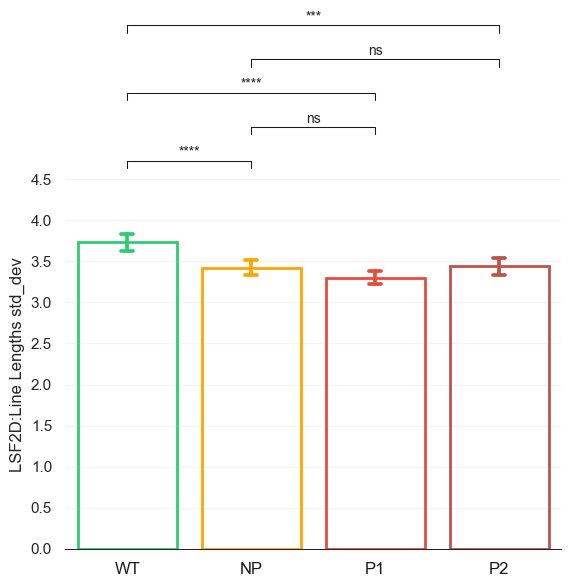

C:\Users\diogo\AppData\Local\Temp\ipykernel_19188\1098287910.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[f] = data[f].astype(float)


floated
                LSF1D:N over A          
                          mean       std
Label                                   
Del38_46              0.023029  0.004648
Dup41_46              0.024241  0.004278
Mock                  0.027466  0.004795
Mut394                0.024629  0.005952
No transfection       0.023356  0.003119
WT                    0.020149  0.004602
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.876e-15 stat=-8.352e+00
Dup41_46 v.s. Del38_46: t-test independent samples, P_val=1.223e-02 stat=2.519e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.237e-09 stat=-6.017e+00
Dup41_46 v.s. Mut394: t-test independent samples, P_val=5.283e-01 stat=-6.314e-01
WT v.s. Mut394: t-test independent samples, P_val=1.837e-12 stat=-7.356e+00


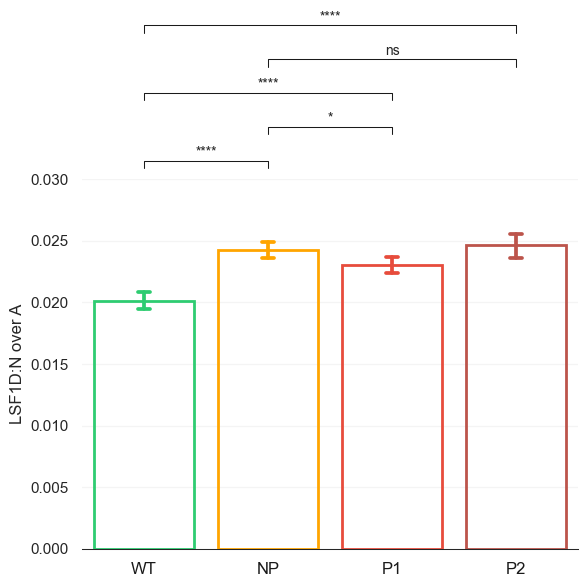

C:\Users\diogo\AppData\Local\Temp\ipykernel_19188\1098287910.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[f] = data[f].astype(float)


floated
                LSF2D:Line Lengths mean          
                                   mean       std
Label                                            
Del38_46                       7.950628  0.514477
Dup41_46                       7.945027  0.474782
Mock                           8.096827  0.649795
Mut394                         8.077026  0.572764
No transfection                8.230007  0.627465
WT                             8.401634  0.751890
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.821e-10 stat=6.509e+00
Dup41_46 v.s. Del38_46: t-test independent samples, P_val=9.164e-01 stat=-1.050e-01
WT v.s. Del38_46: t-test independent samples, P_val=3.295e-11 stat=6.838e+00
Dup41_46 v.s. Mut394: t-test independent samples, P_val=3.623e-02 stat=-2.105e+00
WT v.s. Mut394: t-test independent samples, P_val=6.453e-0

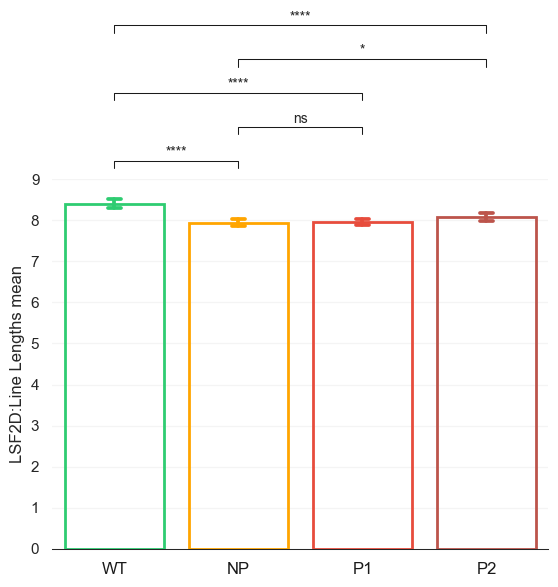

C:\Users\diogo\AppData\Local\Temp\ipykernel_19188\1098287910.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[f] = data[f].astype(float)


floated
                OTHERS:Area Ratio (Cyto vs. Nucl)          
                                             mean       std
Label                                                      
Del38_46                                 0.795120  0.174140
Dup41_46                                 0.717874  0.227670
Mock                                     0.883057  0.343019
Mut394                                   0.735973  0.252025
No transfection                          0.707482  0.178275
WT                                       0.758133  0.209729
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.457e-02 stat=1.677e+00
Dup41_46 v.s. Del38_46: t-test independent samples, P_val=3.480e-04 stat=-3.612e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.301e-02 stat=-1.865e+00
Dup41_46 v.s. Mut394: t-test independent samples,

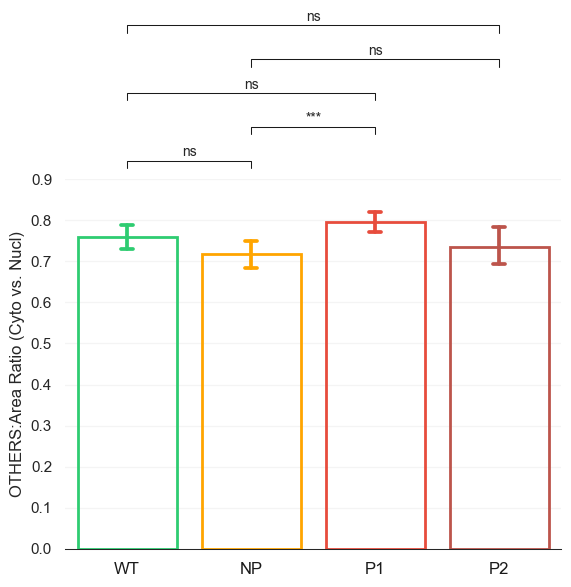

C:\Users\diogo\AppData\Local\Temp\ipykernel_19188\1098287910.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[f] = data[f].astype(float)


floated
                AreaRatio          
                     mean       std
Label                              
Del38_46         1.598087  0.536127
Dup41_46         1.337732  0.584222
Mock             1.760724  0.734061
Mut394           1.398434  0.588617
No transfection  1.334924  0.391154
WT               1.466611  0.623833
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.393e-02 stat=1.934e+00
Dup41_46 v.s. Del38_46: t-test independent samples, P_val=1.767e-05 stat=-4.353e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.881e-02 stat=-2.195e+00
Dup41_46 v.s. Mut394: t-test independent samples, P_val=3.908e-01 stat=-8.595e-01
WT v.s. Mut394: t-test independent samples, P_val=3.403e-01 stat=9.550e-01


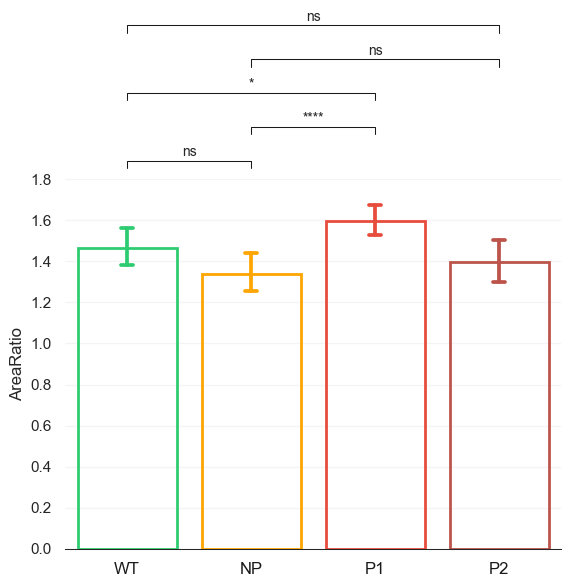

C:\Users\diogo\AppData\Local\Temp\ipykernel_19188\1098287910.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[f] = data[f].astype(float)


floated
                AreaRatio2          
                      mean       std
Label                               
Del38_46          1.155620  0.434118
Dup41_46          0.883532  0.401206
Mock              1.162612  0.453609
Mut394            0.892956  0.351991
No transfection   0.847125  0.295673
WT                0.768494  0.184023
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.903e-04 stat=-3.426e+00
Dup41_46 v.s. Del38_46: t-test independent samples, P_val=3.917e-09 stat=-6.041e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.319e-24 stat=-1.101e+01
Dup41_46 v.s. Mut394: t-test independent samples, P_val=8.371e-01 stat=-2.058e-01
WT v.s. Mut394: t-test independent samples, P_val=8.270e-05 stat=-3.991e+00


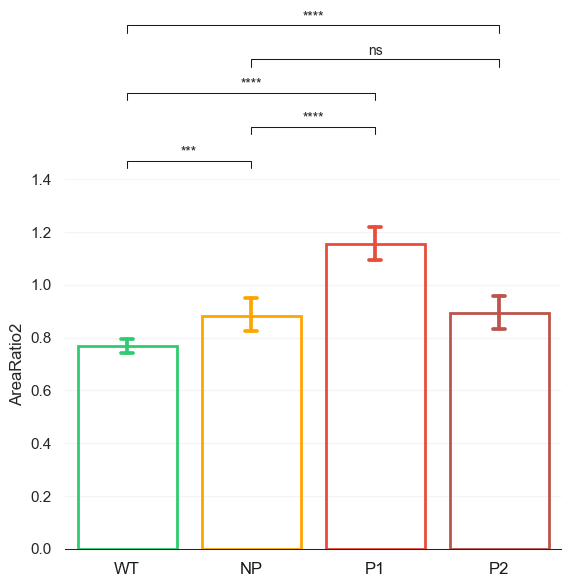

C:\Users\diogo\AppData\Local\Temp\ipykernel_19188\1098287910.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[f] = data[f].astype(float)


floated
                AreaRatio3          
                      mean       std
Label                               
Del38_46          0.574307  0.138462
Dup41_46          0.474697  0.136036
Mock              0.576375  0.154017
Mut394            0.475047  0.163711
No transfection   0.448486  0.136133
WT                0.411589  0.108311
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.811e-06 stat=-4.701e+00
Dup41_46 v.s. Del38_46: t-test independent samples, P_val=5.782e-11 stat=-6.760e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.861e-30 stat=-1.257e+01
Dup41_46 v.s. Mut394: t-test independent samples, P_val=9.844e-01 stat=-1.953e-02
WT v.s. Mut394: t-test independent samples, P_val=6.619e-05 stat=-4.047e+00


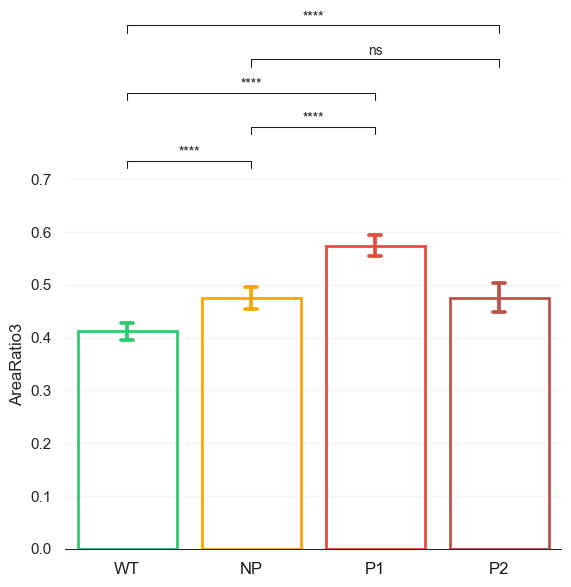

In [34]:
#from framework.analysis import plot_barplot
plot_barplot1(aux)

In [7]:
c.get_data()

AttributeError: 'AxesSubplot' object has no attribute 'get_data'

In [49]:
[x.get_height() for x in c.containers[0].get_children()]

[232.89265536723164,
 243.43225806451613,
 140.72222222222223,
 262.33870967741933]

In [17]:
[x.get_xydata() for x in c.lines]

[array([[  0.        , 207.71977401],
        [  0.        , 261.12754237]]),
 array([[-5.00000000e-02,  2.07719774e+02],
        [ 5.00000000e-02,  2.07719774e+02]]),
 array([[-5.00000000e-02,  2.61127542e+02],
        [ 5.00000000e-02,  2.61127542e+02]]),
 array([[  1.        , 219.90048387],
        [  1.        , 266.32774194]]),
 array([[  0.95      , 219.90048387],
        [  1.05      , 219.90048387]]),
 array([[  0.95      , 266.32774194],
        [  1.05      , 266.32774194]]),
 array([[  2.        , 130.39457071],
        [  2.        , 152.28964646]]),
 array([[  1.95      , 130.39457071],
        [  2.05      , 130.39457071]]),
 array([[  1.95      , 152.28964646],
        [  2.05      , 152.28964646]]),
 array([[  3.        , 232.79939516],
        [  3.        , 293.63991935]]),
 array([[  2.95      , 232.79939516],
        [  3.05      , 232.79939516]]),
 array([[  2.95      , 293.63991935],
        [  3.05      , 293.63991935]]),
 array([[  0. , 360.5],
        [  0. , 

In [1]:
dd.bar_label(dd.containers[0])

NameError: name 'dd' is not defined

In [8]:
lines = dd.lines[1]

[x.get_ydata() for x in dd.lines]

[array([207.97146893, 260.44858757]),
 array([207.97146893, 207.97146893]),
 array([260.44858757, 260.44858757]),
 array([221.77354839, 269.75467742]),
 array([221.77354839, 221.77354839]),
 array([269.75467742, 269.75467742]),
 array([130.88977273, 152.71325758]),
 array([130.88977273, 130.88977273]),
 array([152.71325758, 152.71325758]),
 array([232.34657258, 295.3641129 ]),
 array([232.34657258, 232.34657258]),
 array([295.3641129, 295.3641129]),
 [360.5, 367.5, 367.5, 360.5],
 [392.5728114478115, 399.5728114478115, 399.5728114478115, 392.5728114478115],
 [424.645622895623, 431.645622895623, 431.645622895623, 424.645622895623],
 [456.7184343434344, 463.7184343434344, 463.7184343434344, 456.7184343434344],
 [488.79124579124596,
  495.79124579124596,
  495.79124579124596,
  488.79124579124596]]

## <font color='red'>6.3.4 Violinplots</font>

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.101e-02 stat=-2.557e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.308e-05 stat=-4.047e+00
WT v.s. Mut394: t-test independent samples, P_val=6.237e-01 stat=-4.912e-01
o


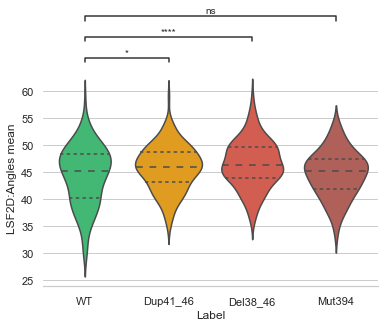

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.307e-02 stat=-2.140e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.341e-04 stat=-3.859e+00
WT v.s. Mut394: t-test independent samples, P_val=7.113e-01 stat=-3.704e-01
o


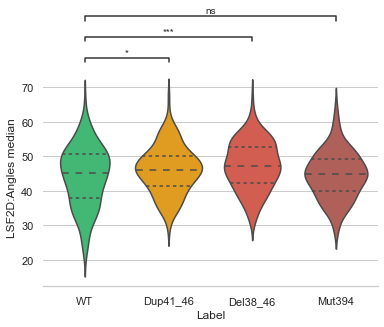

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.321e-01 stat=1.197e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.174e-04 stat=-3.561e+00
WT v.s. Mut394: t-test independent samples, P_val=5.154e-01 stat=6.512e-01
o


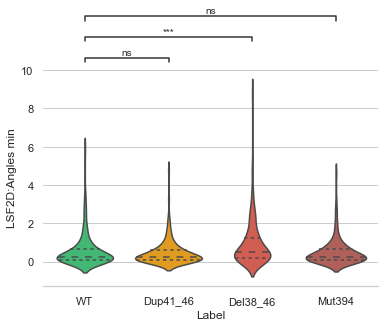

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.894e-02 stat=-2.358e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.070e-01 stat=1.023e+00
WT v.s. Mut394: t-test independent samples, P_val=8.247e-02 stat=-1.742e+00
o


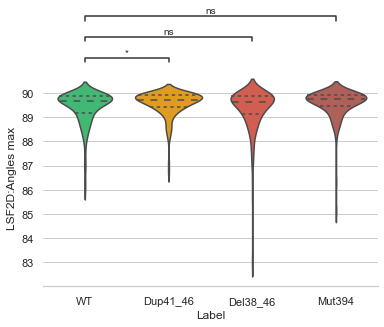

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.625e-02 stat=2.416e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.060e-03 stat=3.300e+00
WT v.s. Mut394: t-test independent samples, P_val=1.747e-02 stat=2.390e+00
o


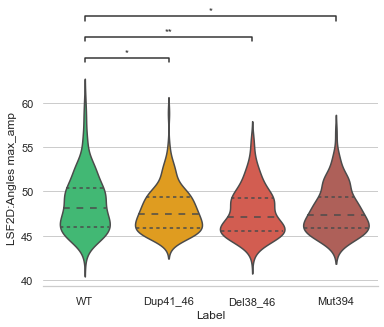

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.241e-02 stat=-1.688e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.846e-02 stat=-1.898e+00
WT v.s. Mut394: t-test independent samples, P_val=7.267e-01 stat=-3.498e-01
o


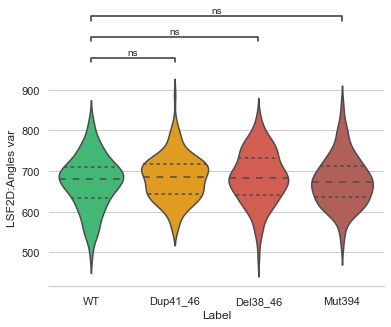

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.051e-02 stat=-1.753e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.903e-02 stat=-1.894e+00
WT v.s. Mut394: t-test independent samples, P_val=7.065e-01 stat=-3.770e-01
o


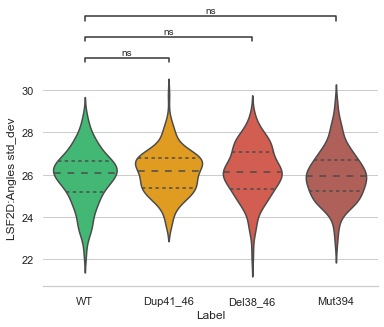

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.443e-02 stat=-2.018e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.062e-02 stat=-2.170e+00
WT v.s. Mut394: t-test independent samples, P_val=2.440e-01 stat=-1.167e+00
o


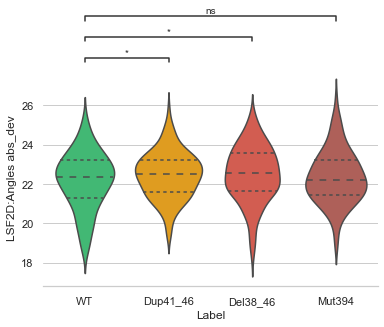

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.671e-02 stat=2.226e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.843e-02 stat=2.367e+00
WT v.s. Mut394: t-test independent samples, P_val=3.730e-02 stat=2.092e+00
o


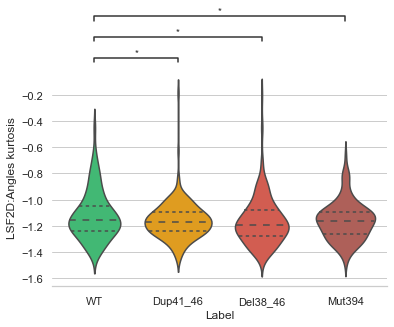

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.171e-02 stat=2.306e+00
WT v.s. Del38_46: t-test independent samples, P_val=8.580e-05 stat=3.971e+00
WT v.s. Mut394: t-test independent samples, P_val=6.125e-01 stat=5.071e-01
o


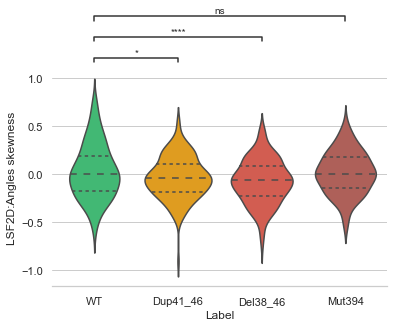

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.298e-01 stat=4.825e-01
WT v.s. Del38_46: t-test independent samples, P_val=2.606e-12 stat=7.239e+00
WT v.s. Mut394: t-test independent samples, P_val=5.513e-02 stat=-1.925e+00
o


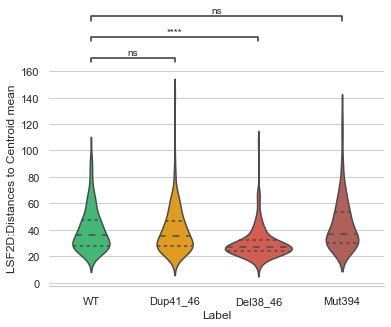

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.037e-01 stat=2.488e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.566e-12 stat=7.317e+00
WT v.s. Mut394: t-test independent samples, P_val=3.248e-02 stat=-2.148e+00
o


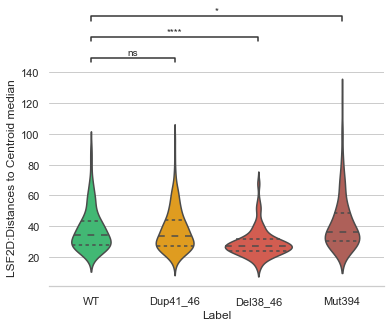

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.869e-01 stat=-5.438e-01
WT v.s. Del38_46: t-test independent samples, P_val=4.392e-01 stat=7.744e-01
WT v.s. Mut394: t-test independent samples, P_val=1.488e-01 stat=-1.447e+00
o


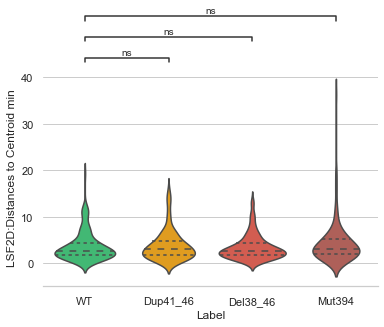

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.313e-01 stat=9.730e-01
WT v.s. Del38_46: t-test independent samples, P_val=4.764e-11 stat=6.778e+00
WT v.s. Mut394: t-test independent samples, P_val=4.568e-01 stat=-7.451e-01
o


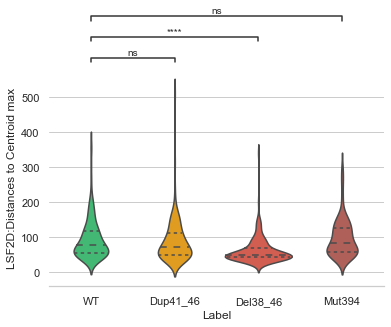

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.198e-01 stat=9.964e-01
WT v.s. Del38_46: t-test independent samples, P_val=2.087e-09 stat=6.142e+00
WT v.s. Mut394: t-test independent samples, P_val=8.046e-01 stat=-2.476e-01
o


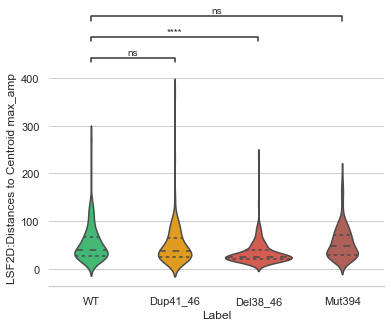

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.919e-01 stat=2.640e-01
WT v.s. Del38_46: t-test independent samples, P_val=2.947e-04 stat=3.654e+00
WT v.s. Mut394: t-test independent samples, P_val=5.052e-01 stat=-6.672e-01
o


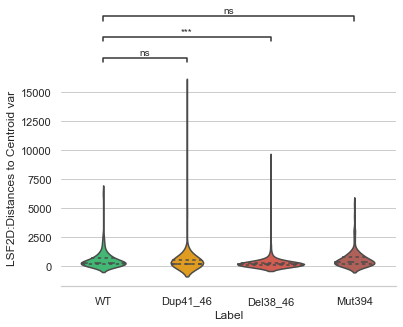

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.624e-01 stat=1.123e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.611e-09 stat=6.046e+00
WT v.s. Mut394: t-test independent samples, P_val=3.349e-01 stat=-9.659e-01
o


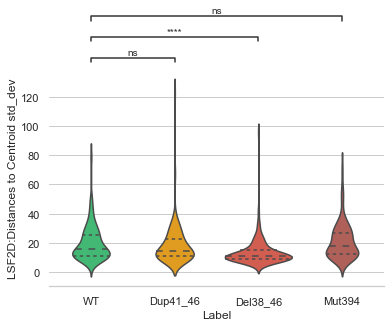

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.306e-01 stat=1.201e+00
WT v.s. Del38_46: t-test independent samples, P_val=9.431e-10 stat=6.280e+00
WT v.s. Mut394: t-test independent samples, P_val=1.803e-01 stat=-1.343e+00
o


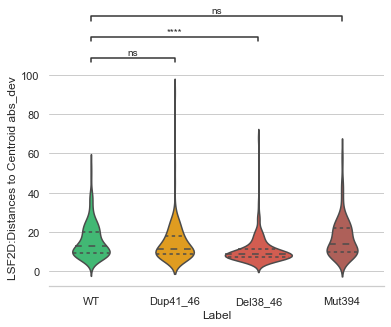

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.975e-01 stat=8.472e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.306e-04 stat=3.447e+00
WT v.s. Mut394: t-test independent samples, P_val=1.716e-02 stat=2.397e+00
o


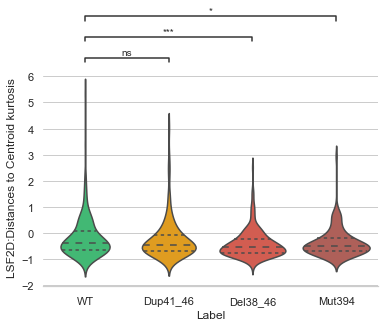

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.618e-02 stat=2.104e+00
WT v.s. Del38_46: t-test independent samples, P_val=9.082e-07 stat=4.994e+00
WT v.s. Mut394: t-test independent samples, P_val=3.801e-01 stat=8.791e-01
o


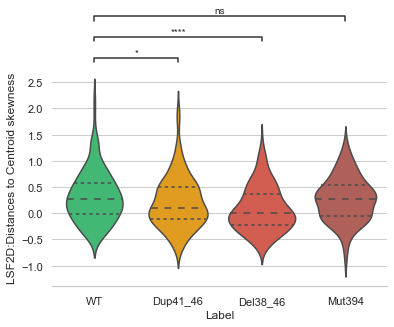

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.914e-01 stat=8.581e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.216e-13 stat=7.702e+00
WT v.s. Mut394: t-test independent samples, P_val=9.052e-02 stat=-1.698e+00
o


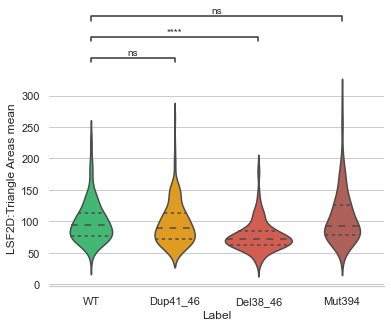

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.137e-01 stat=5.053e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.492e-12 stat=7.325e+00
WT v.s. Mut394: t-test independent samples, P_val=3.263e-02 stat=-2.147e+00
o


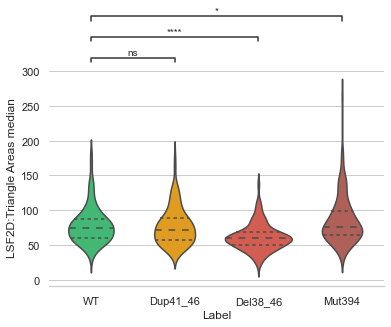

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.208e-01 stat=1.555e+00
WT v.s. Del38_46: t-test independent samples, P_val=8.124e-02 stat=-1.748e+00
WT v.s. Mut394: t-test independent samples, P_val=4.391e-01 stat=7.747e-01
o


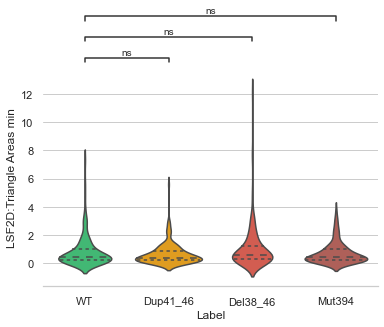

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.451e-01 stat=6.889e-02
WT v.s. Del38_46: t-test independent samples, P_val=3.496e-10 stat=6.449e+00
WT v.s. Mut394: t-test independent samples, P_val=1.006e-01 stat=-1.647e+00
o


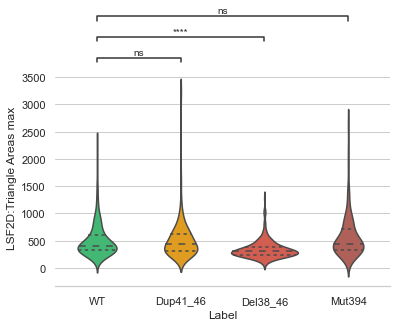

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.801e-01 stat=-2.493e-02
WT v.s. Del38_46: t-test independent samples, P_val=2.275e-09 stat=6.127e+00
WT v.s. Mut394: t-test independent samples, P_val=1.085e-01 stat=-1.610e+00
o


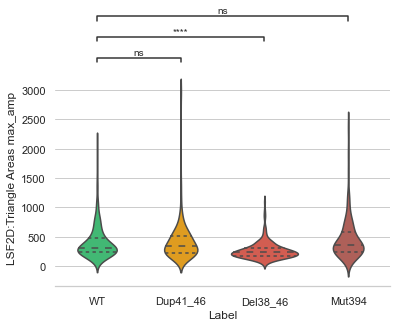

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.003e-01 stat=5.245e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.780e-08 stat=5.758e+00
WT v.s. Mut394: t-test independent samples, P_val=1.335e-01 stat=-1.505e+00
o


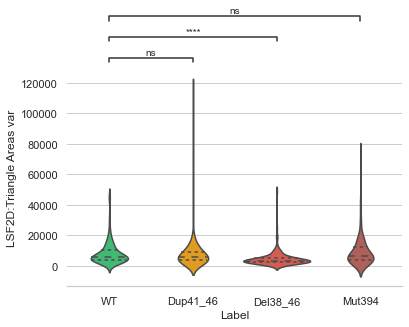

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.908e-01 stat=1.058e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.351e-12 stat=7.127e+00
WT v.s. Mut394: t-test independent samples, P_val=2.097e-01 stat=-1.257e+00
o


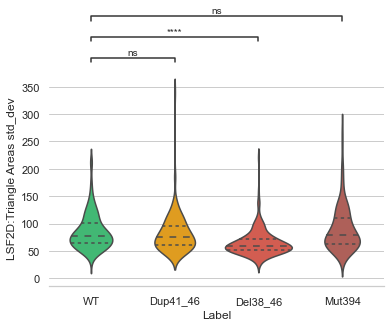

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.524e-01 stat=1.146e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.811e-13 stat=7.423e+00
WT v.s. Mut394: t-test independent samples, P_val=2.042e-01 stat=-1.272e+00
o


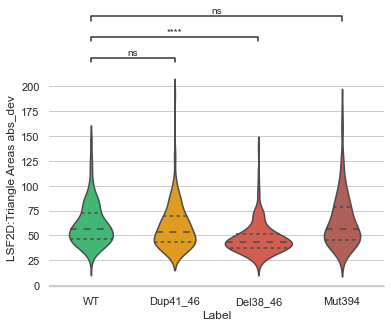

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.139e-01 stat=-1.009e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.570e-02 stat=1.846e+00
WT v.s. Mut394: t-test independent samples, P_val=2.833e-01 stat=-1.075e+00
o


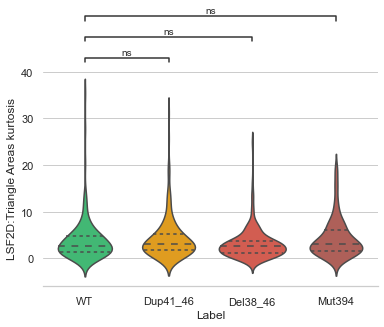

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.490e-01 stat=-7.580e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.270e-01 stat=1.529e+00
WT v.s. Mut394: t-test independent samples, P_val=4.189e-01 stat=-8.095e-01
o


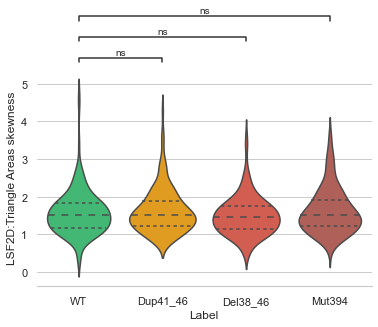

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.821e-10 stat=6.509e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.295e-11 stat=6.838e+00
WT v.s. Mut394: t-test independent samples, P_val=6.453e-05 stat=4.053e+00
o


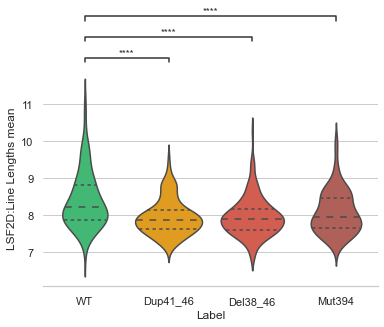

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.346e-11 stat=7.011e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.357e-10 stat=6.515e+00
WT v.s. Mut394: t-test independent samples, P_val=1.086e-03 stat=3.299e+00
o


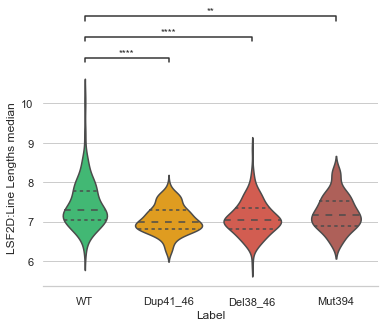

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.352e-01 stat=-2.083e-01
WT v.s. Del38_46: t-test independent samples, P_val=2.060e-06 stat=-4.823e+00
WT v.s. Mut394: t-test independent samples, P_val=5.757e-01 stat=-5.603e-01
o


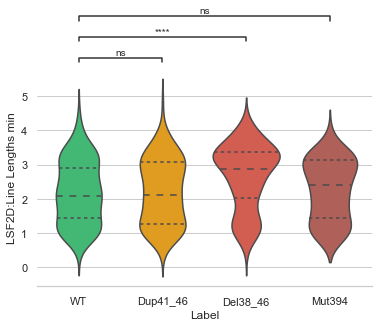

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.843e-01 stat=8.712e-01
WT v.s. Del38_46: t-test independent samples, P_val=4.723e-11 stat=6.780e+00
WT v.s. Mut394: t-test independent samples, P_val=2.616e-01 stat=1.125e+00
o


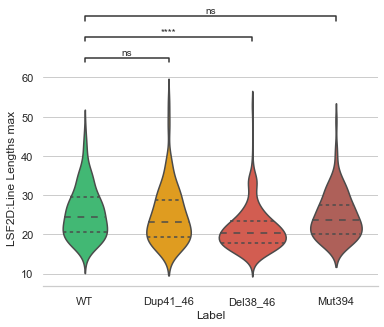

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.802e-01 stat=2.793e-01
WT v.s. Del38_46: t-test independent samples, P_val=3.382e-10 stat=6.454e+00
WT v.s. Mut394: t-test independent samples, P_val=4.680e-01 stat=7.266e-01
o


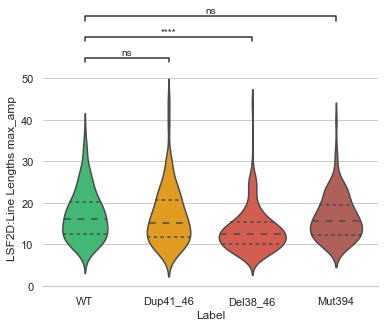

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.099e-04 stat=3.915e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.595e-09 stat=6.104e+00
WT v.s. Mut394: t-test independent samples, P_val=5.741e-04 stat=3.481e+00
o


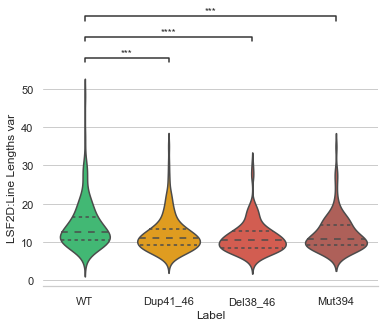

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.650e-05 stat=4.186e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.560e-10 stat=6.501e+00
WT v.s. Mut394: t-test independent samples, P_val=2.405e-04 stat=3.717e+00
o


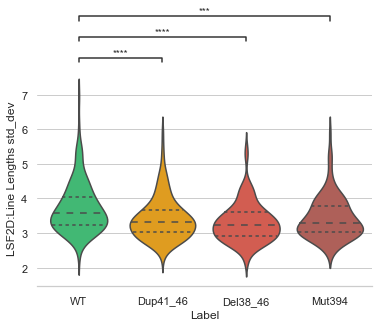

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.298e-08 stat=5.462e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.407e-10 stat=6.511e+00
WT v.s. Mut394: t-test independent samples, P_val=5.280e-06 stat=4.637e+00
o


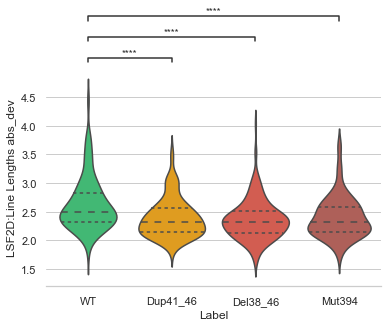

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.304e-02 stat=-2.283e+00
WT v.s. Del38_46: t-test independent samples, P_val=9.675e-03 stat=2.601e+00
WT v.s. Mut394: t-test independent samples, P_val=1.018e-01 stat=-1.641e+00
o


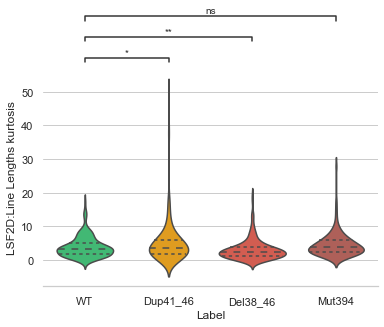

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.123e-02 stat=-1.810e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.091e-03 stat=2.708e+00
WT v.s. Mut394: t-test independent samples, P_val=1.376e-01 stat=-1.489e+00
o


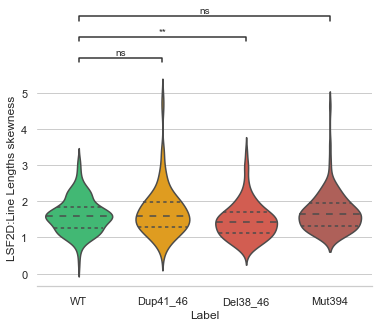

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.417e-01 stat=7.702e-01
WT v.s. Del38_46: t-test independent samples, P_val=5.077e-01 stat=6.631e-01
WT v.s. Mut394: t-test independent samples, P_val=2.439e-01 stat=1.168e+00
o


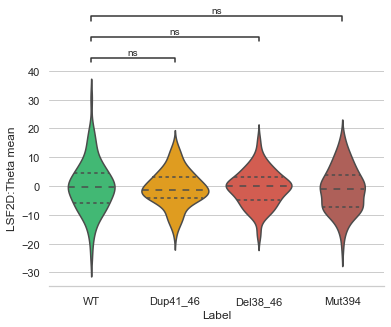

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.885e-01 stat=-1.436e-02
WT v.s. Del38_46: t-test independent samples, P_val=5.964e-01 stat=5.301e-01
WT v.s. Mut394: t-test independent samples, P_val=6.889e-01 stat=4.007e-01
o


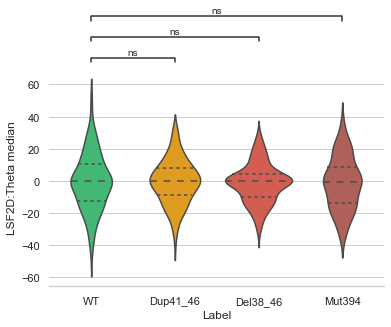

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.261e-01 stat=-2.199e-01
WT v.s. Del38_46: t-test independent samples, P_val=2.020e-05 stat=-4.318e+00
WT v.s. Mut394: t-test independent samples, P_val=4.924e-01 stat=6.873e-01
o


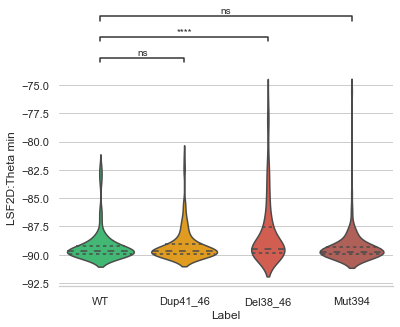

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.878e-01 stat=5.425e-01
WT v.s. Del38_46: t-test independent samples, P_val=7.833e-03 stat=2.674e+00
WT v.s. Mut394: t-test independent samples, P_val=2.893e-02 stat=-2.195e+00
o


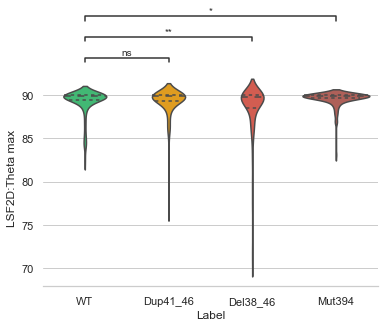

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.031e-03 stat=3.311e+00
WT v.s. Del38_46: t-test independent samples, P_val=8.940e-07 stat=4.998e+00
WT v.s. Mut394: t-test independent samples, P_val=9.189e-01 stat=1.019e-01
o


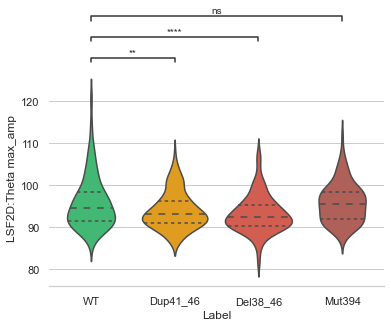

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.527e-02 stat=-2.248e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.139e-01 stat=1.008e+00
WT v.s. Mut394: t-test independent samples, P_val=4.434e-02 stat=-2.019e+00
o


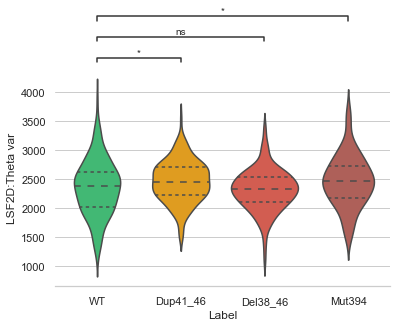

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.411e-02 stat=-2.467e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.495e-01 stat=7.570e-01
WT v.s. Mut394: t-test independent samples, P_val=3.765e-02 stat=-2.088e+00
o


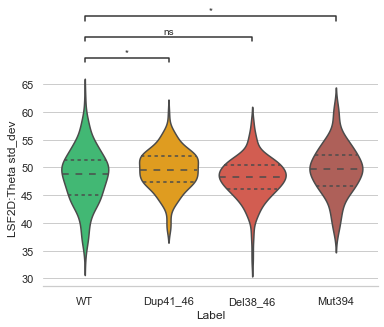

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.858e-04 stat=-3.389e+00
WT v.s. Del38_46: t-test independent samples, P_val=8.093e-01 stat=-2.415e-01
WT v.s. Mut394: t-test independent samples, P_val=1.824e-02 stat=-2.374e+00
o


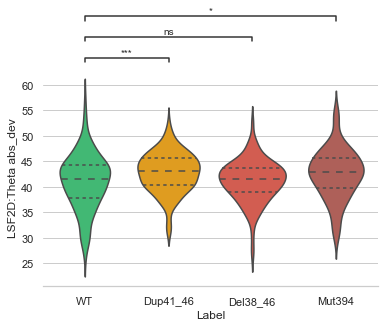

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.364e-06 stat=4.527e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.869e-02 stat=2.362e+00
WT v.s. Mut394: t-test independent samples, P_val=2.835e-02 stat=2.203e+00
o


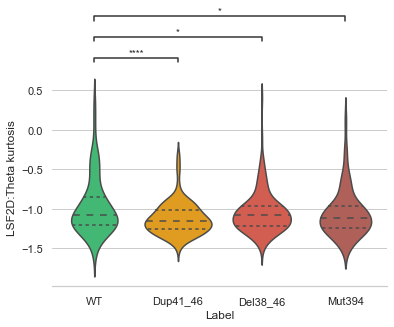

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.236e-01 stat=-9.594e-02
WT v.s. Del38_46: t-test independent samples, P_val=3.741e-01 stat=-8.898e-01
WT v.s. Mut394: t-test independent samples, P_val=5.416e-01 stat=-6.111e-01
o


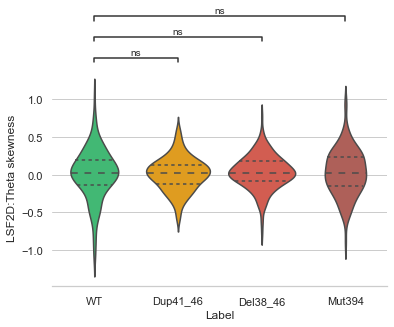

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.511e-05 stat=-3.979e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.493e-01 stat=-1.154e+00
WT v.s. Mut394: t-test independent samples, P_val=4.613e-02 stat=-2.002e+00
o


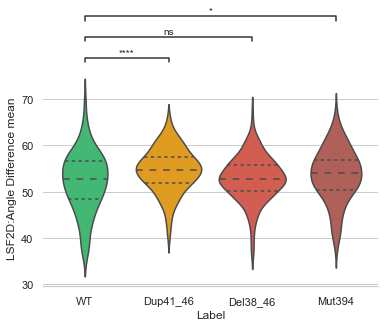

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.176e-04 stat=-3.639e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.834e-01 stat=-8.726e-01
WT v.s. Mut394: t-test independent samples, P_val=1.239e-01 stat=-1.543e+00
o


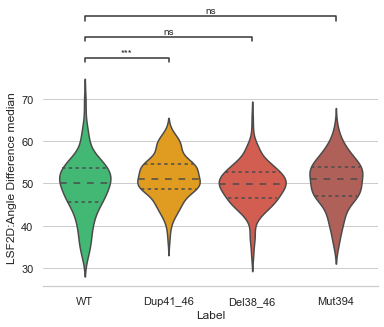

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.934e-02 stat=-1.973e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.261e-07 stat=-5.148e+00
WT v.s. Mut394: t-test independent samples, P_val=6.818e-01 stat=4.104e-01
o


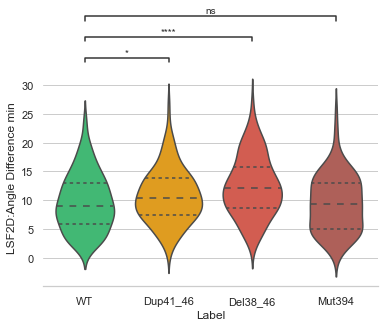

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.816e-01 stat=-1.491e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.607e-09 stat=6.188e+00
WT v.s. Mut394: t-test independent samples, P_val=1.040e-01 stat=-1.631e+00
o


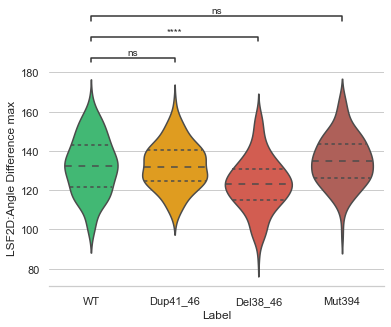

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.109e-01 stat=1.599e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.342e-11 stat=6.982e+00
WT v.s. Mut394: t-test independent samples, P_val=4.226e-01 stat=-8.031e-01
o


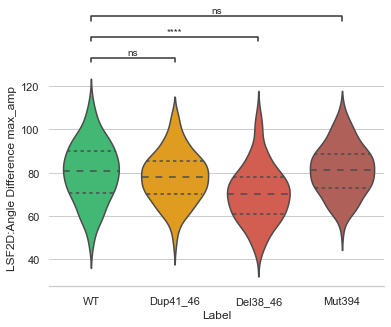

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.619e-02 stat=2.417e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.290e-06 stat=4.723e+00
WT v.s. Mut394: t-test independent samples, P_val=7.551e-01 stat=-3.122e-01
o


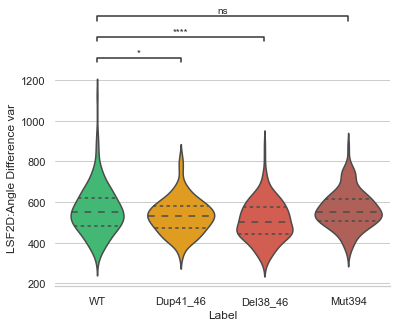

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.307e-02 stat=2.283e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.044e-06 stat=4.740e+00
WT v.s. Mut394: t-test independent samples, P_val=6.193e-01 stat=-4.974e-01
o


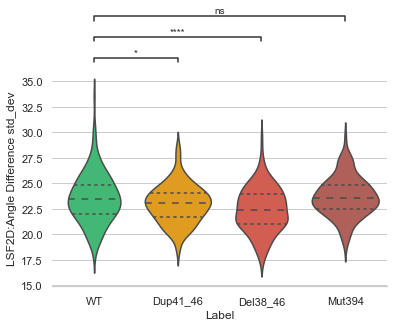

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.057e-02 stat=2.172e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.719e-05 stat=4.355e+00
WT v.s. Mut394: t-test independent samples, P_val=4.926e-01 stat=-6.870e-01
o


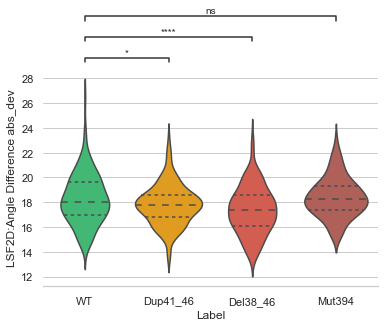

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.443e-01 stat=7.659e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.733e-01 stat=1.364e+00
WT v.s. Mut394: t-test independent samples, P_val=8.931e-02 stat=1.705e+00
o


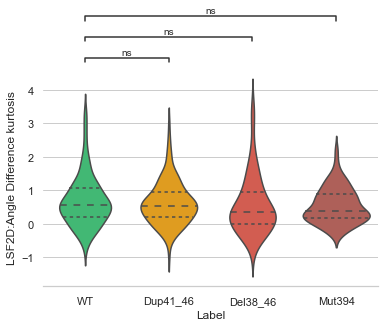

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.290e-01 stat=7.919e-01
WT v.s. Del38_46: t-test independent samples, P_val=2.874e-01 stat=1.065e+00
WT v.s. Mut394: t-test independent samples, P_val=2.790e-01 stat=1.084e+00
o


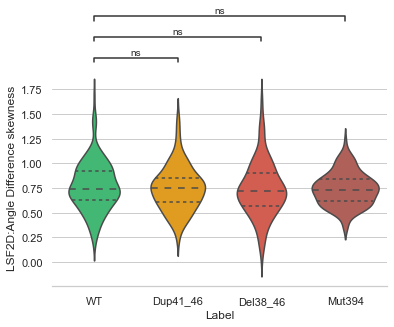

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.664e-03 stat=-2.683e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.947e-01 stat=2.604e-01
WT v.s. Mut394: t-test independent samples, P_val=9.695e-02 stat=-1.665e+00
o


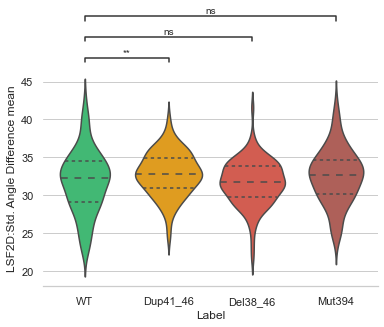

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.066e-03 stat=-2.625e+00
WT v.s. Del38_46: t-test independent samples, P_val=9.022e-01 stat=-1.230e-01
WT v.s. Mut394: t-test independent samples, P_val=1.455e-01 stat=-1.460e+00
o


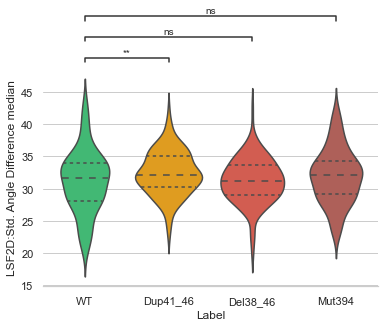

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.745e-03 stat=-3.156e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.107e-05 stat=-4.456e+00
WT v.s. Mut394: t-test independent samples, P_val=7.350e-01 stat=3.387e-01
o


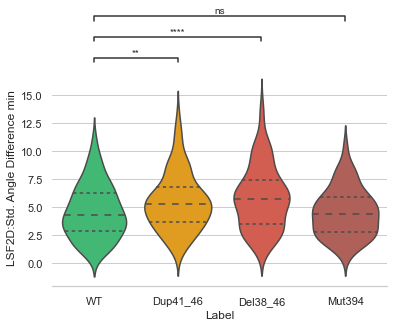

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.476e-01 stat=-6.578e-02
WT v.s. Del38_46: t-test independent samples, P_val=6.644e-08 stat=5.512e+00
WT v.s. Mut394: t-test independent samples, P_val=1.715e-01 stat=-1.371e+00
o


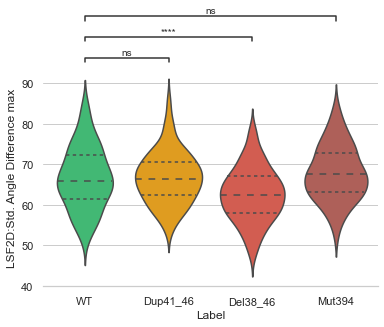

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.791e-02 stat=1.832e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.221e-10 stat=6.525e+00
WT v.s. Mut394: t-test independent samples, P_val=8.067e-01 stat=-2.449e-01
o


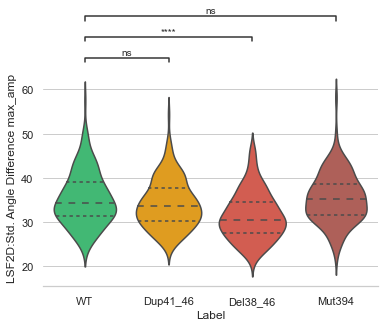

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.198e-03 stat=2.883e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.220e-09 stat=5.949e+00
WT v.s. Mut394: t-test independent samples, P_val=6.432e-01 stat=-4.637e-01
o


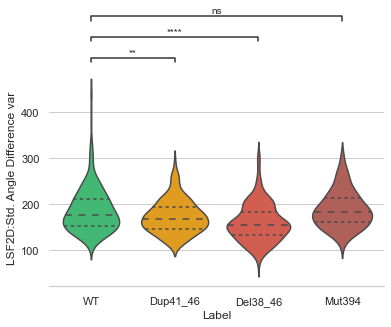

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.657e-03 stat=2.849e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.475e-09 stat=6.203e+00
WT v.s. Mut394: t-test independent samples, P_val=5.465e-01 stat=-6.038e-01
o


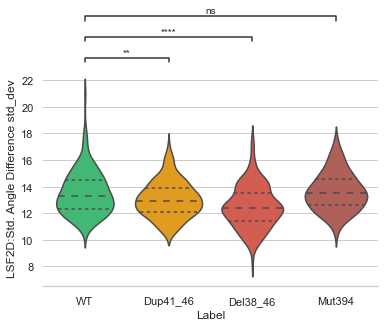

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.287e-03 stat=2.700e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.314e-08 stat=5.814e+00
WT v.s. Mut394: t-test independent samples, P_val=3.524e-01 stat=-9.314e-01
o


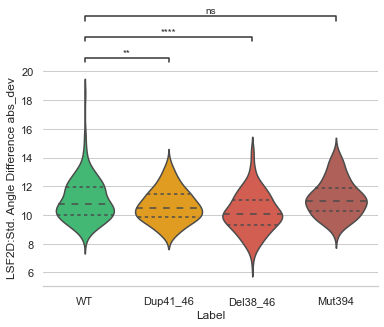

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.562e-01 stat=4.456e-01
WT v.s. Del38_46: t-test independent samples, P_val=9.880e-01 stat=-1.505e-02
WT v.s. Mut394: t-test independent samples, P_val=1.486e-01 stat=1.448e+00
o


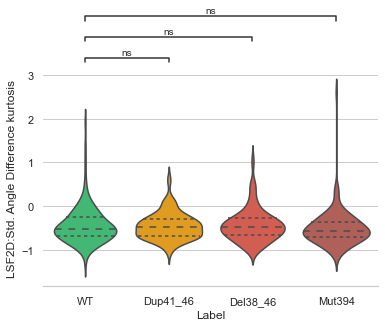

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.071e-01 stat=1.616e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.250e-02 stat=1.801e+00
WT v.s. Mut394: t-test independent samples, P_val=9.354e-02 stat=1.682e+00
o


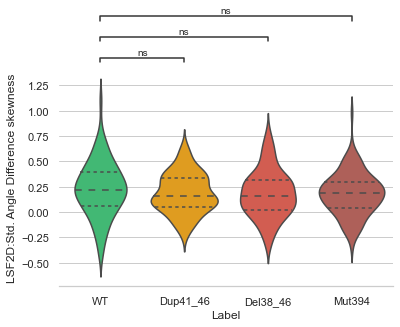

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.292e-13 stat=7.591e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.576e-03 stat=3.184e+00
WT v.s. Mut394: t-test independent samples, P_val=6.841e-04 stat=3.432e+00
o


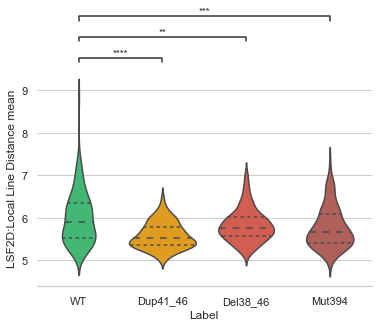

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.696e-14 stat=7.965e+00
WT v.s. Del38_46: t-test independent samples, P_val=8.122e-05 stat=3.985e+00
WT v.s. Mut394: t-test independent samples, P_val=3.291e-04 stat=3.633e+00
o


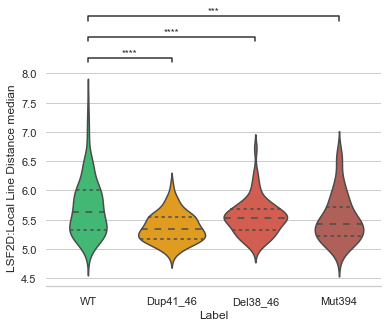

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.580e-08 stat=5.644e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.430e-01 stat=1.169e+00
WT v.s. Mut394: t-test independent samples, P_val=6.574e-04 stat=3.443e+00
o


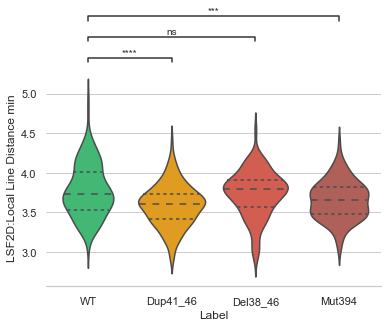

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.606e-01 stat=1.406e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.487e-01 stat=1.447e+00
WT v.s. Mut394: t-test independent samples, P_val=1.119e-01 stat=-1.594e+00
o


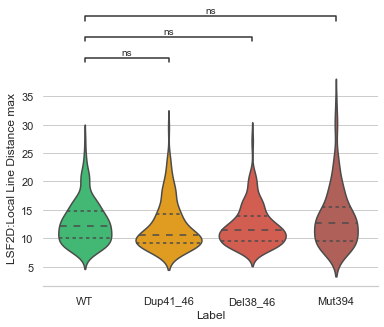

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.012e-01 stat=5.232e-01
WT v.s. Del38_46: t-test independent samples, P_val=2.681e-01 stat=1.109e+00
WT v.s. Mut394: t-test independent samples, P_val=3.056e-02 stat=-2.173e+00
o


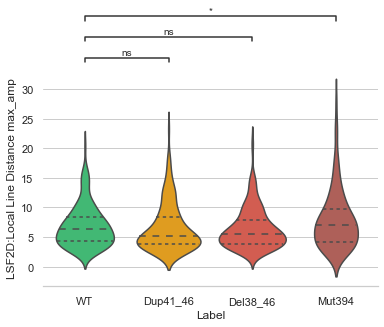

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.008e-03 stat=2.898e+00
WT v.s. Del38_46: t-test independent samples, P_val=9.744e-01 stat=3.206e-02
WT v.s. Mut394: t-test independent samples, P_val=4.266e-01 stat=7.961e-01
o


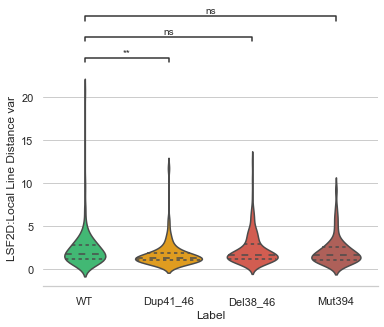

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.227e-04 stat=3.635e+00
WT v.s. Del38_46: t-test independent samples, P_val=9.501e-01 stat=-6.264e-02
WT v.s. Mut394: t-test independent samples, P_val=3.609e-01 stat=9.151e-01
o


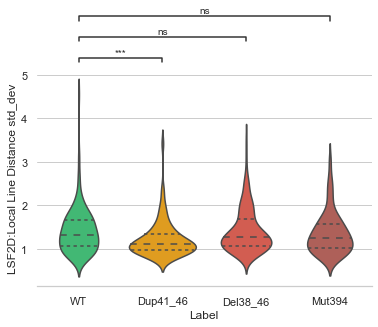

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.934e-08 stat=5.626e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.699e-01 stat=1.105e+00
WT v.s. Mut394: t-test independent samples, P_val=7.790e-03 stat=2.679e+00
o


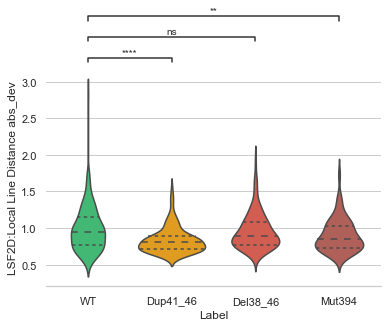

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.363e-02 stat=-2.480e+00
WT v.s. Del38_46: t-test independent samples, P_val=9.306e-01 stat=-8.719e-02
WT v.s. Mut394: t-test independent samples, P_val=6.237e-04 stat=-3.458e+00
o


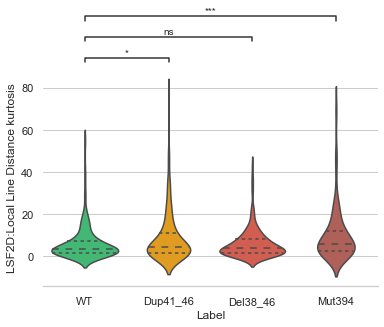

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.920e-02 stat=-1.761e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.470e-01 stat=-9.417e-01
WT v.s. Mut394: t-test independent samples, P_val=1.099e-03 stat=-3.296e+00
o


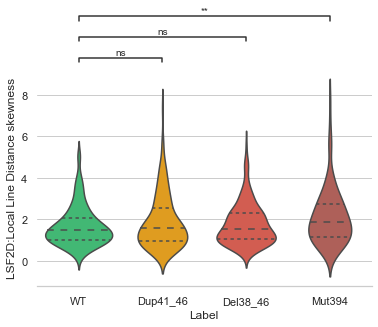

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.212e-14 stat=7.868e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.165e-02 stat=2.157e+00
WT v.s. Mut394: t-test independent samples, P_val=1.566e-03 stat=3.191e+00
o


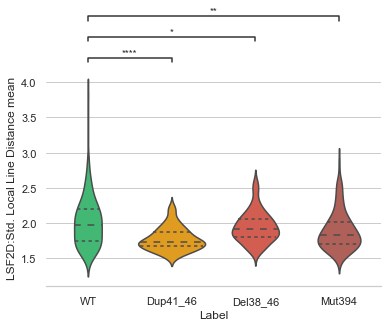

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.453e-14 stat=8.056e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.568e-02 stat=2.427e+00
WT v.s. Mut394: t-test independent samples, P_val=1.133e-03 stat=3.287e+00
o


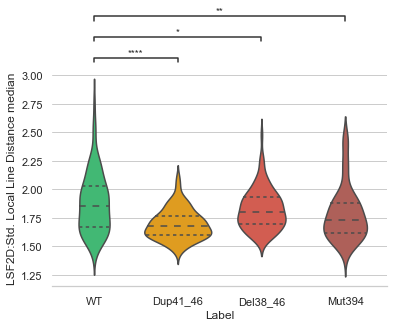

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.102e-03 stat=3.292e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.460e-01 stat=-1.162e+00
WT v.s. Mut394: t-test independent samples, P_val=1.365e-02 stat=2.481e+00
o


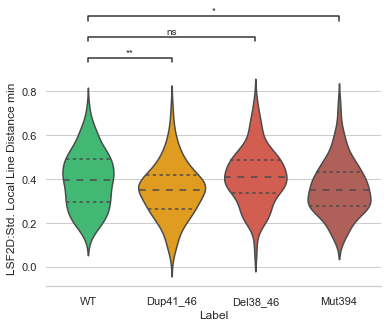

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.408e-03 stat=2.651e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.263e-02 stat=2.034e+00
WT v.s. Mut394: t-test independent samples, P_val=4.171e-01 stat=-8.126e-01
o


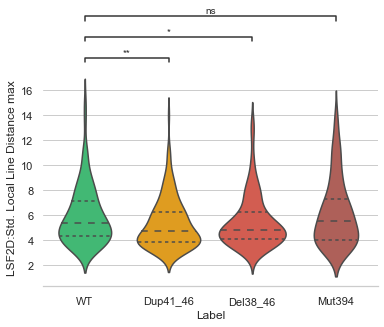

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.275e-02 stat=1.800e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.553e-02 stat=1.921e+00
WT v.s. Mut394: t-test independent samples, P_val=1.870e-01 stat=-1.322e+00
o


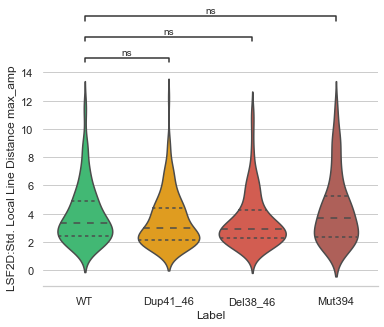

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.092e-04 stat=3.511e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.828e-01 stat=4.089e-01
WT v.s. Mut394: t-test independent samples, P_val=3.995e-01 stat=8.437e-01
o


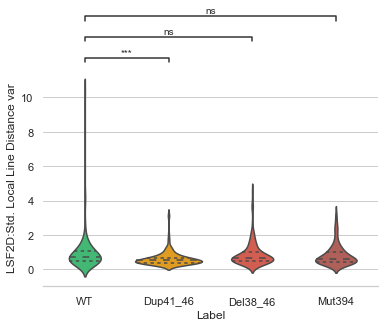

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.322e-05 stat=4.423e+00
WT v.s. Del38_46: t-test independent samples, P_val=8.289e-01 stat=2.162e-01
WT v.s. Mut394: t-test independent samples, P_val=3.927e-01 stat=8.559e-01
o


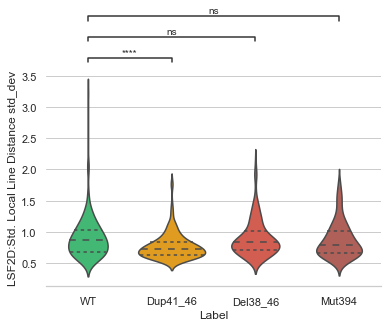

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.842e-08 stat=5.768e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.324e-01 stat=6.249e-01
WT v.s. Mut394: t-test independent samples, P_val=4.164e-02 stat=2.046e+00
o


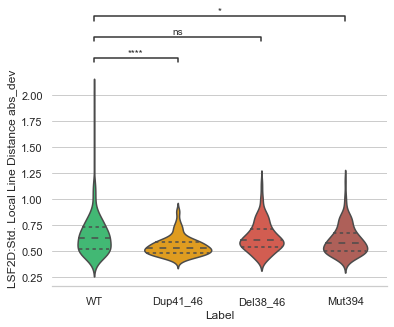

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.180e-01 stat=-1.234e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.788e-01 stat=1.085e+00
WT v.s. Mut394: t-test independent samples, P_val=2.477e-02 stat=-2.256e+00
o


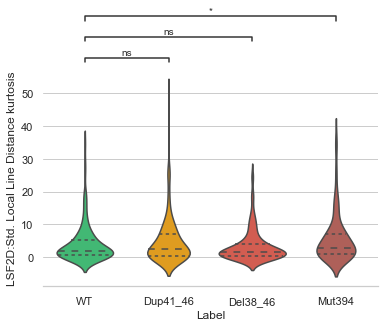

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.567e-01 stat=-4.449e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.710e-01 stat=4.251e-01
WT v.s. Mut394: t-test independent samples, P_val=3.148e-02 stat=-2.161e+00
o


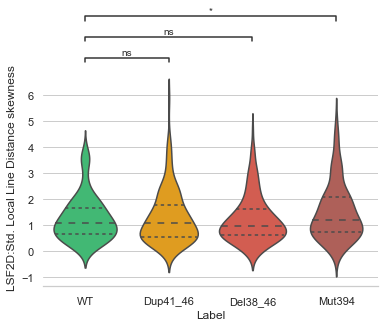

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.648e-01 stat=-5.762e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.151e-10 stat=6.634e+00
WT v.s. Mut394: t-test independent samples, P_val=1.669e-01 stat=-1.386e+00
o


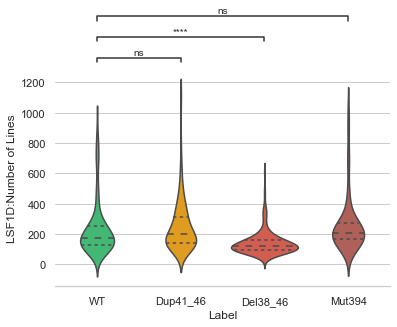

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.396e-01 stat=9.563e-01
WT v.s. Del38_46: t-test independent samples, P_val=9.427e-01 stat=-7.194e-02
WT v.s. Mut394: t-test independent samples, P_val=2.133e-01 stat=1.247e+00
o


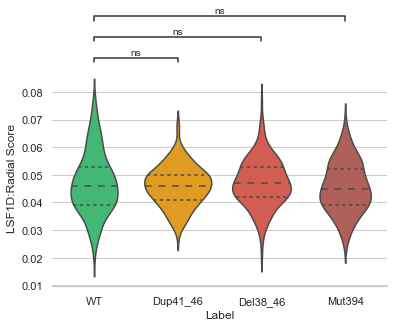

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.162e-11 stat=-6.872e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.327e-04 stat=3.446e+00
WT v.s. Mut394: t-test independent samples, P_val=1.812e-05 stat=-4.357e+00
o


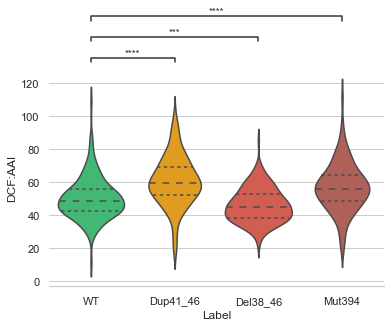

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.744e-04 stat=-3.359e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.174e-02 stat=2.532e+00
WT v.s. Mut394: t-test independent samples, P_val=2.752e-03 stat=-3.019e+00
o


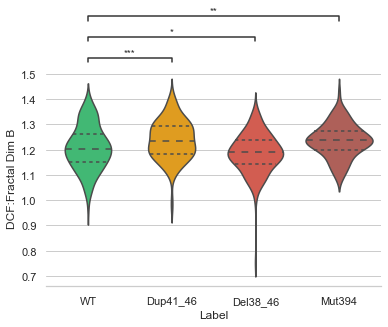

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.225e-05 stat=-4.020e+00
WT v.s. Del38_46: t-test independent samples, P_val=9.192e-04 stat=-3.341e+00
WT v.s. Mut394: t-test independent samples, P_val=3.688e-03 stat=-2.927e+00
o


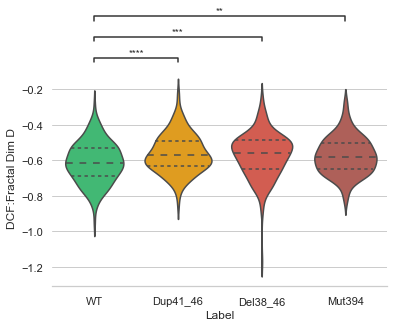

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.224e-02 stat=1.803e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.818e-11 stat=6.746e+00
WT v.s. Mut394: t-test independent samples, P_val=8.708e-01 stat=-1.627e-01
o


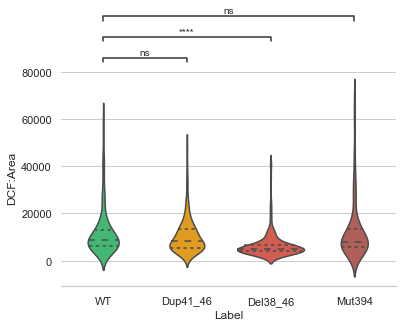

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.574e-01 stat=9.216e-01
WT v.s. Del38_46: t-test independent samples, P_val=3.209e-11 stat=6.842e+00
WT v.s. Mut394: t-test independent samples, P_val=4.267e-01 stat=-7.960e-01
o


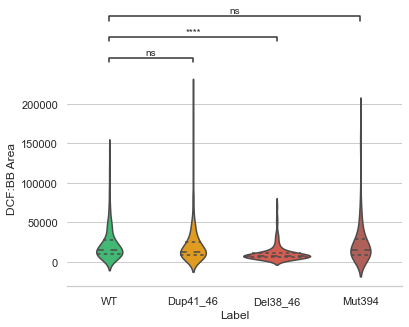

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.408e-02 stat=1.933e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.191e-10 stat=6.628e+00
WT v.s. Mut394: t-test independent samples, P_val=3.753e-01 stat=8.878e-01
o


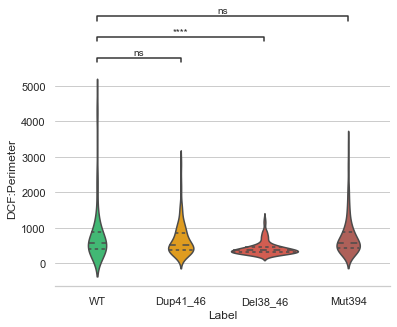

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.605e-01 stat=-1.127e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.919e-07 stat=5.165e+00
WT v.s. Mut394: t-test independent samples, P_val=6.770e-02 stat=-1.834e+00
o


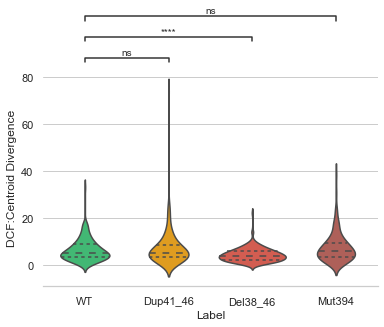

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.876e-02 stat=1.763e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.752e-15 stat=8.250e+00
WT v.s. Mut394: t-test independent samples, P_val=8.668e-01 stat=1.679e-01
o


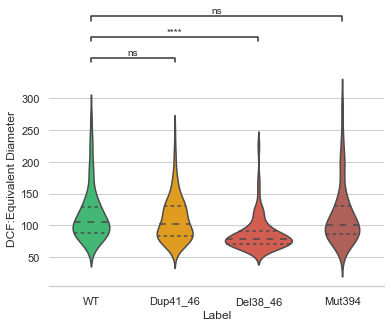

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.828e-02 stat=1.766e+00
WT v.s. Del38_46: t-test independent samples, P_val=8.069e-13 stat=7.418e+00
WT v.s. Mut394: t-test independent samples, P_val=9.693e-01 stat=-3.855e-02
o


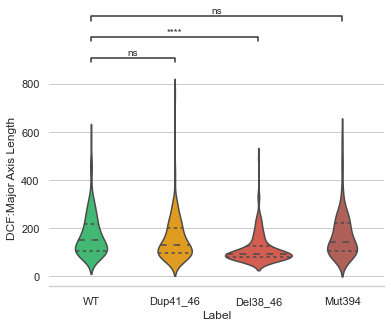

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.032e-01 stat=8.369e-01
WT v.s. Del38_46: t-test independent samples, P_val=4.688e-09 stat=5.999e+00
WT v.s. Mut394: t-test independent samples, P_val=8.421e-01 stat=1.994e-01
o


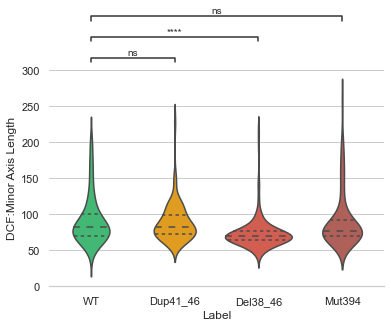

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.688e-02 stat=1.995e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.526e-06 stat=4.887e+00
WT v.s. Mut394: t-test independent samples, P_val=3.417e-01 stat=-9.523e-01
o


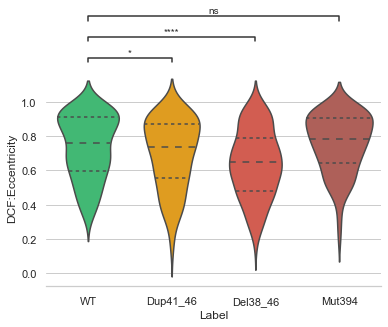

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.845e-01 stat=1.330e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.498e-03 stat=-2.793e+00
WT v.s. Mut394: t-test independent samples, P_val=1.410e-03 stat=3.223e+00
o


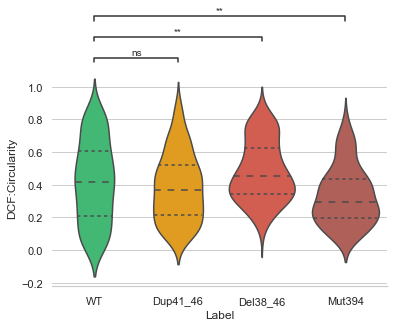

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.571e-02 stat=-1.920e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.957e-06 stat=-4.683e+00
WT v.s. Mut394: t-test independent samples, P_val=3.521e-01 stat=9.320e-01
o


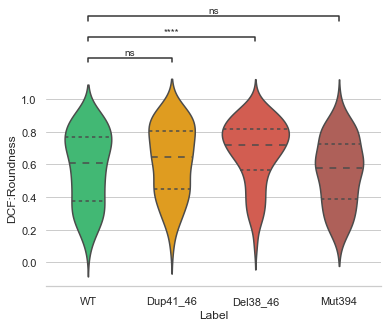

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.497e-02 stat=-2.117e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.944e-01 stat=-3.932e-01
WT v.s. Mut394: t-test independent samples, P_val=3.123e-01 stat=-1.012e+00
o


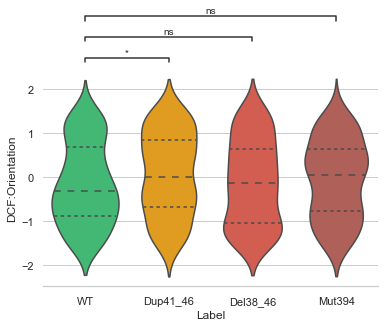

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.156e-03 stat=3.278e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.755e-01 stat=-8.872e-01
WT v.s. Mut394: t-test independent samples, P_val=1.650e-04 stat=3.816e+00
o


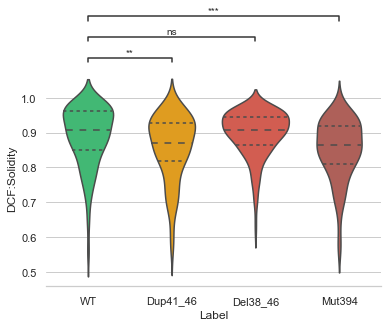

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.905e-02 stat=1.894e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.903e-06 stat=4.596e+00
WT v.s. Mut394: t-test independent samples, P_val=2.272e-01 stat=1.210e+00
o


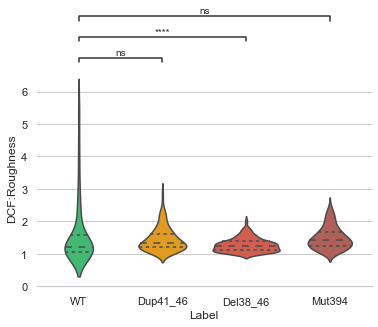

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.380e-11 stat=-6.918e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.119e-03 stat=3.284e+00
WT v.s. Mut394: t-test independent samples, P_val=1.165e-05 stat=-4.459e+00
o


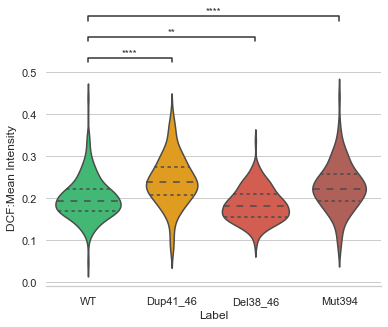

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.848e-10 stat=-6.580e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.015e-04 stat=3.754e+00
WT v.s. Mut394: t-test independent samples, P_val=1.821e-04 stat=-3.790e+00
o


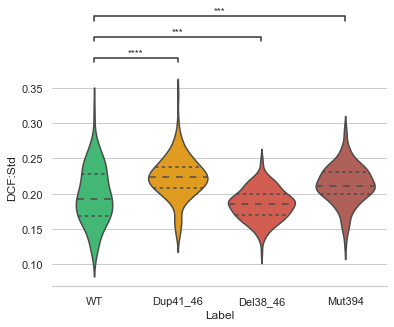

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.716e-09 stat=-6.116e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.062e-05 stat=4.465e+00
WT v.s. Mut394: t-test independent samples, P_val=1.117e-03 stat=-3.291e+00
o


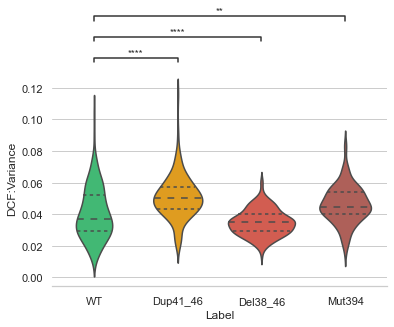

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.145e-04 stat=3.458e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.426e-07 stat=-5.261e+00
WT v.s. Mut394: t-test independent samples, P_val=1.293e-01 stat=1.521e+00
o


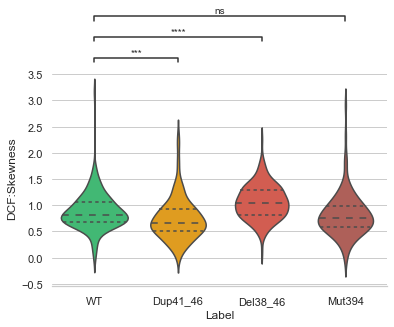

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.198e-02 stat=2.527e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.648e-06 stat=-4.870e+00
WT v.s. Mut394: t-test independent samples, P_val=3.108e-01 stat=1.015e+00
o


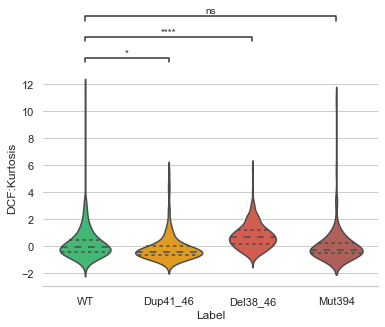

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan
o


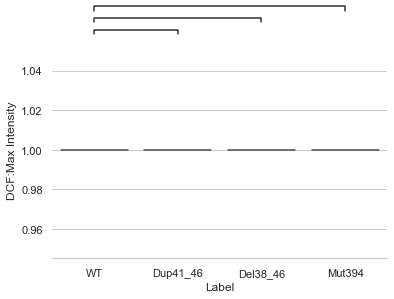

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.758e-09 stat=6.193e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.942e-06 stat=4.684e+00
WT v.s. Mut394: t-test independent samples, P_val=1.660e-08 stat=5.803e+00
o


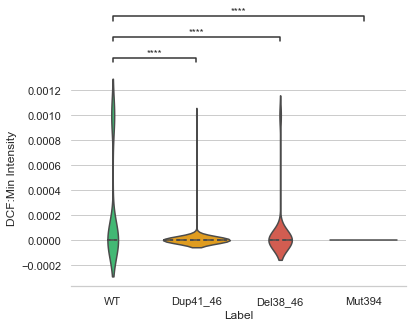

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.684e-02 stat=-1.911e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.732e-06 stat=-4.536e+00
WT v.s. Mut394: t-test independent samples, P_val=5.742e-01 stat=-5.625e-01
o


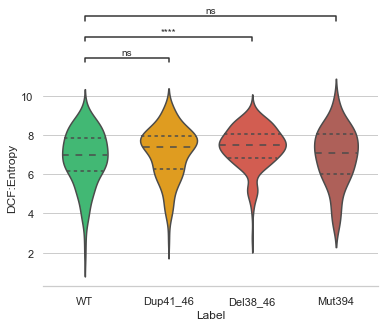

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.314e-01 stat=9.726e-01
WT v.s. Del38_46: t-test independent samples, P_val=3.861e-11 stat=6.812e+00
WT v.s. Mut394: t-test independent samples, P_val=4.241e-01 stat=8.005e-01
o


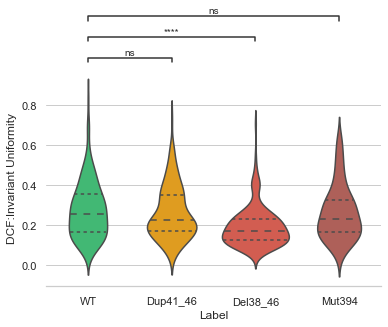

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.067e-01 stat=-1.265e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.058e-17 stat=9.013e+00
WT v.s. Mut394: t-test independent samples, P_val=1.503e-01 stat=-1.442e+00
o


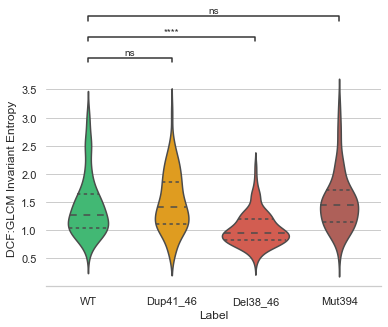

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.925e-09 stat=5.976e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.215e-22 stat=1.039e+01
WT v.s. Mut394: t-test independent samples, P_val=1.605e-08 stat=5.809e+00
o


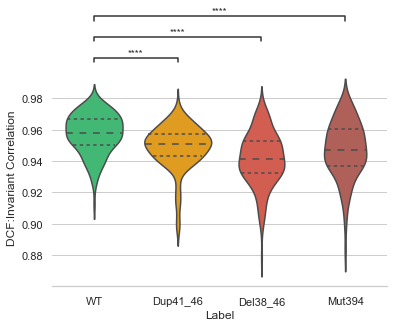

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.831e-10 stat=-6.508e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.299e-06 stat=-4.800e+00
WT v.s. Mut394: t-test independent samples, P_val=7.912e-06 stat=-4.547e+00
o


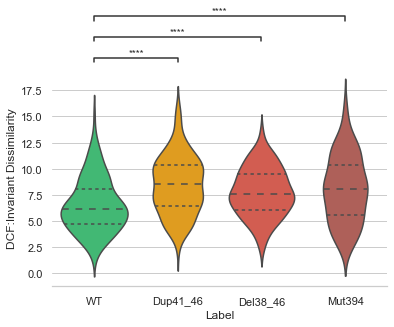

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.270e-13 stat=-7.647e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.594e-04 stat=-3.815e+00
WT v.s. Mut394: t-test independent samples, P_val=6.766e-08 stat=-5.536e+00
o


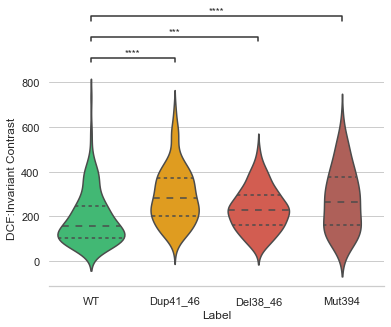

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.130e-01 stat=1.589e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.438e-10 stat=6.409e+00
WT v.s. Mut394: t-test independent samples, P_val=2.435e-01 stat=1.169e+00
o


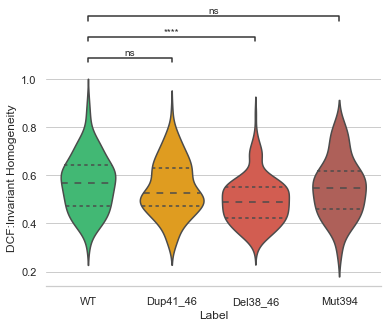

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.588e-01 stat=9.190e-01
WT v.s. Del38_46: t-test independent samples, P_val=2.723e-11 stat=6.869e+00
WT v.s. Mut394: t-test independent samples, P_val=4.078e-01 stat=8.290e-01
o


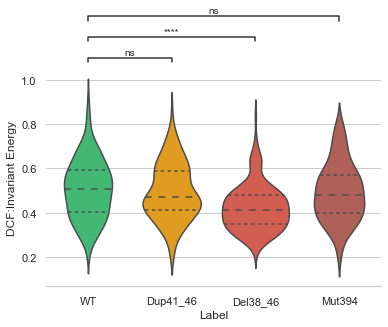

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.736e-05 stat=-4.254e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.770e-21 stat=-1.008e+01
WT v.s. Mut394: t-test independent samples, P_val=3.855e-04 stat=-3.591e+00
o


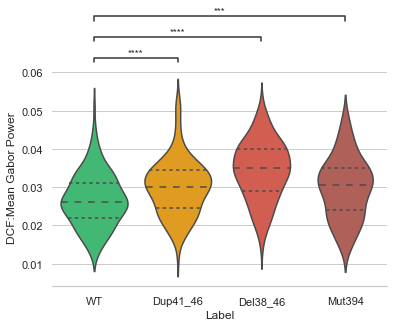

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan
o


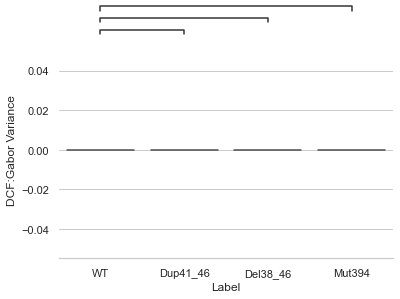

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan
o


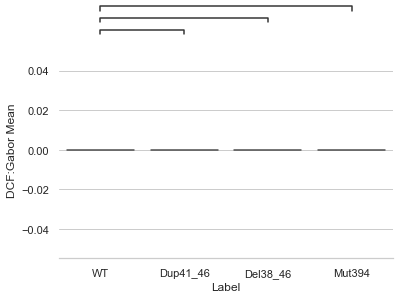

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan
o


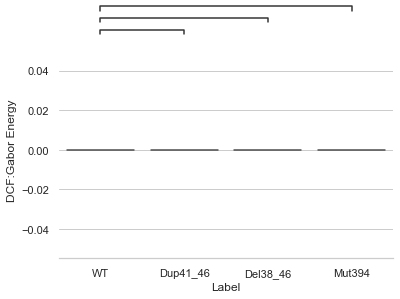

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.251e-01 stat=9.404e-02
WT v.s. Del38_46: t-test independent samples, P_val=1.602e-01 stat=-1.407e+00
WT v.s. Mut394: t-test independent samples, P_val=2.084e-01 stat=1.261e+00
o


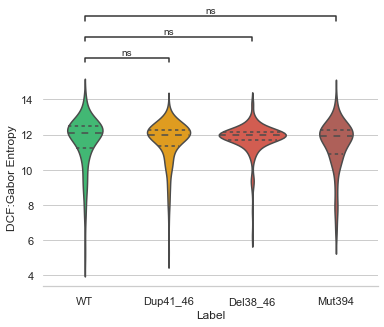

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.444e-18 stat=-9.343e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.386e-02 stat=1.934e+00
WT v.s. Mut394: t-test independent samples, P_val=1.588e-17 stat=-9.073e+00
o


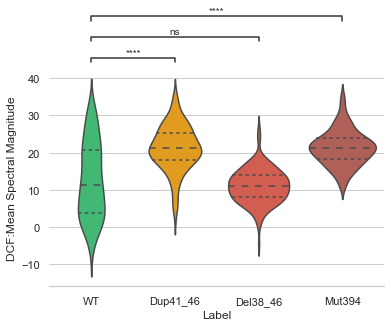

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.676e-06 stat=-4.577e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.722e-17 stat=-8.887e+00
WT v.s. Mut394: t-test independent samples, P_val=4.699e-03 stat=-2.848e+00
o


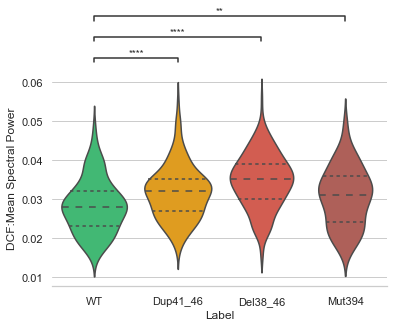

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.502e-01 stat=9.356e-01
WT v.s. Del38_46: t-test independent samples, P_val=2.908e-01 stat=1.058e+00
WT v.s. Mut394: t-test independent samples, P_val=6.888e-03 stat=-2.721e+00
o


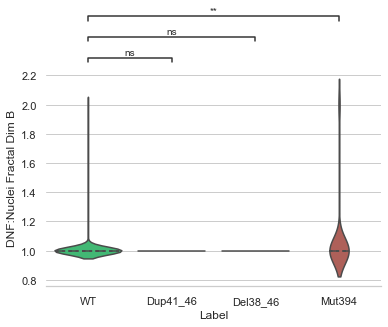

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.142e-03 stat=-3.282e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.700e-02 stat=2.093e+00
WT v.s. Mut394: t-test independent samples, P_val=4.294e-01 stat=-7.912e-01
o


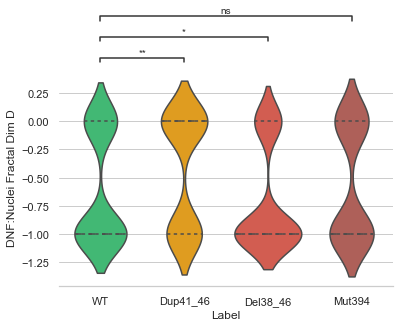

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.394e-01 stat=-2.028e-01
WT v.s. Del38_46: t-test independent samples, P_val=8.652e-07 stat=5.004e+00
WT v.s. Mut394: t-test independent samples, P_val=1.005e-01 stat=-1.648e+00
o


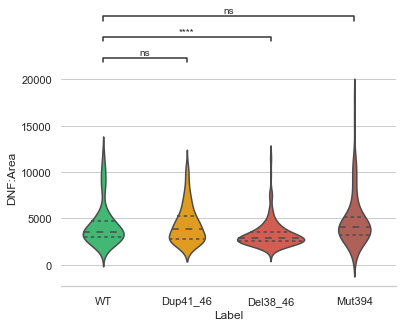

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.013e-01 stat=-3.840e-01
WT v.s. Del38_46: t-test independent samples, P_val=2.880e-06 stat=4.752e+00
WT v.s. Mut394: t-test independent samples, P_val=9.460e-02 stat=-1.677e+00
o


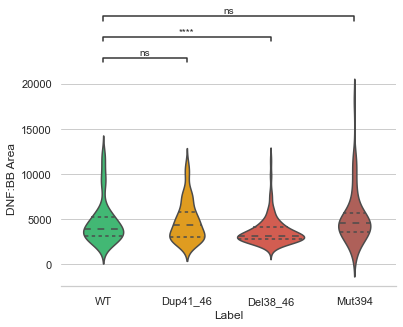

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.848e-01 stat=2.733e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.093e-08 stat=5.847e+00
WT v.s. Mut394: t-test independent samples, P_val=8.684e-01 stat=1.658e-01
o


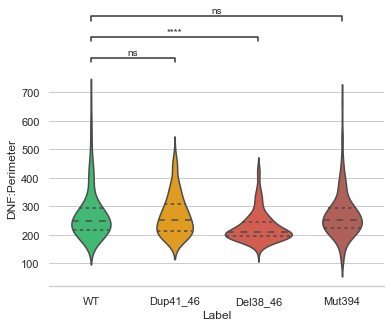

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.558e-02 stat=-1.671e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.038e-02 stat=2.329e+00
WT v.s. Mut394: t-test independent samples, P_val=2.582e-02 stat=-2.240e+00
o


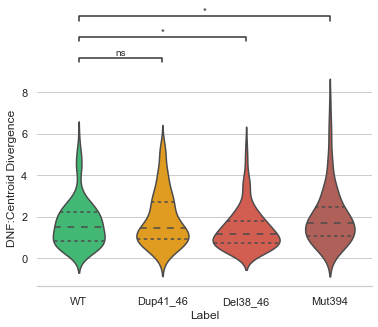

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.226e-01 stat=-3.552e-01
WT v.s. Del38_46: t-test independent samples, P_val=2.247e-07 stat=5.276e+00
WT v.s. Mut394: t-test independent samples, P_val=1.132e-01 stat=-1.589e+00
o


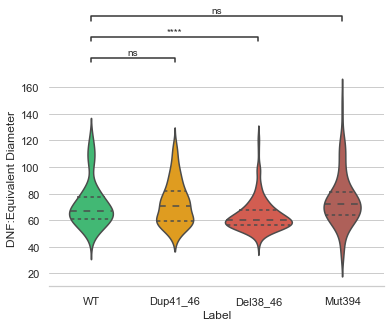

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.110e-01 stat=1.119e-01
WT v.s. Del38_46: t-test independent samples, P_val=3.761e-08 stat=5.619e+00
WT v.s. Mut394: t-test independent samples, P_val=3.197e-01 stat=-9.968e-01
o


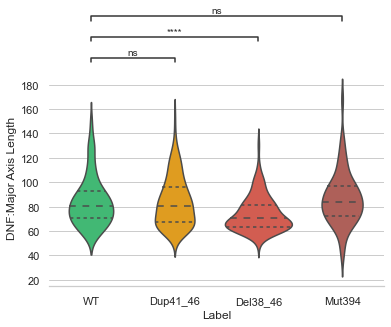

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.356e-01 stat=-6.201e-01
WT v.s. Del38_46: t-test independent samples, P_val=7.042e-06 stat=4.557e+00
WT v.s. Mut394: t-test independent samples, P_val=6.733e-02 stat=-1.836e+00
o


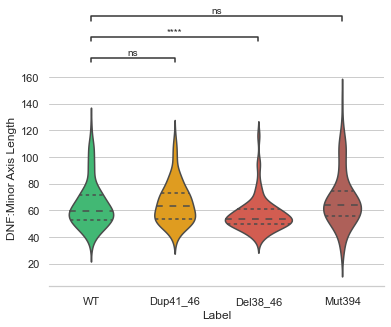

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.013e-01 stat=1.035e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.205e-01 stat=3.581e-01
WT v.s. Mut394: t-test independent samples, P_val=2.687e-01 stat=1.108e+00
o


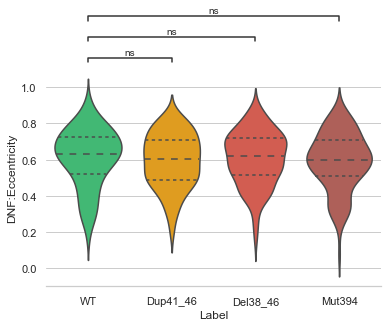

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.942e-01 stat=-8.531e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.363e-07 stat=-5.373e+00
WT v.s. Mut394: t-test independent samples, P_val=3.476e-05 stat=-4.203e+00
o


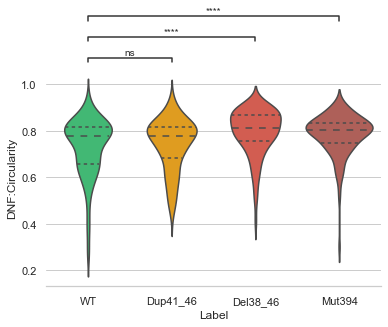

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.365e-01 stat=-1.493e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.812e-01 stat=-1.079e+00
WT v.s. Mut394: t-test independent samples, P_val=1.607e-01 stat=-1.406e+00
o


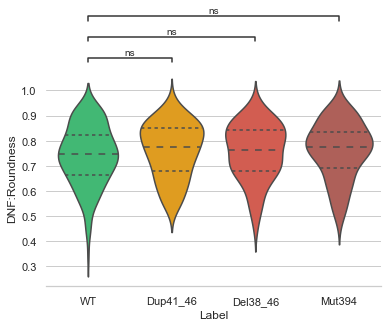

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.825e-02 stat=-2.203e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.928e-01 stat=-2.628e-01
WT v.s. Mut394: t-test independent samples, P_val=3.394e-02 stat=-2.131e+00
o


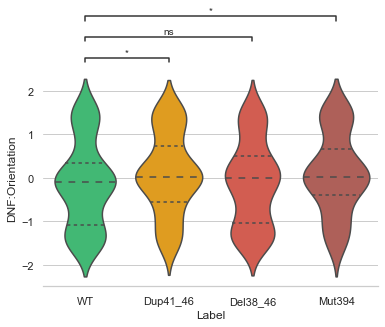

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.439e-01 stat=9.479e-01
WT v.s. Del38_46: t-test independent samples, P_val=3.778e-01 stat=-8.830e-01
WT v.s. Mut394: t-test independent samples, P_val=2.089e-03 stat=-3.104e+00
o


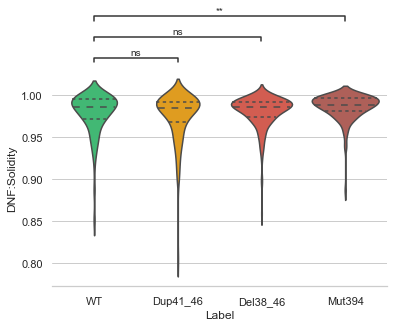

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.247e-01 stat=7.993e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.146e-04 stat=3.455e+00
WT v.s. Mut394: t-test independent samples, P_val=1.734e-03 stat=3.161e+00
o


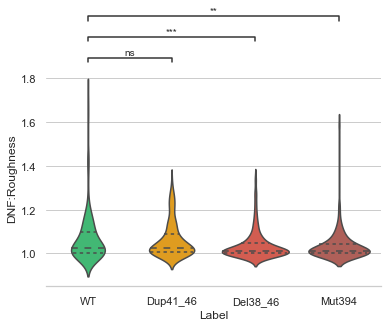

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.142e-09 stat=-6.158e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.039e-11 stat=6.715e+00
WT v.s. Mut394: t-test independent samples, P_val=3.268e-01 stat=-9.822e-01
o


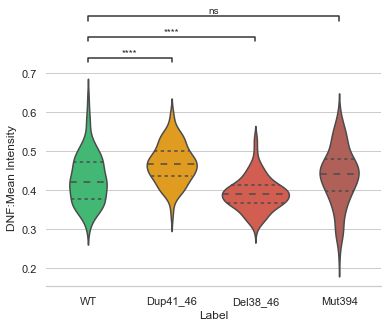

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.072e-10 stat=-6.408e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.601e-15 stat=8.149e+00
WT v.s. Mut394: t-test independent samples, P_val=8.145e-01 stat=2.348e-01
o


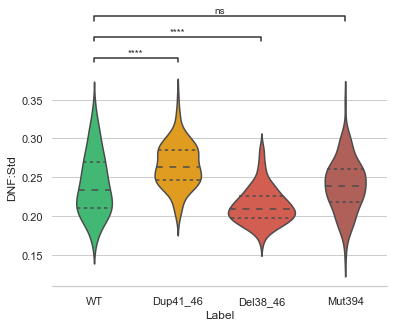

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.715e-09 stat=-5.953e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.853e-15 stat=8.202e+00
WT v.s. Mut394: t-test independent samples, P_val=6.583e-01 stat=4.428e-01
o


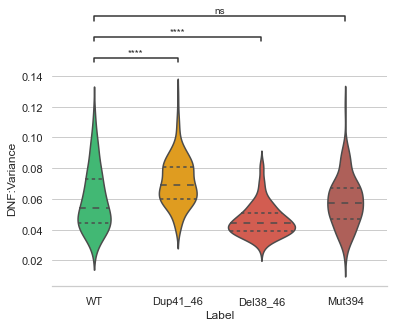

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.384e-01 stat=-1.485e+00
WT v.s. Del38_46: t-test independent samples, P_val=8.546e-22 stat=-1.022e+01
WT v.s. Mut394: t-test independent samples, P_val=1.101e-02 stat=-2.558e+00
o


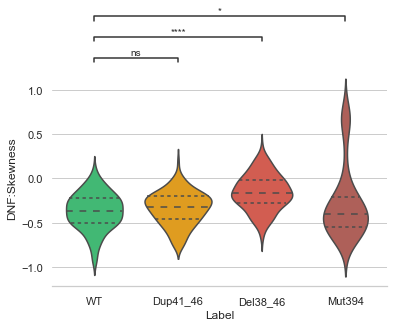

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.717e-06 stat=4.576e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.719e-09 stat=-6.176e+00
WT v.s. Mut394: t-test independent samples, P_val=2.358e-01 stat=-1.188e+00
o


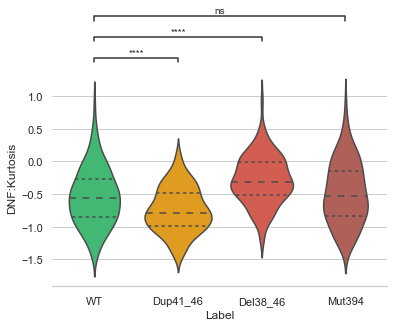

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan
o


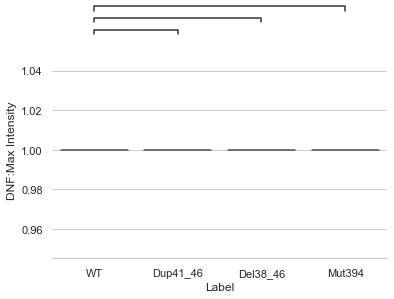

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.374e-01 stat=-4.718e-01
WT v.s. Del38_46: t-test independent samples, P_val=3.271e-01 stat=9.812e-01
WT v.s. Mut394: t-test independent samples, P_val=3.881e-02 stat=-2.075e+00
o


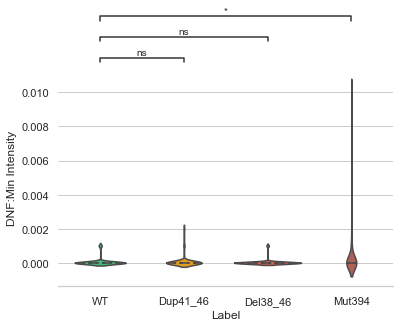

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.060e-02 stat=-2.570e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.472e-05 stat=4.130e+00
WT v.s. Mut394: t-test independent samples, P_val=2.641e-03 stat=-3.032e+00
o


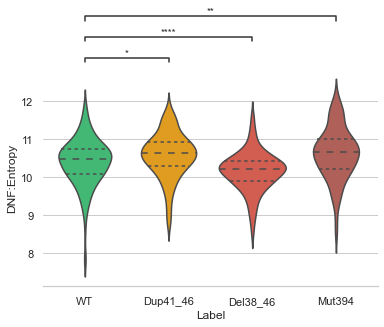

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.227e-01 stat=4.924e-01
WT v.s. Del38_46: t-test independent samples, P_val=5.616e-01 stat=5.810e-01
WT v.s. Mut394: t-test independent samples, P_val=4.082e-02 stat=2.054e+00
o


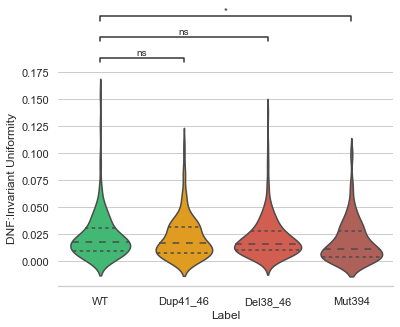

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.345e-02 stat=-2.027e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.555e-07 stat=5.135e+00
WT v.s. Mut394: t-test independent samples, P_val=7.021e-03 stat=-2.715e+00
o


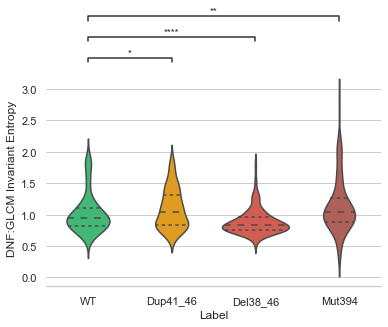

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.360e-07 stat=5.114e+00
WT v.s. Del38_46: t-test independent samples, P_val=8.369e-10 stat=6.300e+00
WT v.s. Mut394: t-test independent samples, P_val=2.551e-05 stat=4.277e+00
o


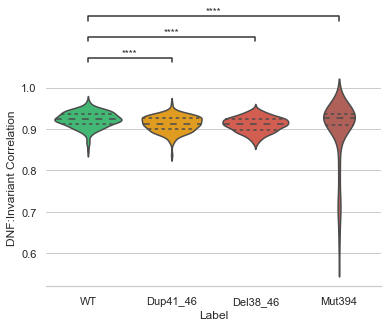

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.649e-23 stat=-1.060e+01
WT v.s. Del38_46: t-test independent samples, P_val=2.894e-01 stat=1.061e+00
WT v.s. Mut394: t-test independent samples, P_val=6.067e-05 stat=-4.068e+00
o


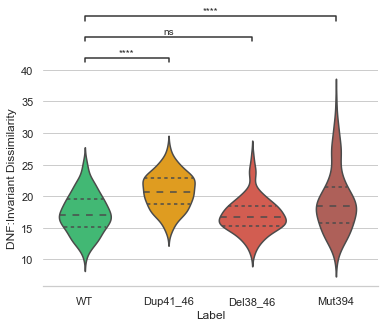

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.584e-26 stat=-1.147e+01
WT v.s. Del38_46: t-test independent samples, P_val=2.878e-01 stat=1.064e+00
WT v.s. Mut394: t-test independent samples, P_val=1.466e-05 stat=-4.406e+00
o


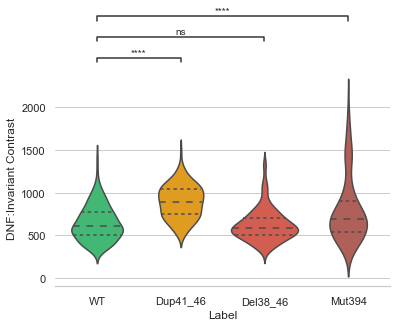

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.121e-01 stat=1.593e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.955e-01 stat=6.823e-01
WT v.s. Mut394: t-test independent samples, P_val=7.536e-04 stat=3.404e+00
o


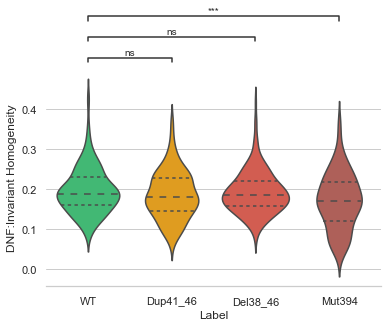

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.180e-01 stat=8.110e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.386e-01 stat=4.701e-01
WT v.s. Mut394: t-test independent samples, P_val=1.368e-03 stat=3.232e+00
o


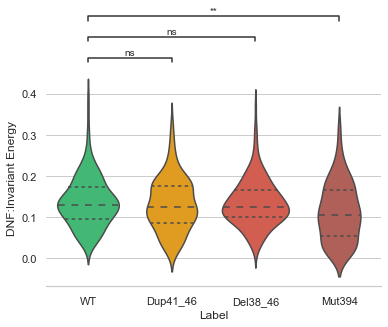

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.838e-01 stat=1.462e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.658e-13 stat=-7.656e+00
WT v.s. Mut394: t-test independent samples, P_val=2.325e-01 stat=-1.196e+00
o


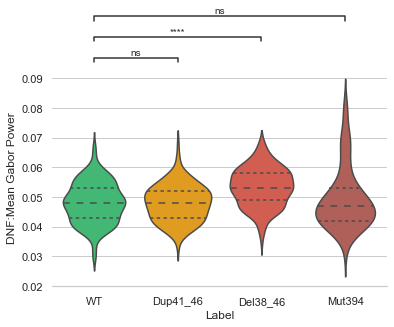

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan
o


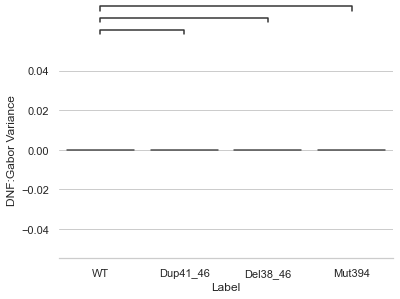

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.785e-05 stat=-4.354e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.427e-11 stat=6.887e+00
WT v.s. Mut394: t-test independent samples, P_val=1.003e-01 stat=-1.649e+00
o


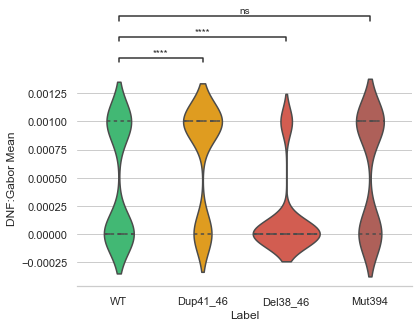

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan
o


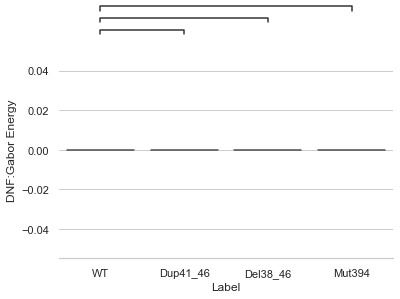

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.360e-01 stat=-4.738e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.219e-07 stat=5.072e+00
WT v.s. Mut394: t-test independent samples, P_val=2.099e-01 stat=-1.257e+00
o


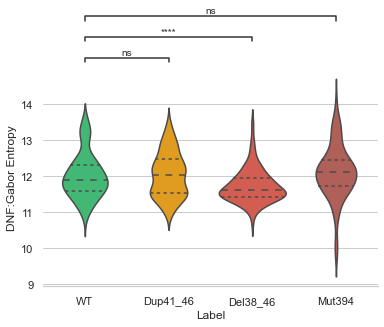

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.010e-37 stat=-1.442e+01
WT v.s. Del38_46: t-test independent samples, P_val=2.554e-06 stat=4.778e+00
WT v.s. Mut394: t-test independent samples, P_val=5.330e-07 stat=-5.126e+00
o


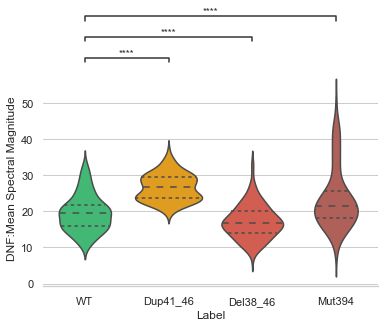

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.025e-11 stat=-6.880e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.132e-07 stat=-5.410e+00
WT v.s. Mut394: t-test independent samples, P_val=1.311e-06 stat=-4.939e+00
o


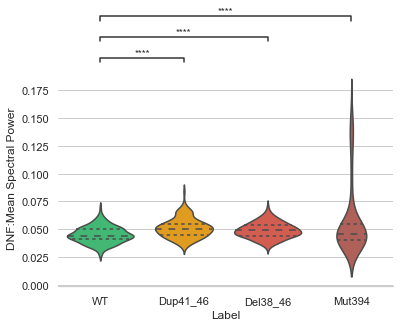

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.156e-01 stat=-1.578e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.970e-09 stat=5.956e+00
WT v.s. Mut394: t-test independent samples, P_val=3.296e-02 stat=-2.143e+00
o


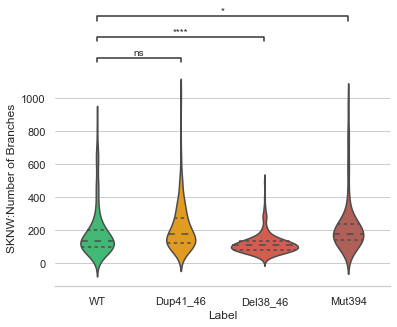

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.719e-16 stat=8.521e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.526e-14 stat=8.006e+00
WT v.s. Mut394: t-test independent samples, P_val=1.390e-13 stat=7.756e+00
o


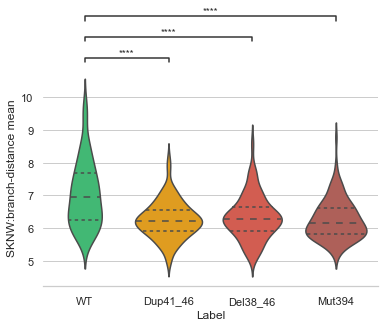

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.967e-10 stat=6.292e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.130e-09 stat=6.071e+00
WT v.s. Mut394: t-test independent samples, P_val=4.227e-12 stat=7.224e+00
o


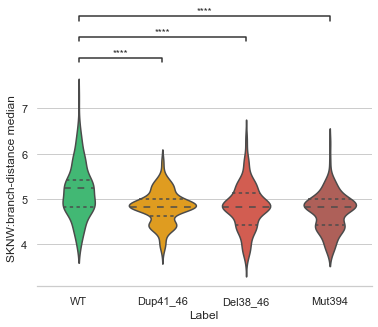

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.296e-01 stat=-6.293e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.558e-04 stat=-3.821e+00
WT v.s. Mut394: t-test independent samples, P_val=8.004e-01 stat=-2.530e-01
o


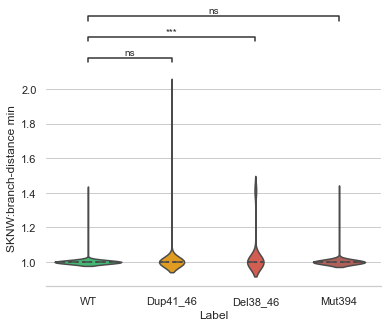

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.021e-03 stat=3.112e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.375e-11 stat=6.834e+00
WT v.s. Mut394: t-test independent samples, P_val=1.020e-03 stat=3.318e+00
o


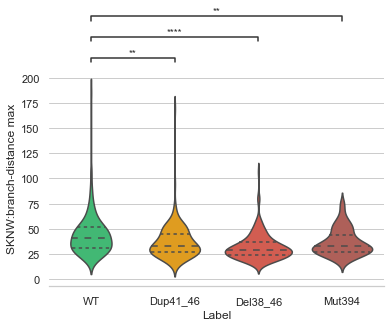

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.487e-03 stat=2.795e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.271e-10 stat=6.618e+00
WT v.s. Mut394: t-test independent samples, P_val=2.787e-03 stat=3.015e+00
o


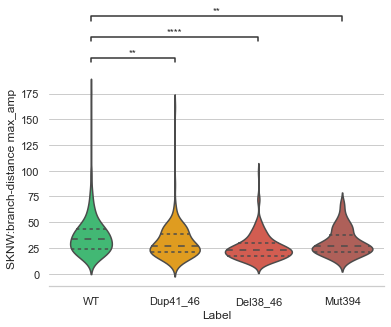

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.334e-08 stat=5.828e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.525e-09 stat=6.050e+00
WT v.s. Mut394: t-test independent samples, P_val=1.974e-06 stat=4.852e+00
o


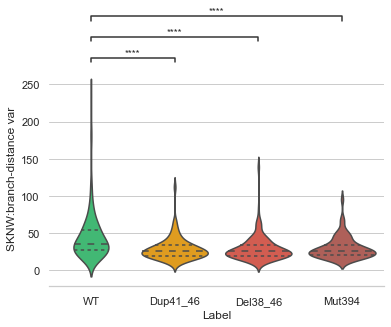

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.285e-10 stat=6.641e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.416e-11 stat=6.888e+00
WT v.s. Mut394: t-test independent samples, P_val=1.189e-07 stat=5.426e+00
o


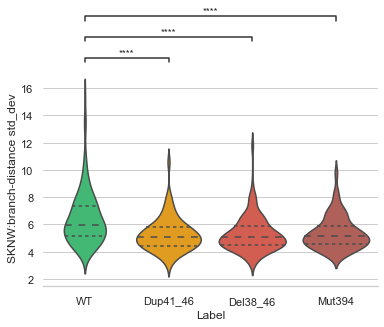

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.035e-14 stat=8.106e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.745e-13 stat=7.581e+00
WT v.s. Mut394: t-test independent samples, P_val=8.254e-10 stat=6.344e+00
o


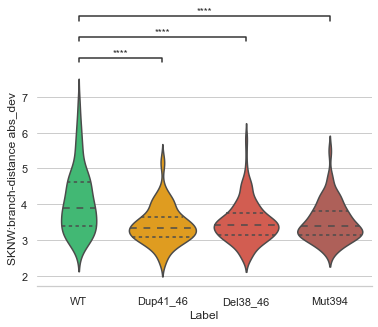

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.125e-01 stat=1.100e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.747e-04 stat=3.791e+00
WT v.s. Mut394: t-test independent samples, P_val=9.319e-02 stat=1.684e+00
o


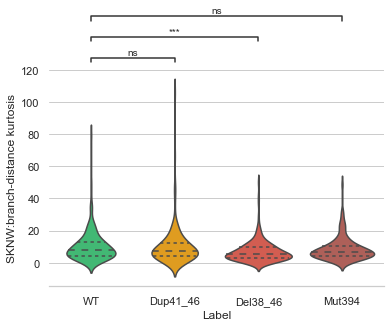

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.314e-01 stat=9.727e-01
WT v.s. Del38_46: t-test independent samples, P_val=4.184e-05 stat=4.146e+00
WT v.s. Mut394: t-test independent samples, P_val=5.025e-02 stat=1.966e+00
o


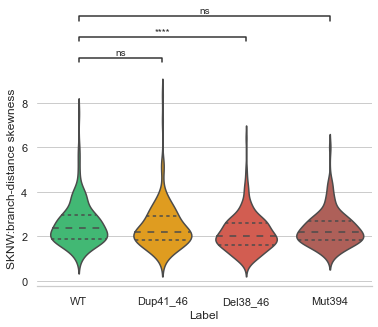

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.368e-08 stat=-5.722e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.125e-07 stat=5.210e+00
WT v.s. Mut394: t-test independent samples, P_val=9.017e-01 stat=1.236e-01
o


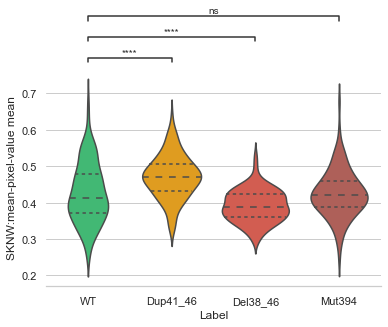

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.339e-08 stat=-5.568e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.480e-09 stat=5.972e+00
WT v.s. Mut394: t-test independent samples, P_val=8.237e-01 stat=2.230e-01
o


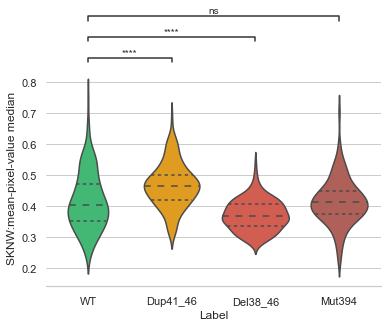

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.710e-01 stat=1.103e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.846e-01 stat=2.736e-01
WT v.s. Mut394: t-test independent samples, P_val=2.167e-05 stat=4.315e+00
o


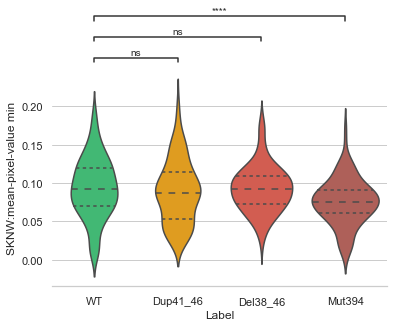

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.045e-07 stat=-5.307e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.168e-01 stat=1.572e+00
WT v.s. Mut394: t-test independent samples, P_val=4.958e-04 stat=-3.522e+00
o


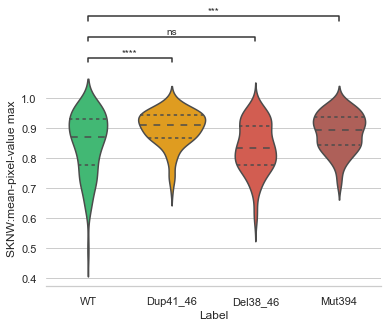

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.843e-02 stat=-1.709e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.987e-01 stat=-1.041e+00
WT v.s. Mut394: t-test independent samples, P_val=2.795e-05 stat=-4.255e+00
o


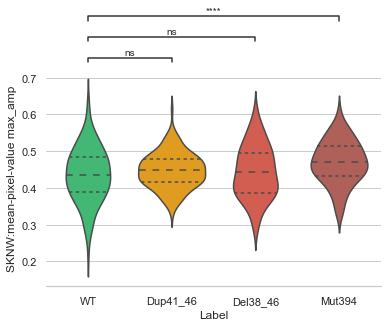

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.406e-04 stat=-3.370e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.785e-01 stat=-7.095e-01
WT v.s. Mut394: t-test independent samples, P_val=4.589e-04 stat=-3.543e+00
o


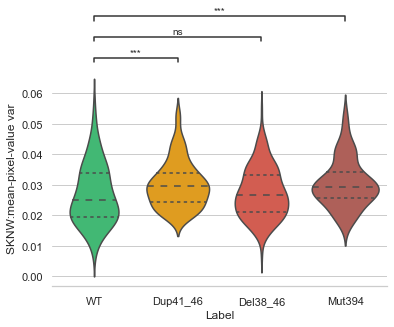

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.322e-04 stat=-3.868e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.194e-01 stat=-9.970e-01
WT v.s. Mut394: t-test independent samples, P_val=1.031e-04 stat=-3.936e+00
o


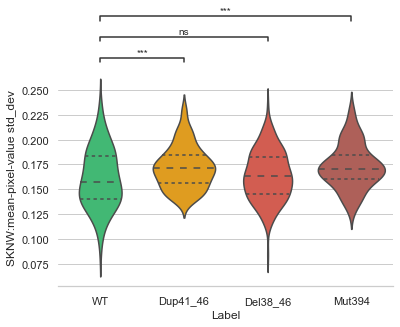

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.875e-05 stat=-4.243e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.713e-01 stat=-7.211e-01
WT v.s. Mut394: t-test independent samples, P_val=7.765e-05 stat=-4.007e+00
o


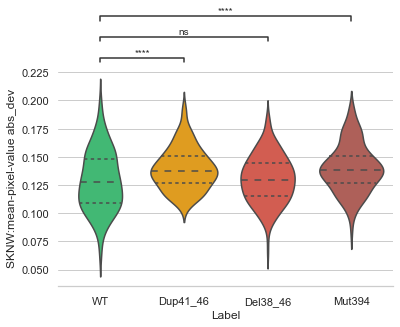

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.507e-04 stat=3.544e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.593e-01 stat=7.407e-01
WT v.s. Mut394: t-test independent samples, P_val=9.208e-02 stat=1.690e+00
o


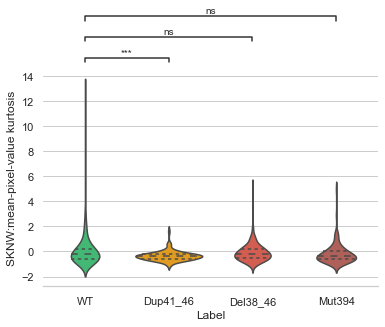

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.504e-06 stat=4.900e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.864e-04 stat=-3.662e+00
WT v.s. Mut394: t-test independent samples, P_val=4.189e-01 stat=8.095e-01
o


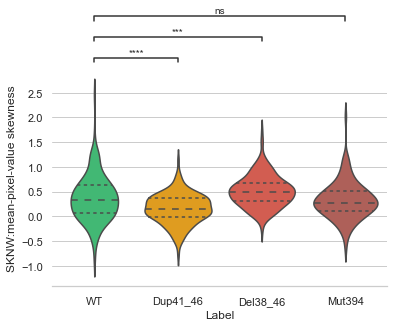

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.565e-31 stat=-1.280e+01
WT v.s. Del38_46: t-test independent samples, P_val=1.248e-19 stat=-9.595e+00
WT v.s. Mut394: t-test independent samples, P_val=3.437e-06 stat=-4.732e+00
o


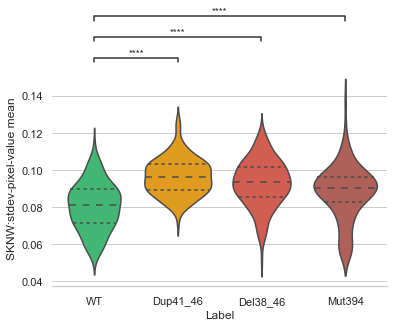

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.880e-34 stat=-1.378e+01
WT v.s. Del38_46: t-test independent samples, P_val=3.292e-17 stat=-8.861e+00
WT v.s. Mut394: t-test independent samples, P_val=6.757e-07 stat=-5.077e+00
o


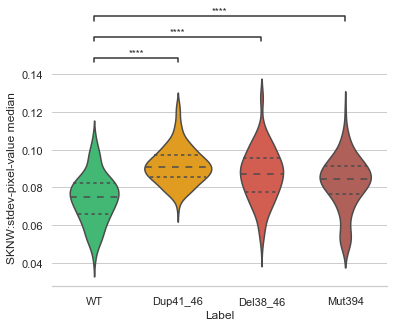

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.760e-02 stat=-2.386e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.378e-05 stat=-4.086e+00
WT v.s. Mut394: t-test independent samples, P_val=4.018e-01 stat=-8.397e-01
o


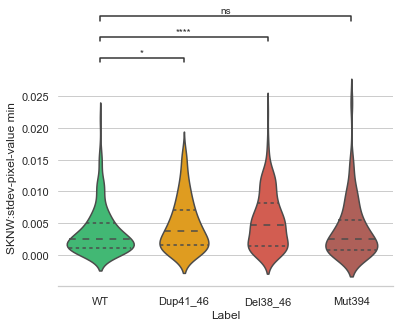

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.068e-10 stat=-6.561e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.539e-03 stat=-2.735e+00
WT v.s. Mut394: t-test independent samples, P_val=3.949e-02 stat=-2.068e+00
o


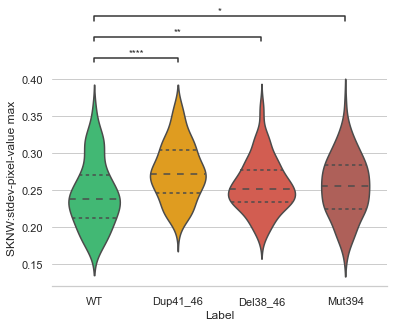

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.340e-04 stat=-3.450e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.465e-01 stat=3.235e-01
WT v.s. Mut394: t-test independent samples, P_val=5.071e-01 stat=-6.642e-01
o


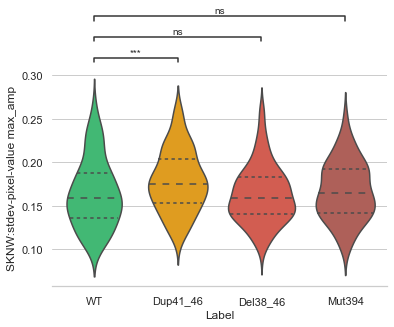

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.574e-06 stat=-4.617e+00
WT v.s. Del38_46: t-test independent samples, P_val=8.635e-11 stat=-6.681e+00
WT v.s. Mut394: t-test independent samples, P_val=2.543e-01 stat=-1.142e+00
o


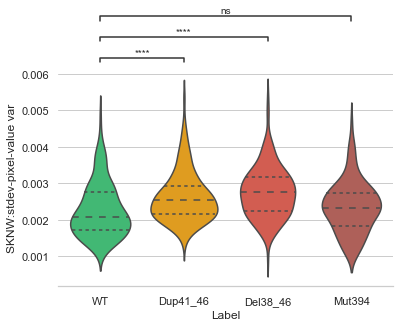

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.579e-07 stat=-5.017e+00
WT v.s. Del38_46: t-test independent samples, P_val=9.253e-12 stat=-7.041e+00
WT v.s. Mut394: t-test independent samples, P_val=2.267e-01 stat=-1.212e+00
o


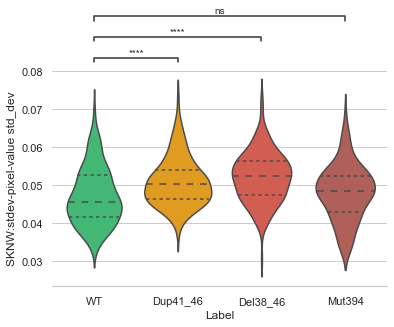

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.639e-07 stat=-5.351e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.473e-12 stat=-7.247e+00
WT v.s. Mut394: t-test independent samples, P_val=1.273e-01 stat=-1.529e+00
o


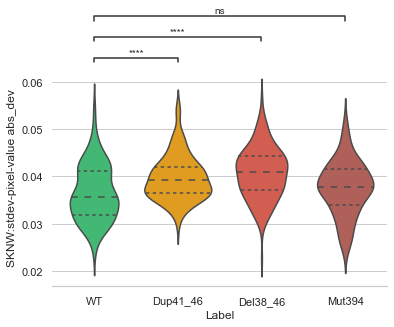

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.856e-02 stat=2.199e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.911e-03 stat=2.769e+00
WT v.s. Mut394: t-test independent samples, P_val=6.810e-02 stat=1.831e+00
o


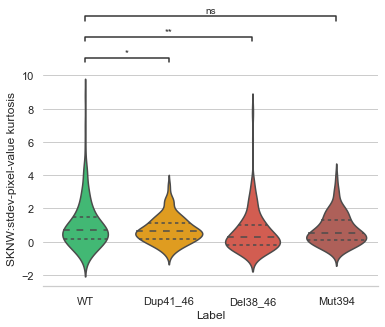

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.811e-06 stat=4.861e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.798e-04 stat=3.668e+00
WT v.s. Mut394: t-test independent samples, P_val=4.074e-03 stat=2.895e+00
o


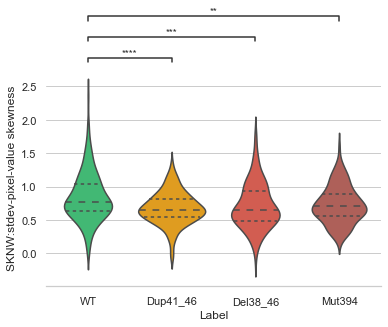

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.419e-15 stat=8.392e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.012e-15 stat=8.139e+00
WT v.s. Mut394: t-test independent samples, P_val=1.983e-13 stat=7.702e+00
o


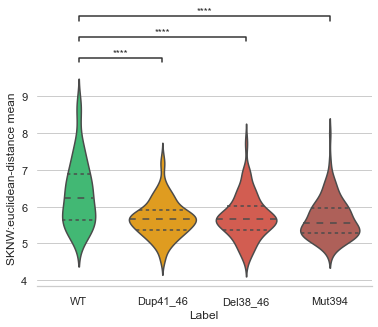

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.839e-09 stat=6.108e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.743e-10 stat=6.337e+00
WT v.s. Mut394: t-test independent samples, P_val=1.085e-11 stat=7.072e+00
o


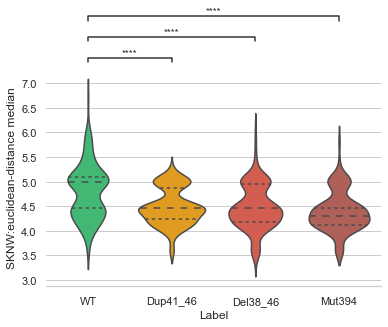

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.450e-01 stat=1.957e-01
WT v.s. Del38_46: t-test independent samples, P_val=5.226e-01 stat=-6.400e-01
WT v.s. Mut394: t-test independent samples, P_val=3.845e-01 stat=8.708e-01
o


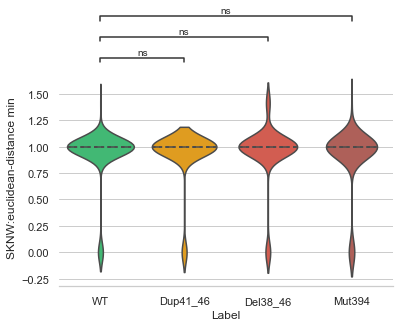

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.741e-03 stat=2.727e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.866e-11 stat=6.860e+00
WT v.s. Mut394: t-test independent samples, P_val=3.204e-03 stat=2.972e+00
o


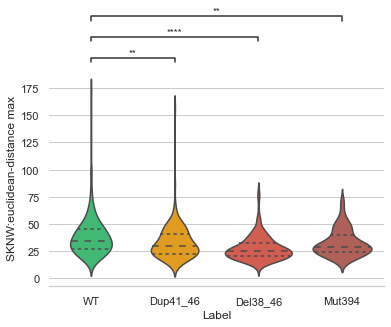

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.619e-02 stat=2.417e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.079e-10 stat=6.645e+00
WT v.s. Mut394: t-test independent samples, P_val=8.004e-03 stat=2.670e+00
o


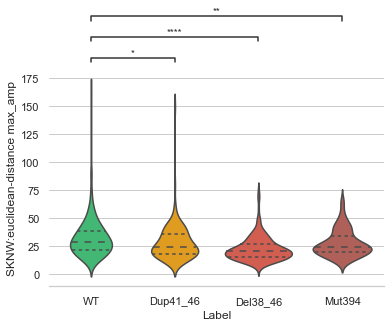

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.379e-07 stat=5.385e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.730e-09 stat=6.040e+00
WT v.s. Mut394: t-test independent samples, P_val=9.097e-06 stat=4.516e+00
o


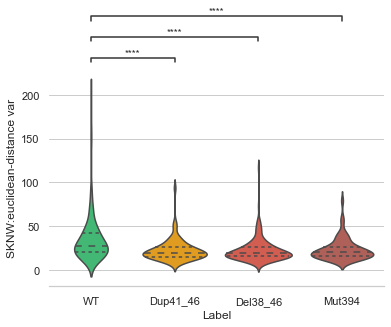

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.441e-09 stat=6.228e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.529e-11 stat=6.961e+00
WT v.s. Mut394: t-test independent samples, P_val=4.602e-07 stat=5.156e+00
o


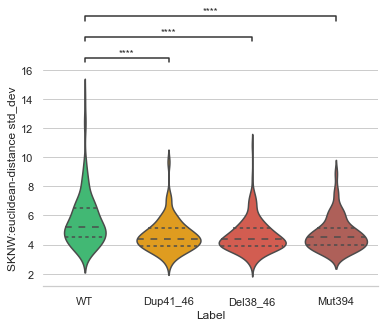

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.530e-14 stat=7.926e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.474e-13 stat=7.597e+00
WT v.s. Mut394: t-test independent samples, P_val=1.557e-09 stat=6.233e+00
o


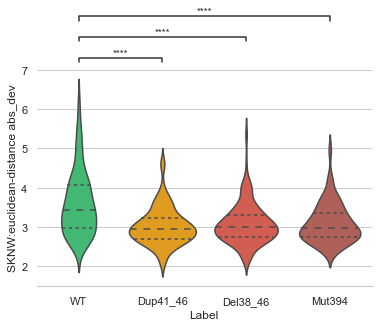

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.016e-01 stat=-2.514e-01
WT v.s. Del38_46: t-test independent samples, P_val=8.736e-05 stat=3.967e+00
WT v.s. Mut394: t-test independent samples, P_val=1.331e-01 stat=1.506e+00
o


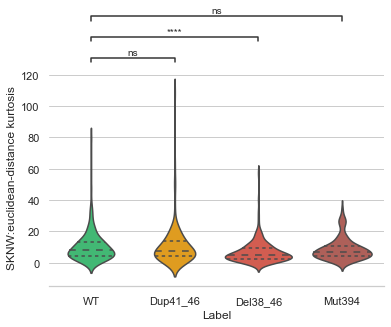

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.466e-01 stat=6.035e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.261e-05 stat=4.426e+00
WT v.s. Mut394: t-test independent samples, P_val=8.508e-02 stat=1.728e+00
o


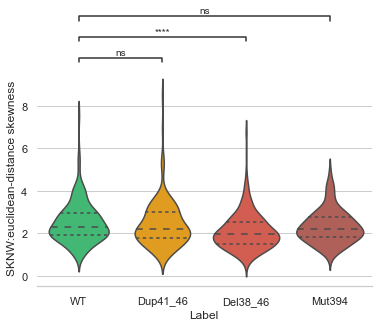

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.169e-04 stat=3.899e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.883e-08 stat=5.748e+00
WT v.s. Mut394: t-test independent samples, P_val=1.461e-02 stat=-2.456e+00
o


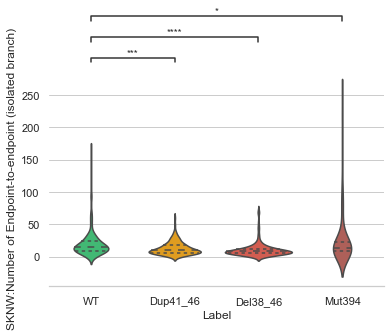

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.168e-17 stat=9.061e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.011e-05 stat=4.476e+00
WT v.s. Mut394: t-test independent samples, P_val=2.965e-01 stat=1.046e+00
o


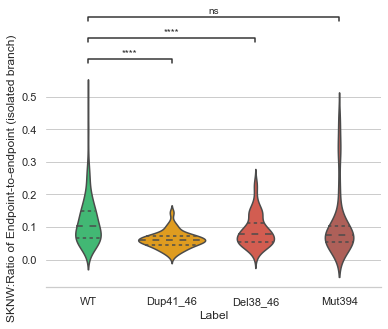

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.416e-12 stat=7.366e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.199e-03 stat=3.264e+00
WT v.s. Mut394: t-test independent samples, P_val=4.281e-05 stat=4.153e+00
o


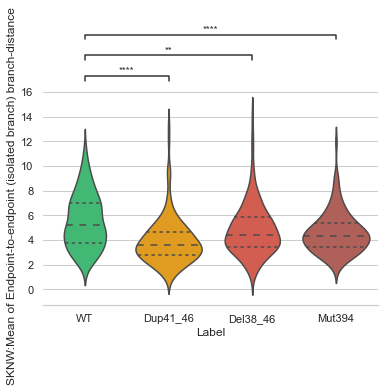

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.621e-10 stat=6.602e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.349e-07 stat=5.376e+00
WT v.s. Mut394: t-test independent samples, P_val=1.845e-03 stat=3.142e+00
o


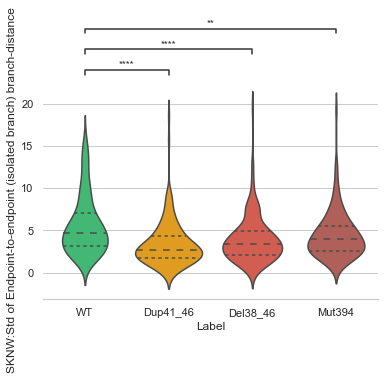

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.432e-01 stat=-1.467e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.040e-14 stat=8.061e+00
WT v.s. Mut394: t-test independent samples, P_val=7.655e-01 stat=-2.985e-01
o


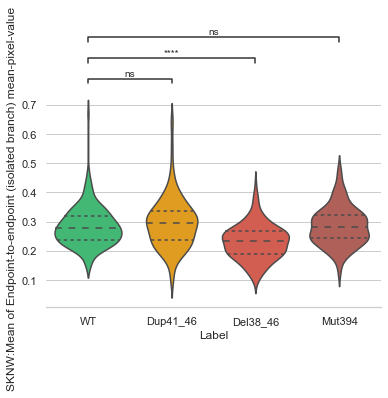

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.187e-02 stat=-2.043e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.632e-09 stat=6.102e+00
WT v.s. Mut394: t-test independent samples, P_val=5.928e-07 stat=-5.104e+00
o


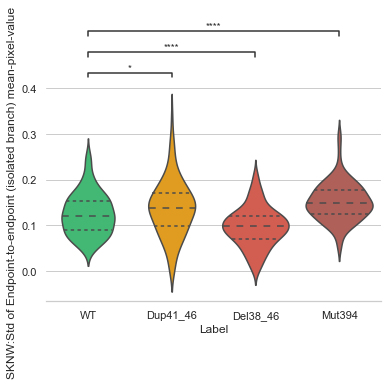

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.677e-05 stat=-4.005e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.482e-01 stat=-4.566e-01
WT v.s. Mut394: t-test independent samples, P_val=3.939e-04 stat=-3.585e+00
o


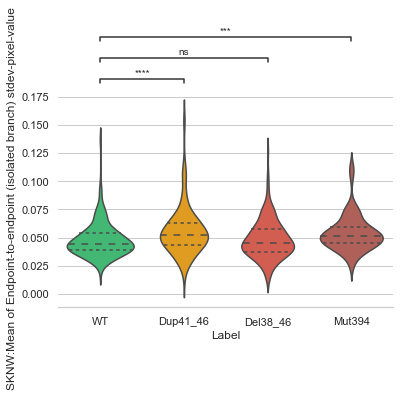

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.391e-01 stat=-1.483e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.706e-01 stat=1.103e+00
WT v.s. Mut394: t-test independent samples, P_val=9.784e-02 stat=-1.661e+00
o


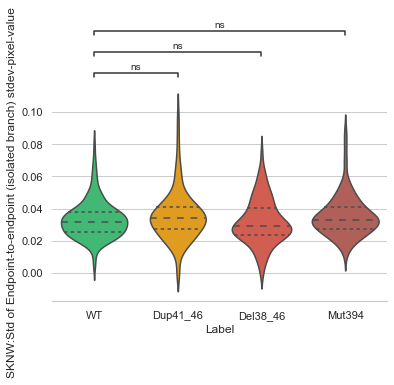

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.655e-13 stat=7.442e+00
WT v.s. Del38_46: t-test independent samples, P_val=8.015e-04 stat=3.380e+00
WT v.s. Mut394: t-test independent samples, P_val=2.265e-05 stat=4.305e+00
o


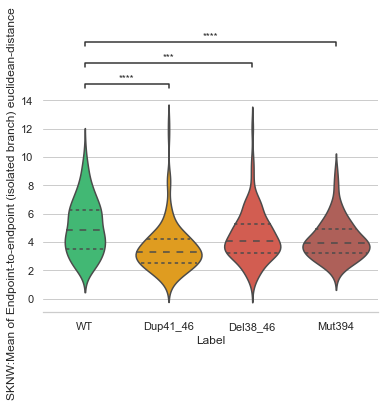

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.226e-10 stat=6.649e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.450e-07 stat=5.361e+00
WT v.s. Mut394: t-test independent samples, P_val=1.230e-03 stat=3.263e+00
o


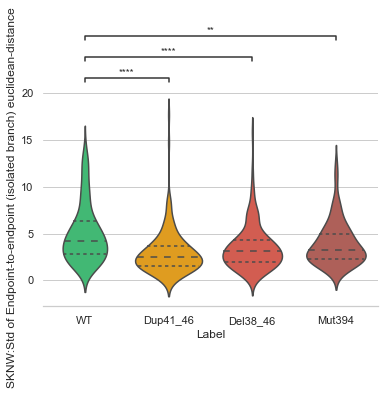

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.553e-01 stat=-9.256e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.295e-08 stat=5.522e+00
WT v.s. Mut394: t-test independent samples, P_val=1.414e-02 stat=-2.468e+00
o


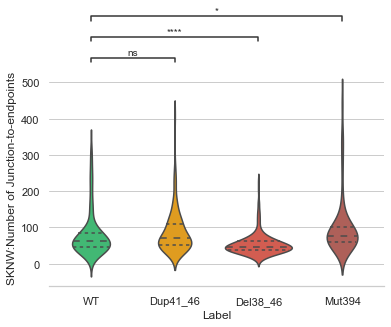

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.191e-08 stat=5.849e+00
WT v.s. Del38_46: t-test independent samples, P_val=9.110e-03 stat=-2.622e+00
WT v.s. Mut394: t-test independent samples, P_val=1.751e-01 stat=1.359e+00
o


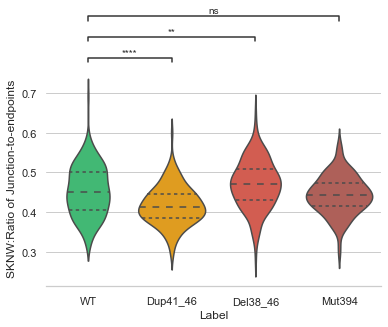

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.796e-22 stat=1.041e+01
WT v.s. Del38_46: t-test independent samples, P_val=2.792e-12 stat=7.228e+00
WT v.s. Mut394: t-test independent samples, P_val=3.492e-10 stat=6.493e+00
o


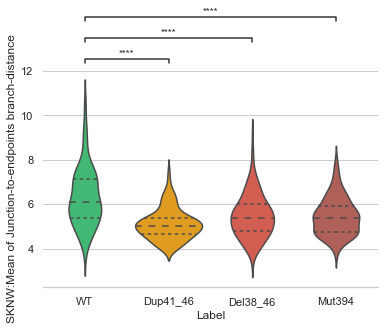

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.143e-13 stat=7.522e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.829e-08 stat=5.672e+00
WT v.s. Mut394: t-test independent samples, P_val=1.947e-05 stat=4.341e+00
o


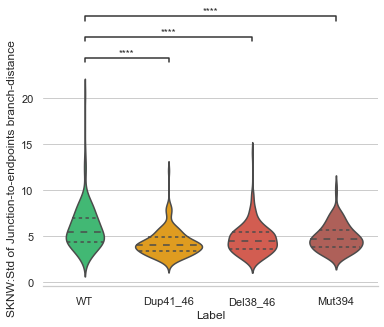

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.687e-04 stat=-3.533e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.084e-13 stat=7.488e+00
WT v.s. Mut394: t-test independent samples, P_val=3.416e-01 stat=9.525e-01
o


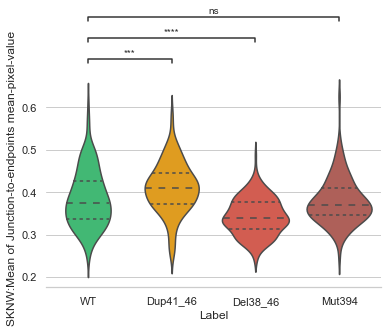

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.562e-05 stat=-4.192e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.318e-02 stat=1.940e+00
WT v.s. Mut394: t-test independent samples, P_val=1.284e-07 stat=-5.411e+00
o


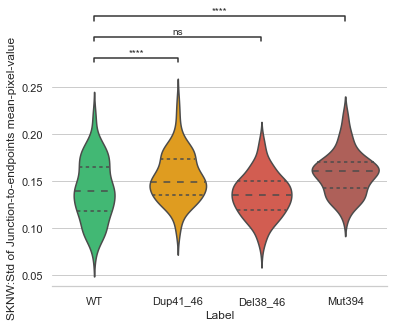

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.092e-22 stat=-1.049e+01
WT v.s. Del38_46: t-test independent samples, P_val=9.877e-12 stat=-7.030e+00
WT v.s. Mut394: t-test independent samples, P_val=7.861e-04 stat=-3.392e+00
o


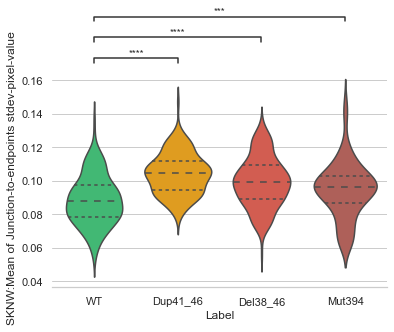

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.281e-09 stat=-6.248e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.125e-05 stat=-4.452e+00
WT v.s. Mut394: t-test independent samples, P_val=1.665e-01 stat=-1.387e+00
o


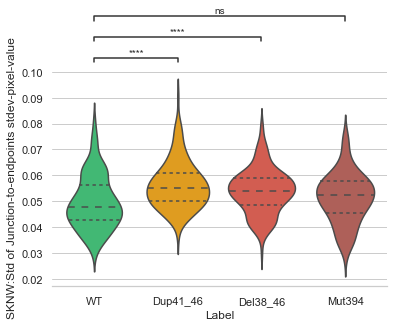

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.099e-22 stat=1.033e+01
WT v.s. Del38_46: t-test independent samples, P_val=1.955e-12 stat=7.283e+00
WT v.s. Mut394: t-test independent samples, P_val=4.146e-10 stat=6.464e+00
o


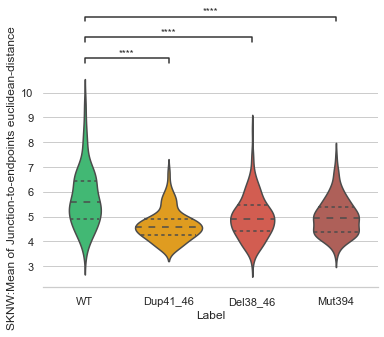

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.523e-12 stat=7.276e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.602e-08 stat=5.627e+00
WT v.s. Mut394: t-test independent samples, P_val=4.732e-05 stat=4.129e+00
o


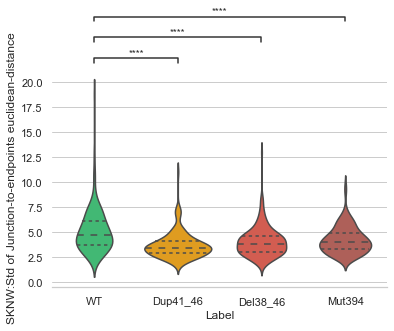

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.919e-03 stat=-2.998e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.828e-08 stat=5.572e+00
WT v.s. Mut394: t-test independent samples, P_val=2.246e-01 stat=-1.217e+00
o


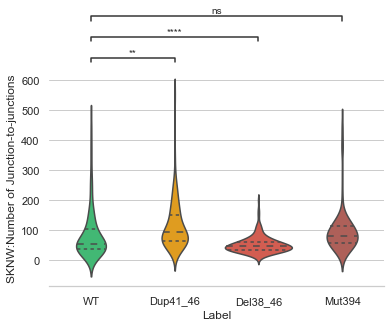

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.196e-18 stat=-9.368e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.419e-01 stat=-1.172e+00
WT v.s. Mut394: t-test independent samples, P_val=1.511e-01 stat=-1.439e+00
o


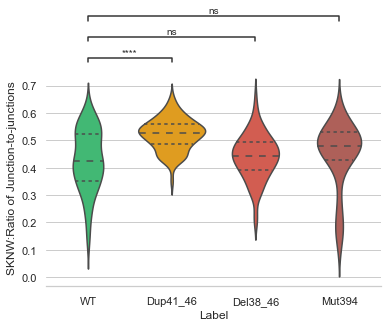

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.366e-07 stat=5.208e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.113e-06 stat=4.952e+00
WT v.s. Mut394: t-test independent samples, P_val=1.082e-06 stat=4.979e+00
o


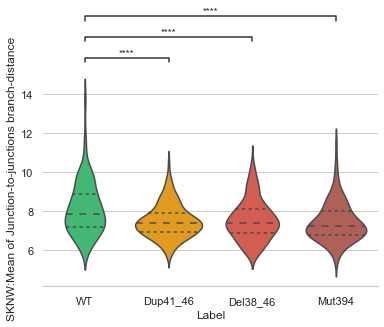

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.725e-04 stat=3.531e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.420e-07 stat=5.192e+00
WT v.s. Mut394: t-test independent samples, P_val=1.588e-04 stat=3.826e+00
o


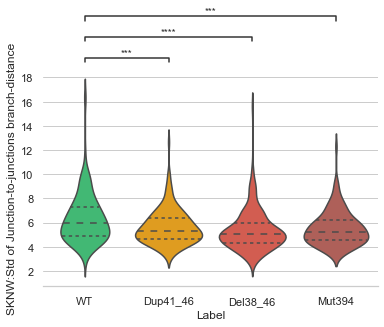

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.038e-05 stat=-4.478e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.284e-05 stat=4.204e+00
WT v.s. Mut394: t-test independent samples, P_val=3.911e-01 stat=8.589e-01
o


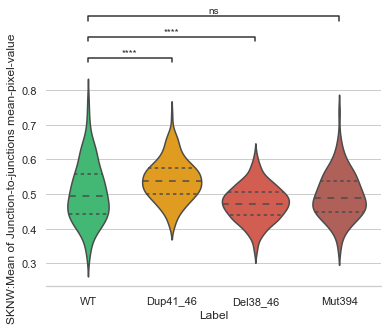

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.320e-02 stat=-1.684e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.417e-02 stat=-1.932e+00
WT v.s. Mut394: t-test independent samples, P_val=8.951e-03 stat=-2.631e+00
o


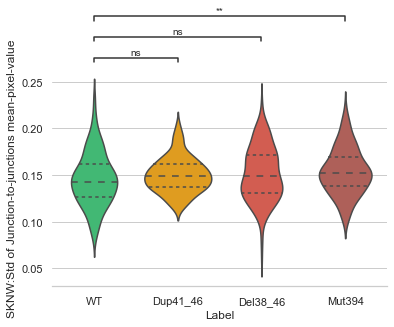

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.579e-23 stat=-1.071e+01
WT v.s. Del38_46: t-test independent samples, P_val=1.053e-20 stat=-9.910e+00
WT v.s. Mut394: t-test independent samples, P_val=2.254e-05 stat=-4.306e+00
o


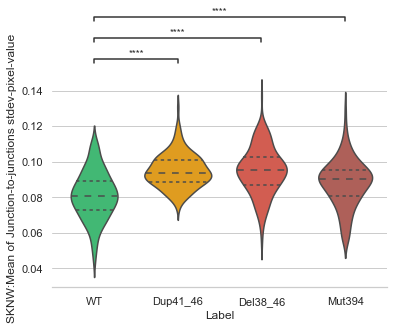

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.529e-02 stat=-1.923e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.154e-09 stat=-5.951e+00
WT v.s. Mut394: t-test independent samples, P_val=3.678e-01 stat=-9.020e-01
o


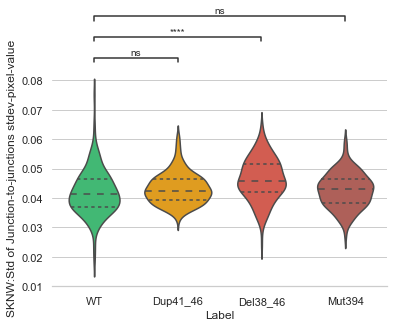

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.376e-07 stat=4.999e+00
WT v.s. Del38_46: t-test independent samples, P_val=8.593e-07 stat=5.006e+00
WT v.s. Mut394: t-test independent samples, P_val=1.100e-06 stat=4.975e+00
o


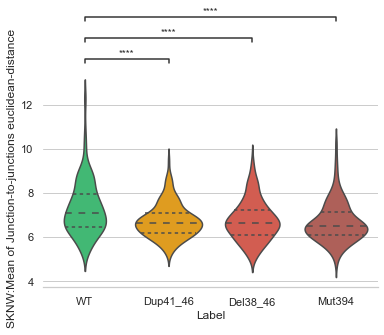

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.577e-03 stat=3.187e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.348e-07 stat=5.376e+00
WT v.s. Mut394: t-test independent samples, P_val=5.437e-04 stat=3.496e+00
o


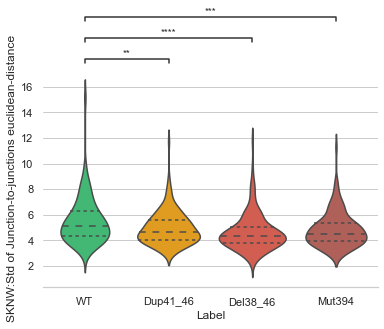

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.998e-01 stat=-1.260e-01
WT v.s. Del38_46: t-test independent samples, P_val=9.217e-01 stat=9.833e-02
WT v.s. Mut394: t-test independent samples, P_val=3.790e-01 stat=-8.810e-01
o


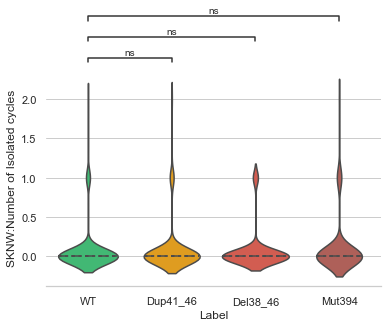

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.961e-01 stat=4.910e-03
WT v.s. Del38_46: t-test independent samples, P_val=3.470e-01 stat=-9.416e-01
WT v.s. Mut394: t-test independent samples, P_val=8.575e-01 stat=1.797e-01
o


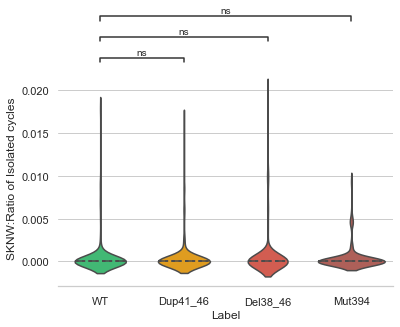

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.900e-01 stat=3.993e-01
WT v.s. Del38_46: t-test independent samples, P_val=2.558e-01 stat=-1.138e+00
WT v.s. Mut394: t-test independent samples, P_val=5.381e-01 stat=-6.163e-01
o


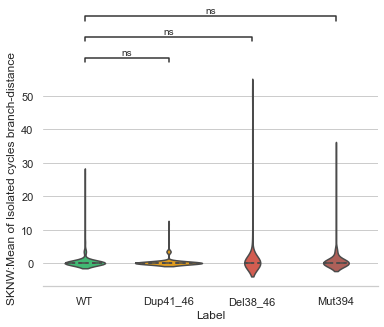

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=2.328e-01 stat=-1.196e+00
o


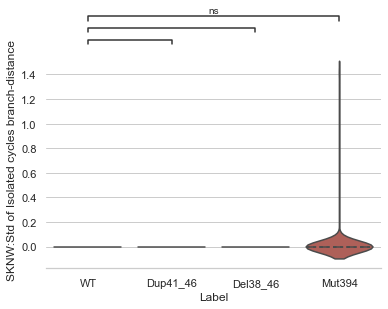

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.534e-01 stat=-4.494e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.342e-01 stat=-4.762e-01
WT v.s. Mut394: t-test independent samples, P_val=3.709e-01 stat=-8.961e-01
o


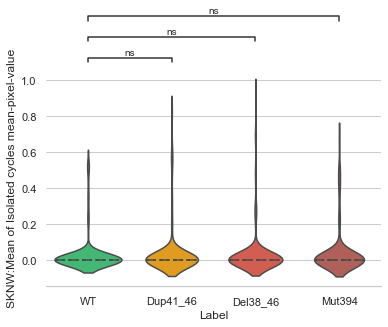

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.400e-01 stat=-3.322e-01
WT v.s. Del38_46: t-test independent samples, P_val=2.908e-01 stat=1.058e+00
WT v.s. Mut394: t-test independent samples, P_val=5.928e-01 stat=-5.353e-01
o


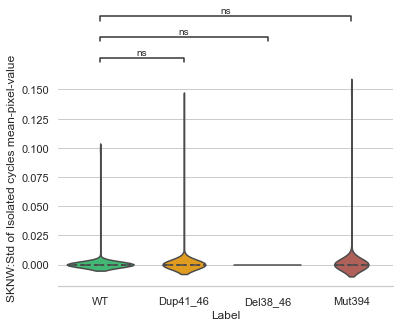

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.852e-01 stat=-1.855e-02
WT v.s. Del38_46: t-test independent samples, P_val=1.551e-01 stat=-1.425e+00
WT v.s. Mut394: t-test independent samples, P_val=7.229e-01 stat=-3.549e-01
o


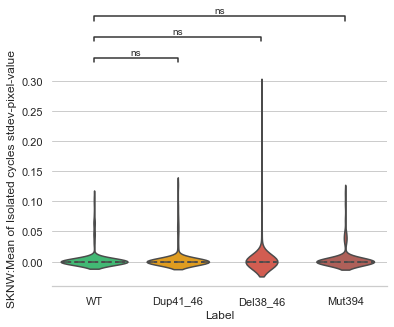

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.767e-01 stat=-5.587e-01
WT v.s. Del38_46: t-test independent samples, P_val=2.908e-01 stat=1.058e+00
WT v.s. Mut394: t-test independent samples, P_val=9.344e-01 stat=8.242e-02
o


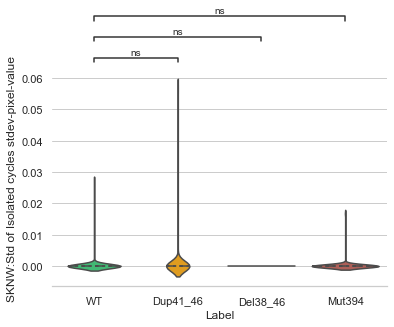

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan
o


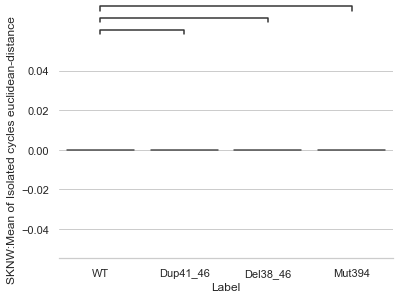

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan
o


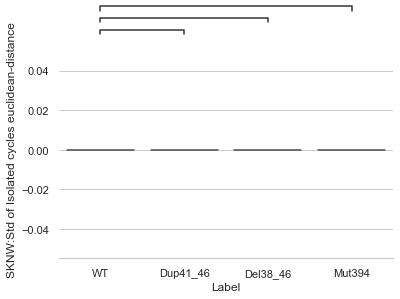

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.715e-02 stat=-2.396e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.423e-08 stat=5.491e+00
WT v.s. Mut394: t-test independent samples, P_val=1.750e-01 stat=-1.360e+00
o


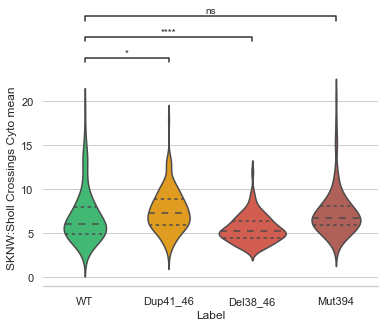

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.167e-01 stat=-1.573e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.687e-05 stat=4.360e+00
WT v.s. Mut394: t-test independent samples, P_val=8.808e-02 stat=-1.711e+00
o


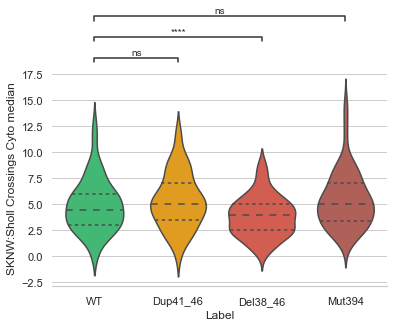

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan
o


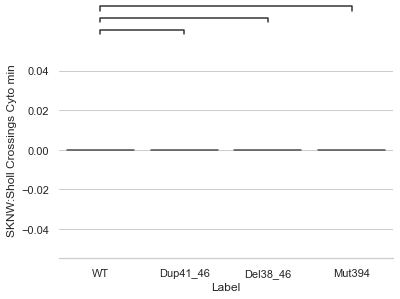

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.496e-02 stat=-2.446e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.004e-05 stat=4.478e+00
WT v.s. Mut394: t-test independent samples, P_val=1.032e-01 stat=-1.635e+00
o


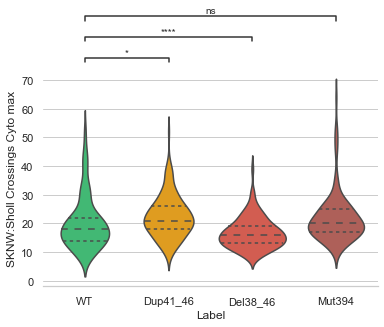

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.819e-02 stat=-2.374e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.640e-04 stat=3.808e+00
WT v.s. Mut394: t-test independent samples, P_val=9.400e-02 stat=-1.680e+00
o


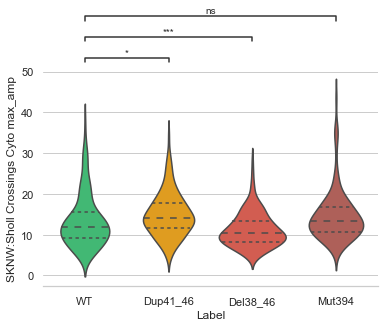

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.369e-01 stat=-9.616e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.650e-05 stat=4.365e+00
WT v.s. Mut394: t-test independent samples, P_val=4.809e-01 stat=-7.058e-01
o


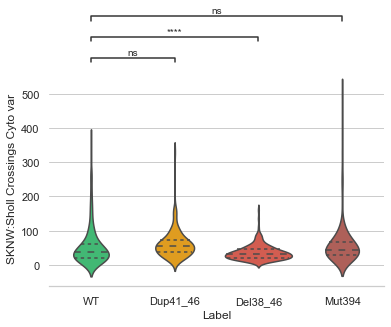

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.989e-02 stat=-2.340e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.669e-04 stat=3.803e+00
WT v.s. Mut394: t-test independent samples, P_val=1.882e-01 stat=-1.319e+00
o


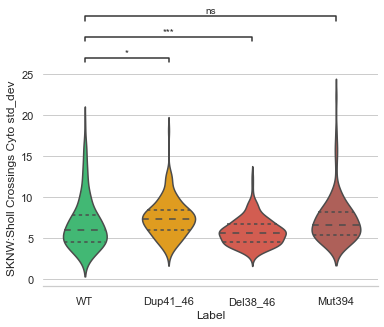

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.218e-02 stat=-2.151e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.451e-05 stat=4.083e+00
WT v.s. Mut394: t-test independent samples, P_val=2.162e-01 stat=-1.239e+00
o


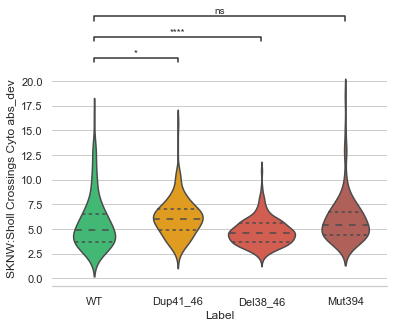

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.833e-01 stat=-5.491e-01
WT v.s. Del38_46: t-test independent samples, P_val=2.351e-01 stat=-1.189e+00
WT v.s. Mut394: t-test independent samples, P_val=6.697e-01 stat=-4.270e-01
o


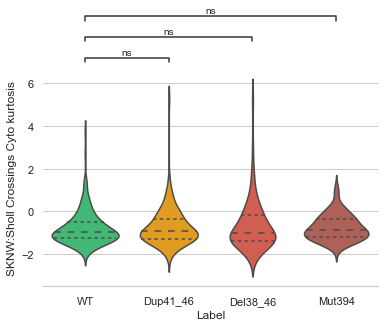

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.953e-01 stat=-8.512e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.687e-02 stat=-2.400e+00
WT v.s. Mut394: t-test independent samples, P_val=7.218e-01 stat=-3.565e-01
o


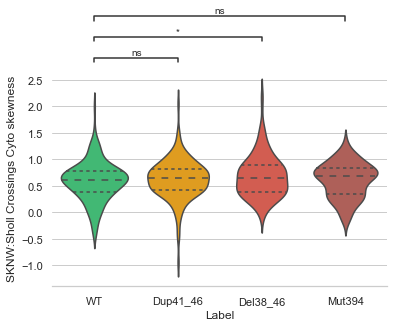

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.403e-02 stat=-2.470e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.511e-07 stat=5.254e+00
WT v.s. Mut394: t-test independent samples, P_val=1.884e-01 stat=-1.318e+00
o


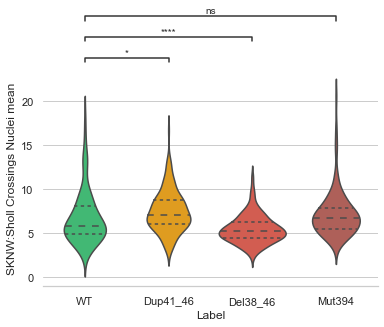

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.162e-02 stat=-1.953e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.610e-05 stat=4.036e+00
WT v.s. Mut394: t-test independent samples, P_val=1.485e-01 stat=-1.448e+00
o


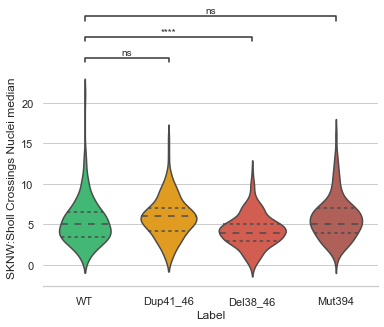

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan
o


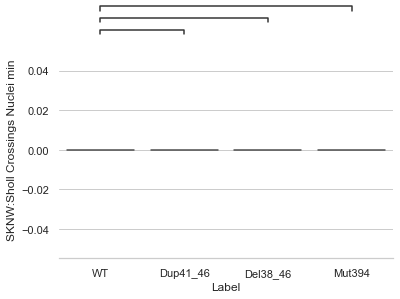

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.888e-03 stat=-2.719e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.765e-06 stat=4.761e+00
WT v.s. Mut394: t-test independent samples, P_val=2.432e-01 stat=-1.169e+00
o


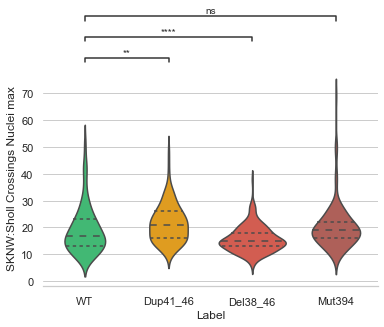

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.923e-03 stat=-2.672e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.784e-05 stat=4.243e+00
WT v.s. Mut394: t-test independent samples, P_val=2.963e-01 stat=-1.046e+00
o


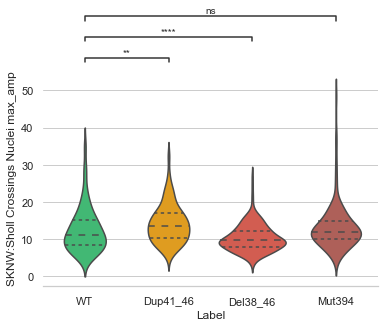

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.575e-01 stat=-1.134e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.787e-05 stat=4.346e+00
WT v.s. Mut394: t-test independent samples, P_val=7.512e-01 stat=-3.173e-01
o


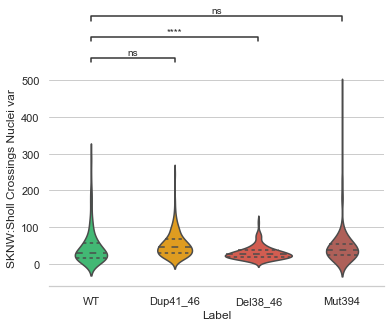

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.074e-02 stat=-2.566e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.177e-04 stat=3.734e+00
WT v.s. Mut394: t-test independent samples, P_val=3.779e-01 stat=-8.831e-01
o


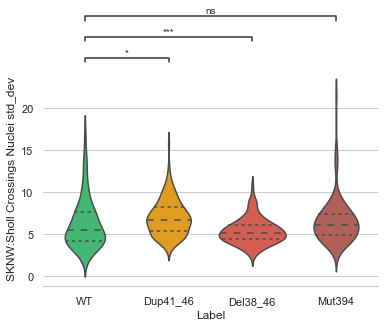

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.687e-02 stat=-2.402e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.222e-04 stat=3.631e+00
WT v.s. Mut394: t-test independent samples, P_val=3.696e-01 stat=-8.986e-01
o


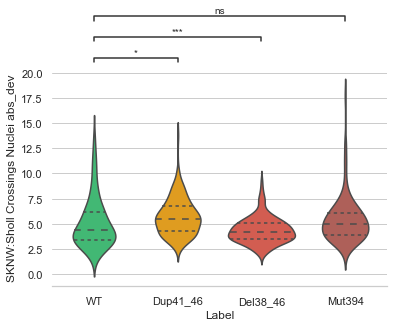

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.767e-01 stat=-4.173e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.855e-01 stat=4.053e-01
WT v.s. Mut394: t-test independent samples, P_val=8.149e-01 stat=2.343e-01
o


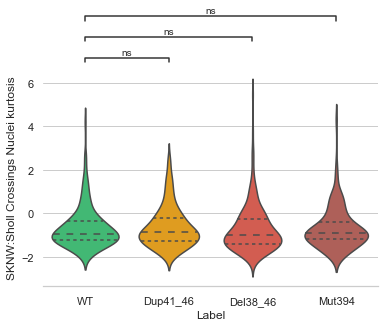

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.684e-01 stat=-7.259e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.774e-01 stat=-4.164e-01
WT v.s. Mut394: t-test independent samples, P_val=4.461e-01 stat=7.630e-01
o


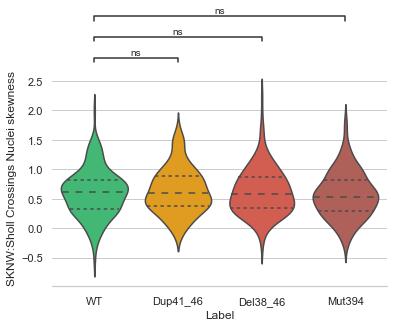

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.538e-02 stat=-2.436e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.315e-01 stat=1.512e+00
WT v.s. Mut394: t-test independent samples, P_val=2.854e-05 stat=-4.251e+00
o


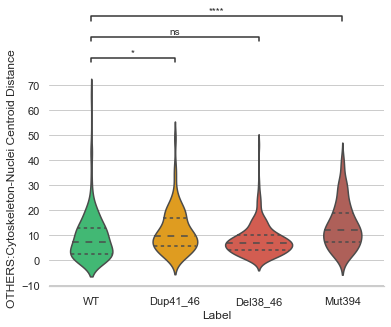

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.416e-02 stat=-1.732e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.240e-06 stat=4.622e+00
WT v.s. Mut394: t-test independent samples, P_val=1.252e-03 stat=-3.258e+00
o


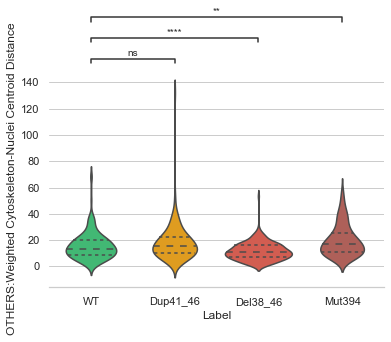

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.457e-02 stat=1.677e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.301e-02 stat=-1.865e+00
WT v.s. Mut394: t-test independent samples, P_val=4.074e-01 stat=8.296e-01
o


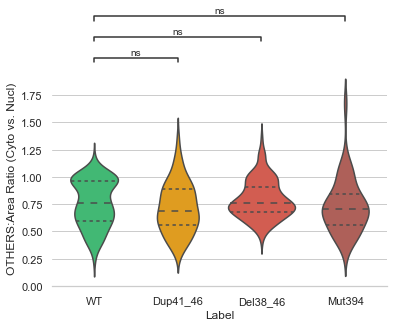

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.973e-01 stat=3.893e-01
WT v.s. Del38_46: t-test independent samples, P_val=4.937e-12 stat=7.139e+00
WT v.s. Mut394: t-test independent samples, P_val=3.854e-01 stat=-8.692e-01
o


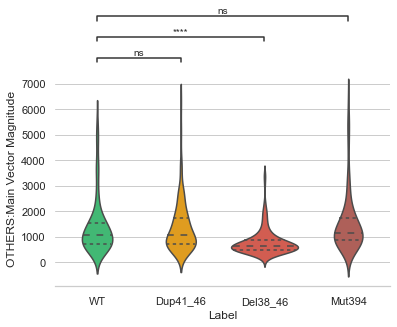

In [43]:
plot_violinplot(df=ResultsDF,save=True)

## <font color='red'>6.3.4 Displots</font>

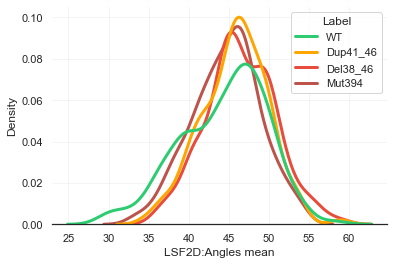

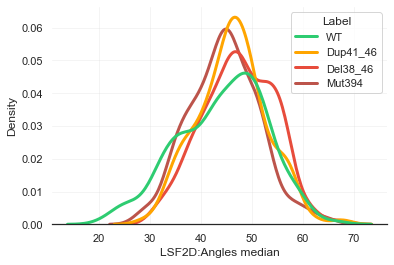

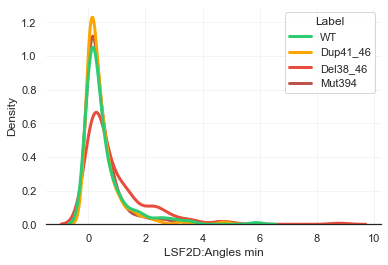

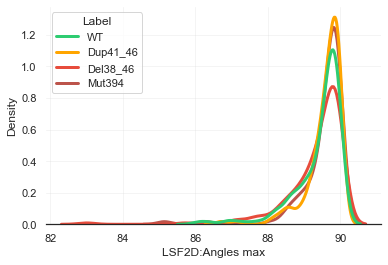

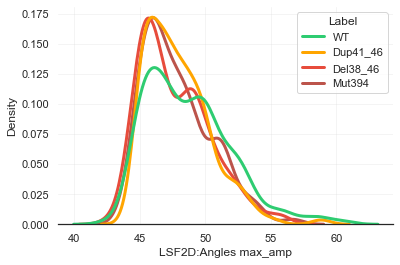

...

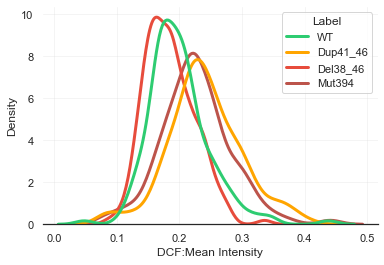

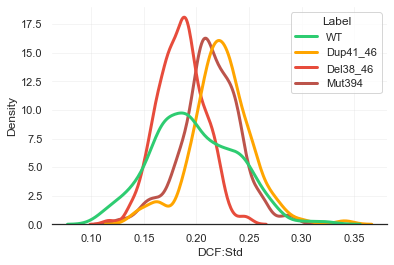

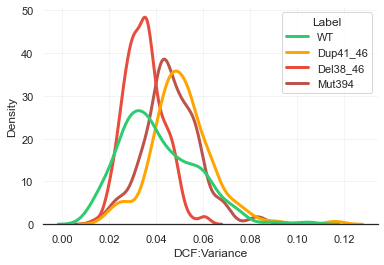

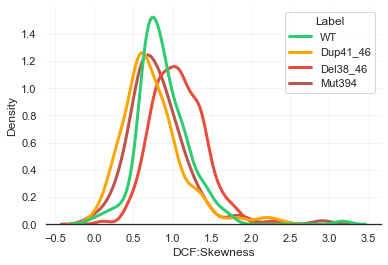

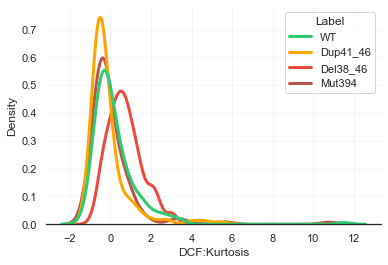

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


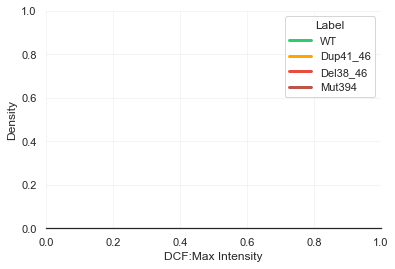

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


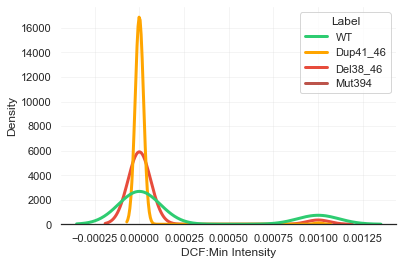

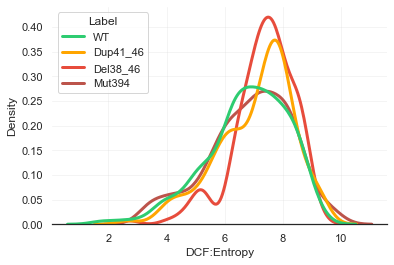

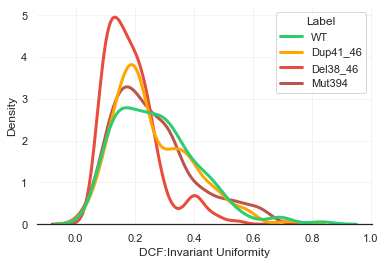

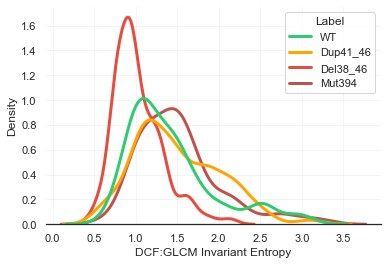

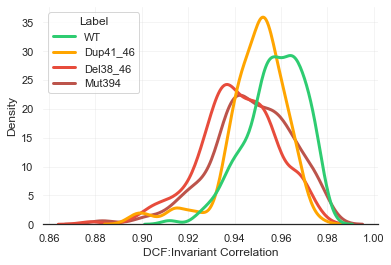

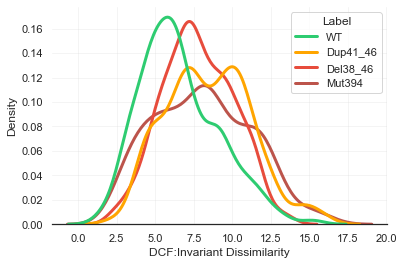

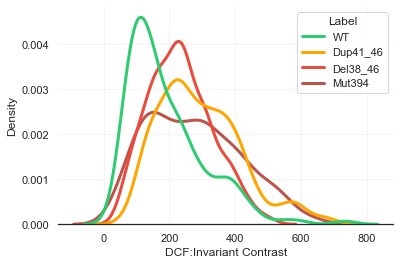

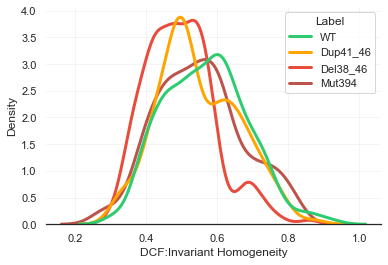

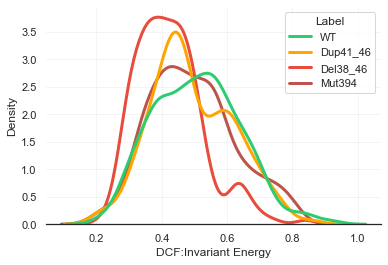

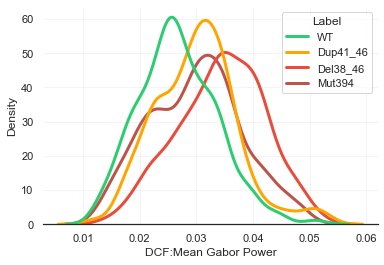

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


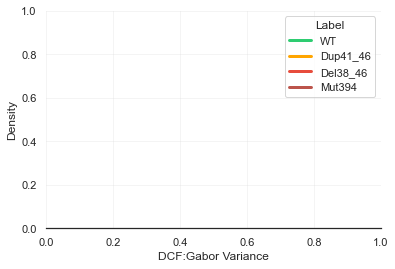

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


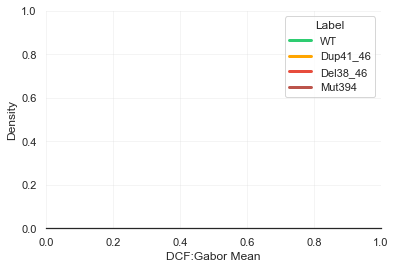

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


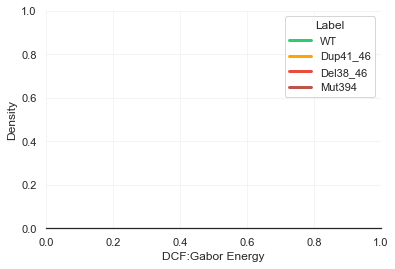

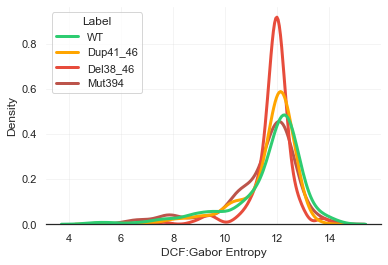

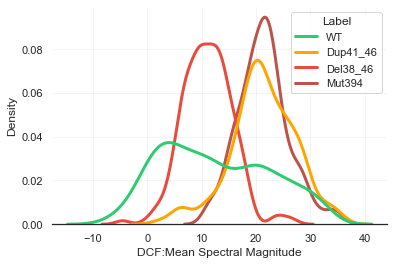

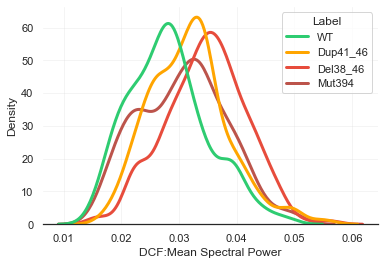

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


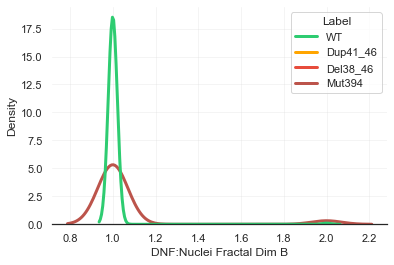

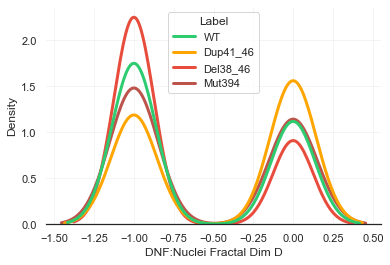

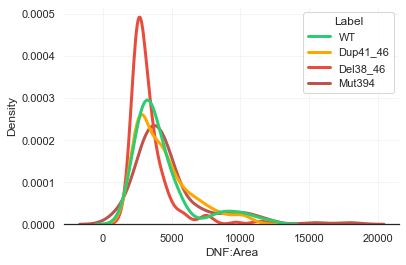

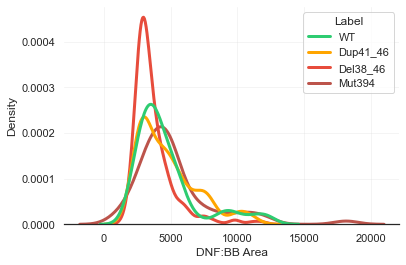

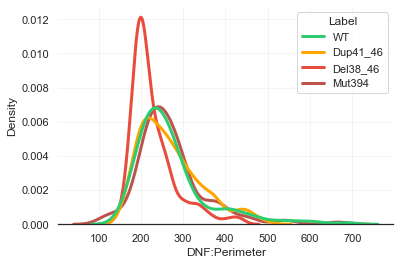

...

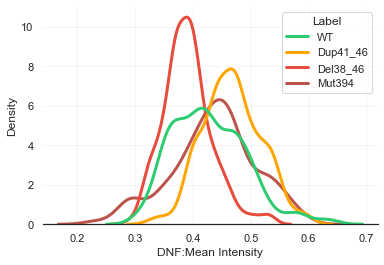

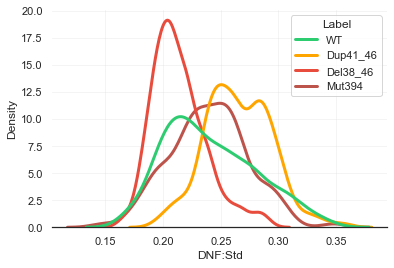

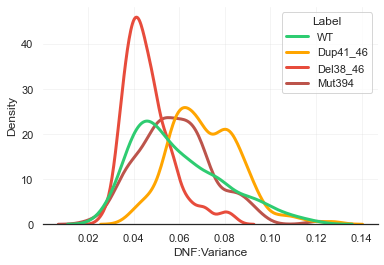

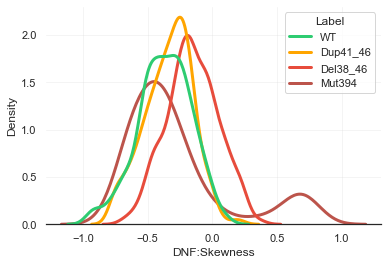

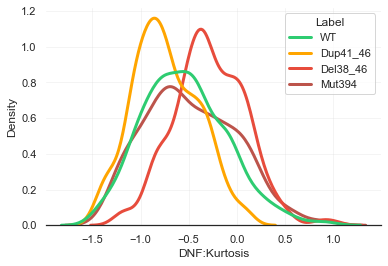

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


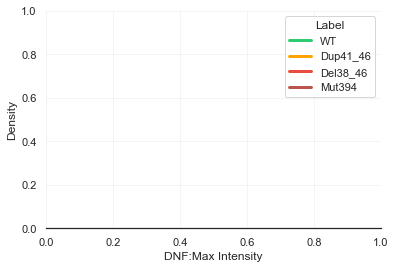

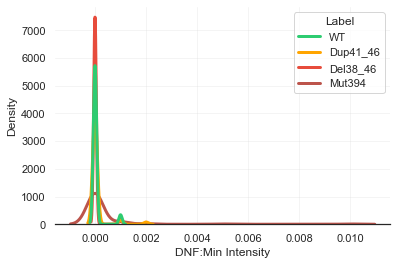

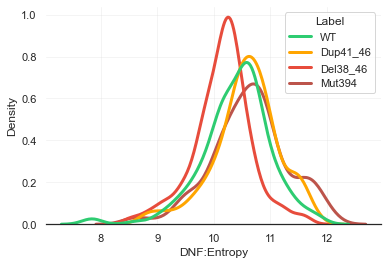

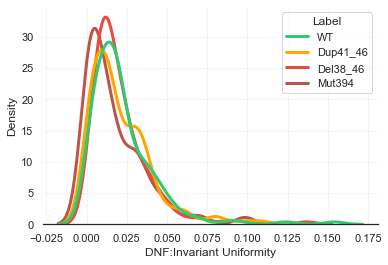

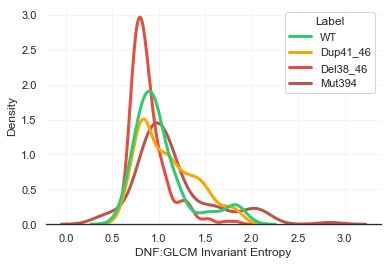

...

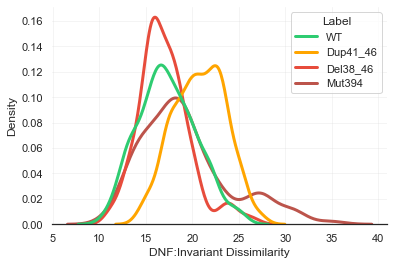

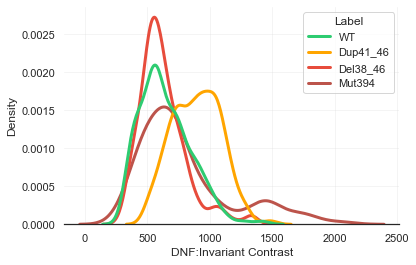

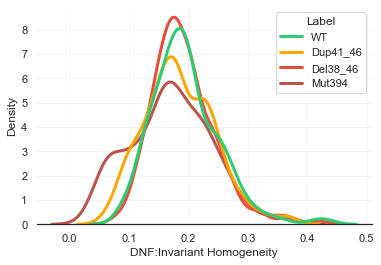

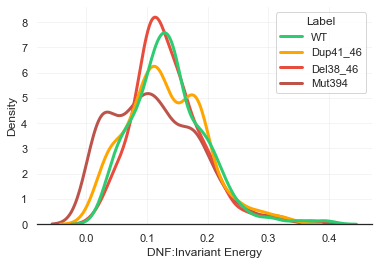

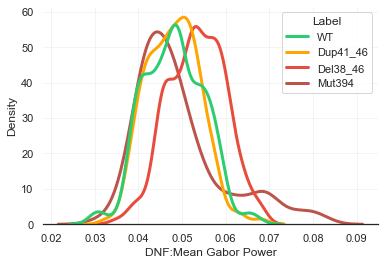

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


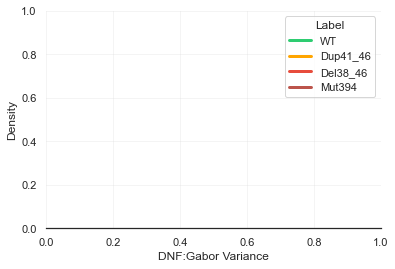

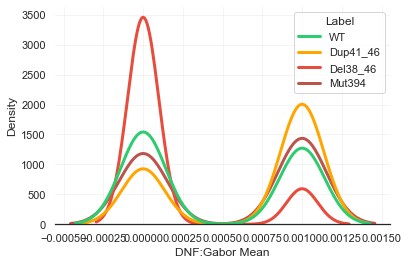

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


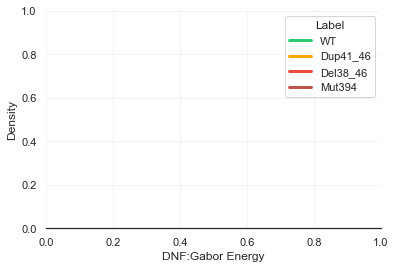

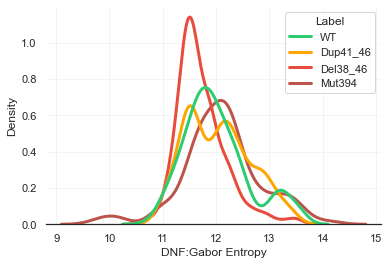

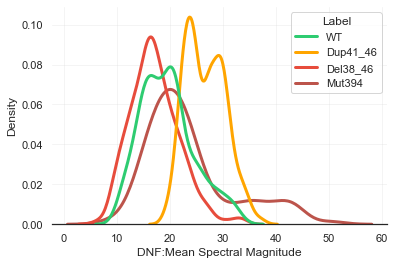

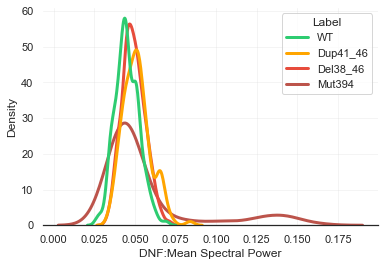

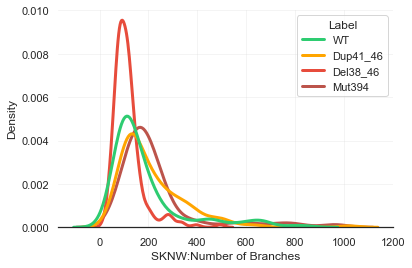

...

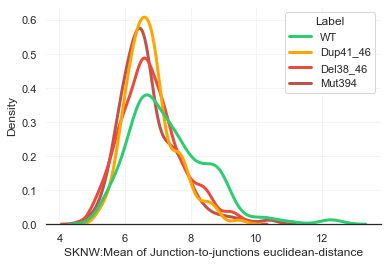

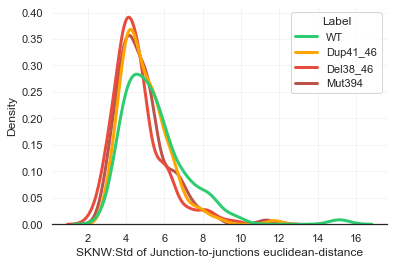

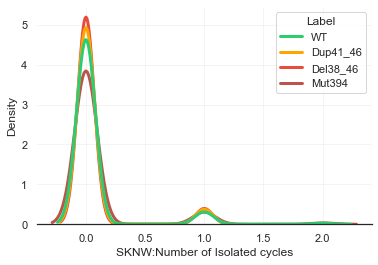

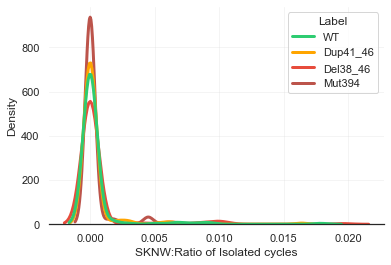

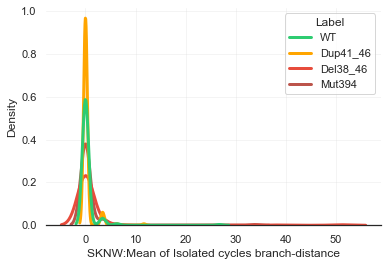

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


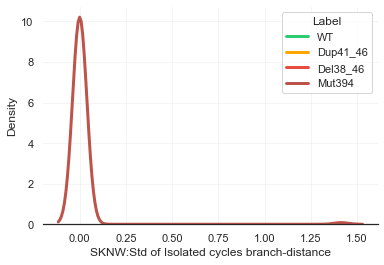

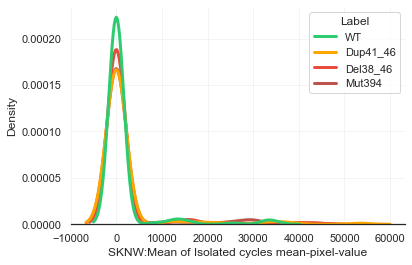

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


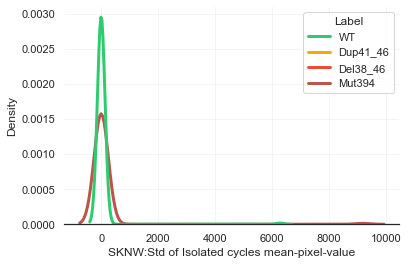

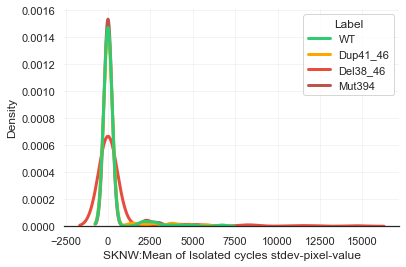

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


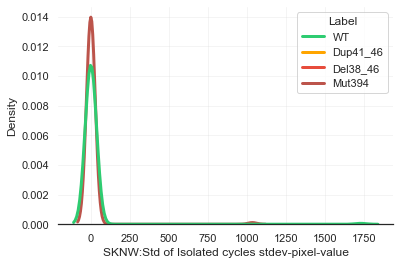

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


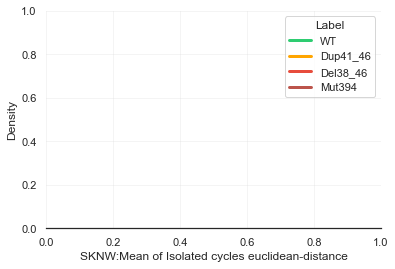

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


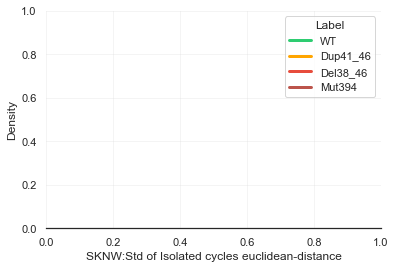

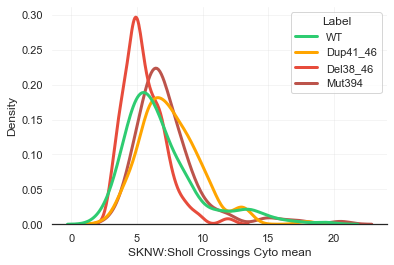

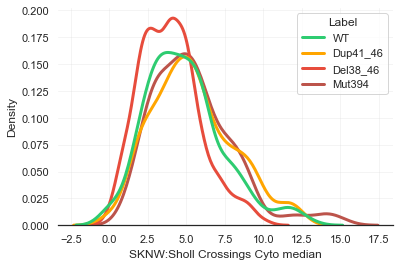

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


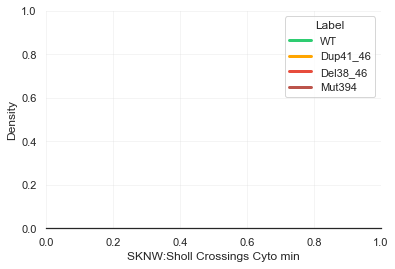

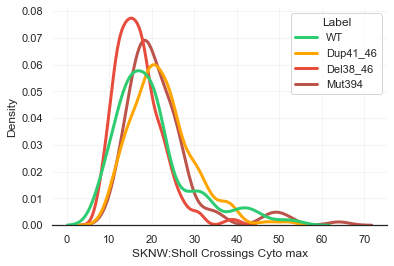

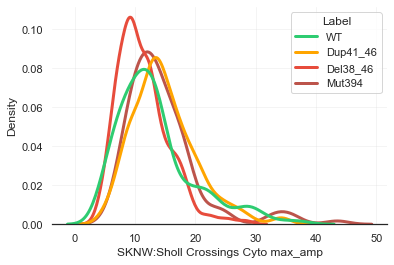

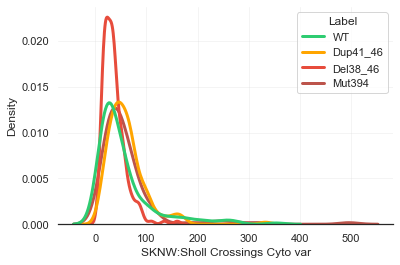

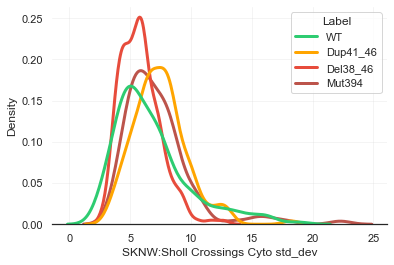

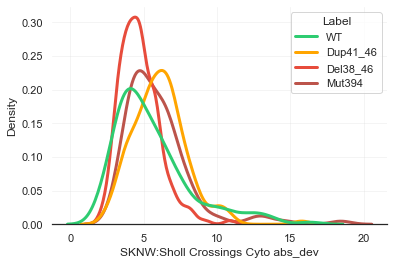

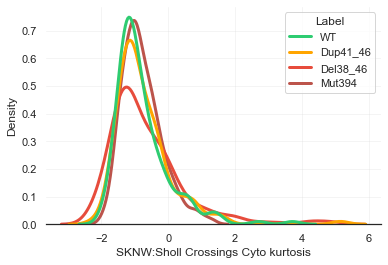

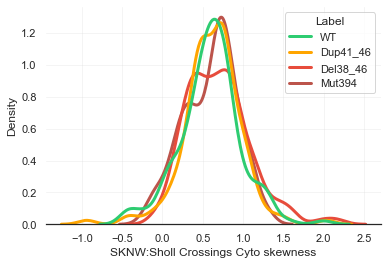

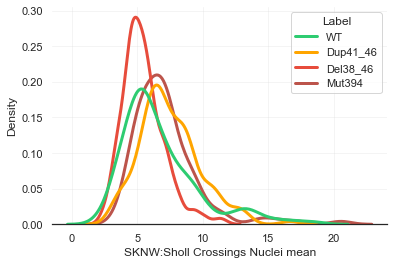

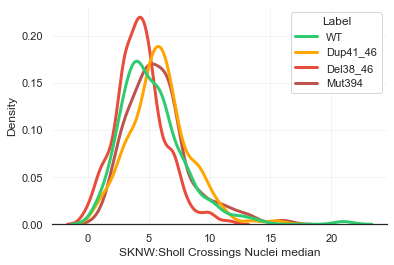

distributions.py (316): Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.


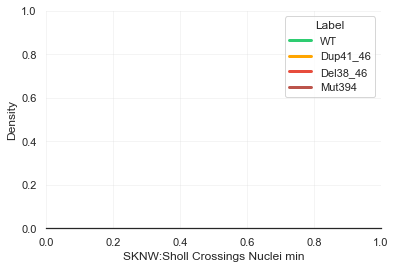

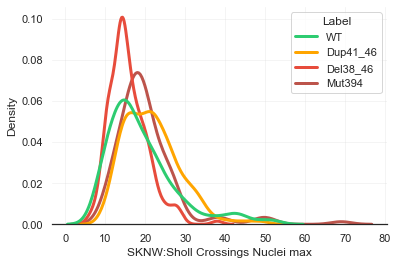

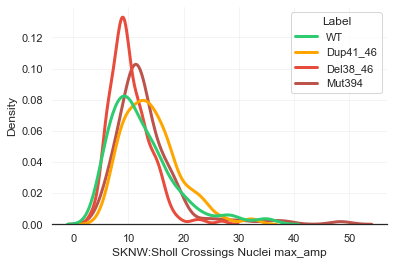

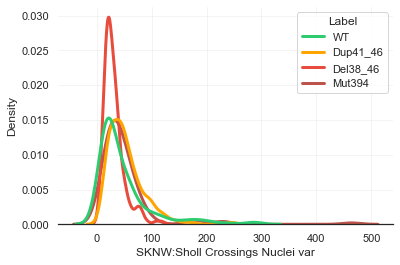

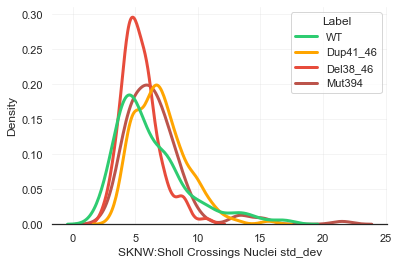

...

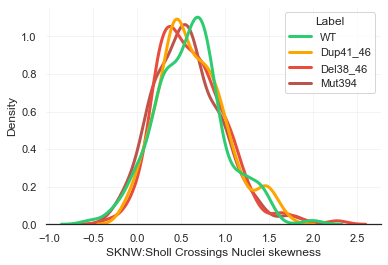

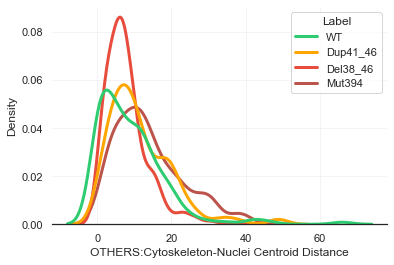

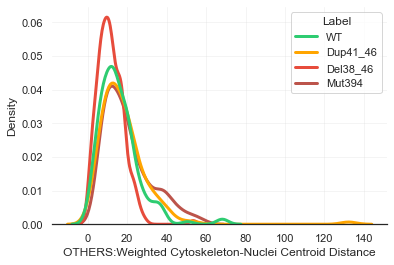

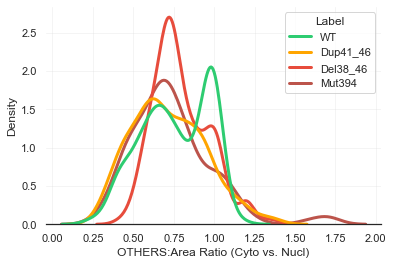

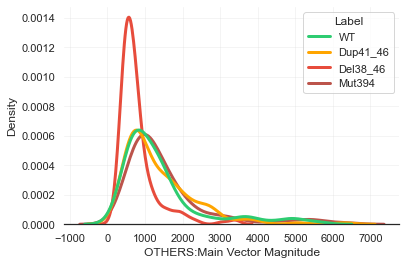

In [5]:
plot_displot(df=ResultsDF,ecdf=False,save=False)

## <font color='red'>6.3.4 OTHER PLOTS</font>

In [23]:
def corrected_density(skelpatch):
    ske = Skeleton(skelpatch.astype(float))
    
    return ske.path_lengths()



In [36]:
summarize(Skeleton(data['Patches'][0][0].astype(float)),find_main_branch=True)

,skeleton-id,node-id-src,node-id-dst,branch-distance,branch-type,mean-pixel-value,stdev-pixel-value,image-coord-src-0,image-coord-src-1,image-coord-dst-0,image-coord-dst-1,coord-src-0,coord-src-1,coord-dst-0,coord-dst-1,euclidean-distance,main
0,1,1,8,4.414214,1,1.0,0.000000e+00,0.0,53.0,4.0,54.0,0.0,53.0,4.0,54.0,4.123106,True
1,2,3,12,4.242641,1,1.0,0.000000e+00,2.0,51.0,5.0,48.0,2.0,51.0,5.0,48.0,4.242641,True
2,1,8,10,2.000000,1,1.0,0.000000e+00,4.0,54.0,4.0,56.0,4.0,54.0,4.0,56.0,2.000000,False
3,1,8,25,7.000000,2,1.0,1.490116e-08,4.0,54.0,11.0,54.0,4.0,54.0,11.0,54.0,7.000000,True
4,2,12,17,3.828427,1,1.0,0.000000e+00,5.0,48.0,7.0,45.0,5.0,48.0,7.0,45.0,3.605551,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175,39,1022,1036,3.414214,2,1.0,1.490116e-08,322.0,116.0,325.0,115.0,322.0,116.0,325.0,115.0,3.162278,False
176,39,1026,1028,2.000000,1,1.0,1.490116e-08,322.0,120.0,322.0,122.0,322.0,120.0,322.0,122.0,2.000000,False
177,39,1026,1043,7.242641,1,1.0,1.490116e-08,322.0,120.0,328.0,123.0,322.0,120.0,328.0,123.0,6.708204,True
178,39,1031,1036,3.414214,1,1.0,1.490116e-08,324.0,112.0,325.0,115.0,324.0,112.0,325.0,115.0,3.162278,False


In [35]:
len(list(filter(lambda d: d>=4, summarize(Skeleton(data['Patches'][0][0].astype(float)))['branch-distance'])))

90

In [548]:
[np.mean(np.array(ResultsDF['LSF2D:Triangle Areas'][el]) / np.array(ResultsDF['LSF2D:Distances to Centroid'][el])) for el in ResultsDF.index]

1046

In [23]:
from skimage.filters import apply_hysteresis_threshold
def est_area(ResultsRow):
    img = data['CYTO_DECONV']['Image'][ResultsRow['Img Index']] * ResultsRow['Mask']
    res = apply_hysteresis_threshold(img,threshold_otsu(img)*0.6,threshold_otsu(img))
    
    img_nucl = ResultsRow['Mask'] * (data['NUCL_DECONV']['Image'][ResultsRow['Img Index']] / np.max(data['NUCL_DECONV']['Image'][ResultsRow['Img Index']]))
    
    rprops_cyto,rprops_nucl = regionprops((res!=0)*1,res),regionprops((img_nucl!=0)*1,img_nucl)
    centro_cyto,centro_nucl = rprops_cyto[0].centroid,rprops_nucl[0].centroid
    w_centro_cyto,w_centro_nucl = rprops_cyto[0].weighted_centroid,rprops_nucl[0].weighted_centroid

    return rprops_nucl[0].area/rprops_cyto[0].area

def exp_area(ResultsRow):
    img = data['CYTO_DECONV']['Image'][ResultsRow['Img Index']] * ResultsRow['Mask']
    res = apply_hysteresis_threshold(img,threshold_otsu(img)*0.6,threshold_otsu(img))
    
    img_nucl = ResultsRow['Mask'] * (data['NUCL_DECONV']['Image'][ResultsRow['Img Index']] / np.max(data['NUCL_DECONV']['Image'][ResultsRow['Img Index']]))
    
    rprops_cyto,rprops_nucl = regionprops((res!=0)*1,res),regionprops((img_nucl!=0)*1,img_nucl)
    centro_cyto,centro_nucl = rprops_cyto[0].centroid,rprops_nucl[0].centroid
    w_centro_cyto,w_centro_nucl = rprops_cyto[0].weighted_centroid,rprops_nucl[0].weighted_centroid

    return rprops_cyto[0].area

# data['AreaRatio'] = [est_area(row) for index,row in ResultsDF.iterrows()]
# abcd = [exp_area(row) for index,row in ResultsDF.iterrows()]
# data['N over A'] = data['LSF1D:Number of Lines'] / abcd 



In [6]:
data

,Name,Img Index,Label,Mask,Patches,Lines,Graph,LSF2D:Angles mean,LSF2D:Angles median,LSF2D:Angles min,...,SKNW:Sholl Crossings Nuclei max_amp,SKNW:Sholl Crossings Nuclei var,SKNW:Sholl Crossings Nuclei std_dev,SKNW:Sholl Crossings Nuclei abs_dev,SKNW:Sholl Crossings Nuclei kurtosis,SKNW:Sholl Crossings Nuclei skewness,OTHERS:Cytoskeleton-Nuclei Centroid Distance,OTHERS:Weighted Cytoskeleton-Nuclei Centroid Distance,OTHERS:Area Ratio (Cyto vs. Nucl),OTHERS:Main Vector Magnitude
0,MAX_38_IF6_CHO_L-W5_Z_decon_ch02_PS.tif,38,No transfection,"[[False, False, False, False, False, False, Fa...","[[[False, False, False, False, False, False, F...","[((846.96, 125.385), (843.154, 135.458)), ((90...","[ (1, 2)\t1.0\n (2, 1)\t1.0\n (2, 4)\t1.0\n...",42.118819,42.6135,0.653,...,8.073171,11.969512,3.459698,2.731707,-0.364165,0.803558,49.774633,26.837390,0.551899,1440.873319
1,MAX_38_IF6_CHO_L-W5_Z_decon_ch02_PS.tif,38,No transfection,"[[False, False, False, False, False, False, Fa...","[[[False, False, False, False, False, False, F...","[((1226.05, 591.863), (1229.906, 588.782)), ((...","[ (1, 2)\t1.0\n (2, 1)\t1.0\n (2, 4)\t1.414...",38.247571,32.7200,0.110,...,8.928571,29.105820,5.394981,4.785714,-1.432878,-0.042269,12.957109,22.330308,0.560575,1762.518556
2,MAX_38_IF6_CHO_L-W5_Z_decon_ch02_PS.tif,38,No transfection,"[[False, False, False, False, False, False, Fa...","[[[False, False, False, False, False, False, F...","[((826.21, 118.655), (825.066, 124.886)), ((82...","[ (1, 2)\t1.0\n (2, 1)\t1.0\n (2, 3)\t1.414...",40.988292,41.0480,0.469,...,7.050000,11.587179,3.403995,2.700000,-0.649507,0.697840,45.713312,22.855052,0.504579,1411.933387
3,MAX_38_IF6_CHO_L-W5_Z_decon_ch02_PS.tif,38,No transfection,"[[False, False, False, False, False, False, Fa...","[[[False, True, False, False, False, False, Fa...","[((881.97, 87.737), (872.975, 72.653)), ((879....","[ (1, 2)\t1.0\n (2, 1)\t1.0\n (2, 3)\t1.414...",34.410041,29.6145,0.010,...,8.562500,12.963710,3.600515,2.687500,0.088586,0.265281,31.785819,11.760368,0.689381,1623.039870
4,MAX_38_IF6_CHO_L-W5_Z_decon_ch02_PS.tif,38,No transfection,"[[False, False, False, False, False, False, Fa...","[[[False, True, True, False, False, False, Fal...","[((919.221, 167.758), (920.078, 160.075)), ((9...","[ (1, 2)\t1.0\n (1, 3)\t1.4142135623730951\n...",40.043208,34.2780,0.153,...,8.419355,15.251613,3.905331,3.193548,-0.757314,0.047207,13.882796,17.669537,0.838962,1619.936778
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1041,MAX_40_IF6_CHO_L-W6_Z_decon_ch02_PS.tif,40,Del38_46,"[[False, False, False, False, False, False, Fa...","[[[True, False, False, False, False, False, Fa...","[((1302.876, 636.71), (1315.898, 650.104)), ((...","[ (1, 2)\t1.0\n (2, 1)\t1.0\n (2, 3)\t1.414...",44.940784,45.5975,0.200,...,9.869565,22.118577,4.703039,3.782609,-0.206691,0.794692,9.726985,9.604814,0.639109,1041.488542
1042,MAX_40_IF6_CHO_L-W6_Z_decon_ch02_PS.tif,40,Del38_46,"[[False, False, False, False, False, False, Fa...","[[[False, False, False, False, False, False, F...","[((1219.212, 675.053), (1225.331, 671.735)), (...","[ (1, 3)\t1.4142135623730951\n (2, 4)\t1.0\n...",46.319054,45.0875,0.009,...,14.851852,21.361823,4.621885,3.185185,2.941689,1.692583,3.374775,22.372585,0.998898,1065.467097
1043,MAX_40_IF6_CHO_L-W6_Z_decon_ch02_PS.tif,40,Del38_46,"[[False, False, False, False, False, False, Fa...","[[[False, False, False, False, False, False, F...","[((1159.001, 629.746), (1157.546, 625.154)), (...","[ (1, 2)\t1.0\n (1, 7)\t1.4142135623730951\n...",46.013296,46.7640,0.134,...,9.437500,24.129167,4.912145,3.562500,-0.164782,1.115533,2.047217,6.801005,0.964766,690.681055
1044,MAX_40_IF6_CHO_L-W6_Z_decon_ch02_PS.tif,40,Del38_46,"[[False, False, False, False, False, False, Fa...","[[[False, True, False, False, False, False, Fa...","[((1066.295, 639.445), (1070.276, 642.75)), ((...","[ (2, 3)\t1.0\n (3, 2)\t1.0\n (3, 4)\t1.414...",41.532500,42.0985,0.574,...,5.476190,8.561905,2.926073,

## 3D CLUSTERING

In [58]:
points

,DNF:Circularity,N over A,AreaRatio
0,0.817,0.042381,0.565691
1,0.667,0.041761,0.769429
2,0.815,0.039731,0.586593
3,0.566,0.035585,0.531046
4,0.733,0.039807,0.701017
...,...,...,...
861,0.738,0.040292,0.714494
862,0.627,0.039461,0.932817
863,0.651,0.037967,0.819509
864,0.730,0.03712,0.668660


In [59]:
np.mean(points,axis=0)

DNF:Circularity    0.757195
N over A           0.043531
AreaRatio          0.748719
dtype: float64

In [60]:
ls

['Del38_46', 'Dup41_46', 'Mock', 'Mut394', 'No transfection', 'WT']

In [65]:
from matplotlib.lines import Line2D
%matplotlib qt
temp = data.drop(data.loc[data['Label'] == 'No transfection'].index)
temp = temp.drop(temp.loc[temp['Label'] == 'Mock'].index)

fig = plt.figure(figsize=(12, 12))
ax = fig.add_subplot(projection='3d')
cis = {'WT':'#2ECC71', 'Dup41_46':'#FFA500', 'Del38_46':'#E74C3C', 'Mut394':'#BC544B'}

colors = ["#2ECC71","#FFA500","#E74C3C","#BC544B"]
labels = ['WT','Dup41_46','Del38_46','Mut394']
#ax.scatter(data['SKNW:Ratio of Endpoint-to-endpoint (isolated branch)'], data['SKNW:Ratio of Junction-to-endpoints'], data['SKNW:Ratio of Junction-to-junctions'],c=data['Label'].map(cis))
f1 = 'DNF:Circularity'
f2 = 'N over A'
f3 = 'AreaRatio'


# Labels

clusterpoints = data[[f1,f2,f3]]
# mid point
for p in range(len(labels)):
    points = clusterpoints[data['Label'] == labels[p]]
    ax.scatter(np.mean(points,axis=0)[0],np.mean(points,axis=0)[1],np.mean(points,axis=0)[2],c=colors[p],label=labels[p],s=300,edgecolors='k',zorder=5)

ax.scatter(temp[f1], temp[f2], temp[f3],c=temp['Label'].map(cis))
ax.set_xlabel(f1)
ax.set_ylabel(f2)
ax.set_zlabel(f3)
handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=v, label=k, markersize=8) for k, v in cis.items()]
ax.legend(title='Mutation', handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

plt.show()

In [85]:
f1     = 'DNF:Circularity'
f2     = 'N over A'
labels = ['WT','Dup41_46','Del38_46','Mut394']

for l in labels:
    xp = data[data['Label'] == l]
    l1,l2 = xp[f1],xp[f2]
    corr = pearson_correlation(l1.to_numpy(), l2.to_numpy())[0]
    print(str(l) + str(" , ") + str(f1) + str(" vs. ") + str(f2) + str(" = ") + str(corr))

WT , DNF:Circularity vs. N over A = -0.09630601499214707
Dup41_46 , DNF:Circularity vs. N over A = 0.1366034245695127
Del38_46 , DNF:Circularity vs. N over A = 0.36717132263355934
Mut394 , DNF:Circularity vs. N over A = 0.1583681744317573


In [17]:
labels = ['all','WT','Dup41_46','Del38_46','Mut394']
dfres  = pd.DataFrame(columns=['f1','f2','cond','p']) 
temp   = data[data.columns[7:]]
values = temp.to_numpy()
cols   = temp.columns
comb   = combinations(range(len(values)), 2)

for f in list(comb):
    for l in labels:
        if l == 'all':
            corr = pearson_correlation(values[:, f[0]], values[:, f[1]])[0]
        else:
            temp_ = temp[data['Label'] == l].to_numpy()
            corr = pearson_correlation(temp_[:, f[0]], temp_[:, f[1]])[0]
    
        new        = pd.DataFrame(data={'f1': [cols[f[0]]], 'f2': [cols[f[1]]], 'cond': [l], 'p': [corr]})
        dfres = dfres.append(new, ignore_index = True)
    

    
    

stats.py (4023): An input array is constant; the correlation coefficient is not defined.


IndexError: index 272 is out of bounds for axis 1 with size 272

In [20]:
values.shape

(1046, 272)

In [75]:
tt = data[data.columns[7:]]
oldF = tt.to_numpy()
comb = combinations(range(len(oldF)), 2)
res = []

for f in list(comb):

    # find correlation between the two features in analysis
    corr = pearson_correlation(oldF[:, f[0]], oldF[:, f[1]])[0]

    res += [[str(tt.columns[f[0]]) + str(" vs. ") + str(tt.columns[f[1]]),corr]]

stats.py (4023): An input array is constant; the correlation coefficient is not defined.


IndexError: index 276 is out of bounds for axis 1 with size 276

## FEATURE TESTS

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.942e-01 stat=-8.531e-01
Dup41_46 v.s. Del38_46: t-test independent samples, P_val=6.207e-06 stat=-4.589e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.363e-07 stat=-5.373e+00
Dup41_46 v.s. Mut394: t-test independent samples, P_val=3.810e-04 stat=-3.597e+00
WT v.s. Mut394: t-test independent samples, P_val=3.476e-05 stat=-4.203e+00


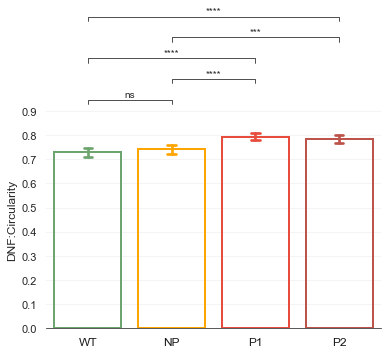

In [84]:
from scipy.sparse.csgraph import structural_rank
from scipy.sparse.csgraph import bellman_ford
import statannot
from scipy.stats import circvar
from scipy.stats import circmean
from scipy.stats import circstd


#data['LSF1D:Total Length'] = [sum([np.linalg.norm((xi[0]-xf[0],xi[1]-xf[1])) for xi,xf in el]) for el in data['Lines']]
#data['LSF2D:Theta2'] = [newtheta(li) for li in data['Lines']]
#data['LSF1D:Theta2 std_dev'] = [np.std(angs) for angs in data['LSF2D:Theta2']]
#data['LSF1D:N over Total L'] =   data['LSF1D:Number of Lines'] / data['LSF1D:Total Length'] 


#data['SKNW:euclidean-distance sigma_mu'] =    data['SKNW:euclidean-distance std_dev'] / data['SKNW:euclidean-distance mean'] 
#data['SKNW:Total Length'] = [sum(summarize(Skeleton((el[0]).astype(float)),find_main_branch=False)['branch-distance']) for el in data['Patches']]
#data['SKNW:Total Length'] = [np.sum(el[0]) for el in data['Patches']]
#data['SKNW:N over Total L'] = data['SKNW:Number of Branches'] / data['SKNW:Total Length']
#data['SKNW:Structural Rank'] = [structural_rank(Skeleton((el[0]).astype(float))) for el in data['Patches']]
#data['SKNW:Bellman Ford Shortest Path'] = [structural_rank(Skeleton((el[0]).astype(float))) for el in data['Patches']]
#data['SKNW:branch-distance above 1'] = [np.mean(list(filter(lambda dist: dist > 1, summarize(Skeleton((el[0]).astype(float)))['branch-distance'] ))) for el in data['Patches']]
#data['SKNW:euclidean-distance above 3'] = [np.mean(list(filter(lambda dist: dist >= 4, summarize(Skeleton((el[0]).astype(float)))['euclidean-distance'] ))) for el in data['Patches']]
#data['SKNW:Density'] =  [nx.density(sknw.build_sknw(el[0])) for el in data['Patches']]
#data['SKNW:Density'] =  [(2*sknw.build_sknw(el[0]).number_of_edges()) / (sknw.build_sknw(el[0]).number_of_nodes()*(sknw.build_sknw(el[0]).number_of_nodes()-1)) for el in data['Patches']]
#data['SKNW:NEdges over NNodes'] =  [ sknw.build_sknw(el[0]).number_of_nodes() / sknw.build_sknw(el[0]).number_of_edges()  for el in data['Patches']]
#data['SKNW:s metric'] = [nx.s_metric(sknw.build_sknw(el[0]),normalized=False) for el in data['Patches']]
#data['SKNW:Mean Tortuosity'] = [np.mean(np.ma.masked_invalid(summarize(Skeleton((el[0]).astype(float))).loc[np.where(summarize(Skeleton((el[0]).astype(float)))['branch-distance'] > 7)[0]]['branch-distance'] / summarize(Skeleton((el[0]).astype(float))).loc[np.where(summarize(Skeleton((el[0]).astype(float)))['branch-distance'] > 7)[0]]['euclidean-distance'])) for el in data['Patches']]
#data['SKNW:Std Tortuosity'] = [np.std(np.ma.masked_invalid(summarize(Skeleton((el[0]).astype(float))).loc[np.where(summarize(Skeleton((el[0]).astype(float)))['branch-distance'] > 7)[0]]['branch-distance'] / summarize(Skeleton((el[0]).astype(float))).loc[np.where(summarize(Skeleton((el[0]).astype(float)))['branch-distance'] > 7)[0]]['euclidean-distance'])) for el in data['Patches']]
#data['SKNW:Sigma mu Tortuosity'] = data['SKNW:Std Tortuosity'] / data['SKNW:Mean Tortuosity']
#data['SKNW:Clique Number'] = [nx.graph_clique_number(sknw.build_sknw(el[0])) for el in data['Patches']]
#data['SKNW:Degree Centrality Sum'] = [sum(nx.degree_centrality(sknw.build_sknw(el[0])).values()) for el in data['Patches']]
#data['SKNW:Degree Centrality Mean'] = [np.mean(list(nx.degree_centrality(sknw.build_sknw(el[0])).values())) for el in data['Patches']]
#data['SKNW:Degree Centrality Std'] = [np.std(list(nx.degree_centrality(sknw.build_sknw(el[0])).values())) for el in data['Patches']]
#data['SKNW:Degree Centrality Sigma mu'] = data['SKNW:Degree Centrality Std'] / data['SKNW:Degree Centrality Mean']
#data['SKNW:Normalized Laplacian Spectrum'] = [np.mean(nx.normalized_laplacian_spectrum(sknw.build_sknw(el[0]))) for el in data['Patches']]
#data['LSF2D:TriAreas over N'] = data['LSF2D:Triangle Areas mean'] / data['LSF1D:Number of Lines']
#data['LSF1D:Alpha mean over N'] = data['LSF2D:Angles mean'] / data['LSF1D:Number of Lines']
#data['LSF1D:Alpha std_dev over N'] = data['LSF2D:Angles std_dev'] / data['LSF1D:Number of Lines']
#data['exp'] = data['LSF1D:Alpha std_dev over N'] / data['LSF1D:Alpha mean over N']
#data['exp'] = data['LSF2D:Angles std_dev'] / data['LSF2D:Number of Lines']
#data['LSF1D:TriAreas over N mean all'] = [np.mean(np.array(ResultsDF['LSF2D:Triangle Areas'][el]) / np.array(ResultsDF['LSF1D:Number of Lines'][el])) for el in ResultsDF.index]
#data['LSF1D:TriAreas over N std all'] = [np.std(np.array(ResultsDF['LSF2D:Triangle Areas'][el]) / np.array(ResultsDF['LSF1D:Number of Lines'][el])) for el in ResultsDF.index]
#data['LSF1D:Dist over N all'] = [np.mean(np.array(ResultsDF['LSF2D:Distances to Centroid'][el]) / np.array(ResultsDF['LSF1D:Number of Lines'][el])) for el in ResultsDF.index]

#data['exp'] = [np.mean(np.array(ResultsDF['LSF2D:Distances to Centroid'][el]) / np.array(ResultsDF['LSF2D:Triangle Areas'][el])) for el in ResultsDF.index]
#data['exp'] = [np.mean(np.array(ResultsDF['LSF2D:Triangle Areas'][el]) / np.array(ResultsDF['LSF2D:Line Lengths'][el])) for el in ResultsDF.index]
#data['exp'] = [np.mean(np.array(ResultsDF['LSF2D:Angles'][el]) / np.array(ResultsDF['LSF2D:Line Lengths'][el])) for el in ResultsDF.index]
#data['LSF1D:Theta2 std_dev'] = [np.std(el)  for el in data['LSF2D:Theta2']]
#data['LSF1D:Theta2 mean'] = [np.mean(el)  for el in data['LSF2D:Theta2']]
#data['LSF1D:Theta2 std_dev over N'] = data['LSF1D:Theta2 std_dev'] / data['LSF1D:Number of Lines']
#data['LSF1D:Theta2 sigma_mu'] = data['LSF1D:Theta2 std_dev'] / data['LSF1D:Theta2 mean']
#data['LSF1D:Angle Difference sigma_mu'] = data['LSF2D:Angle Difference std_dev'] / data['LSF2D:Angle Difference mean']
#data['exp'] = data['LSF2D:Std. Angle Difference std_dev'] / data['LSF2D:Std. Angle Difference mean']
#data['exp'] = [np.mean(np.array(ResultsDF['LSF2D:Local Line Distance'][el]) / np.array(ResultsDF['LSF2D:Distances to Centroid'][el])) for el in ResultsDF.index]
#data['exp'] = [np.mean(np.array(ResultsDF['LSF2D:Std. Angle Difference'][el]) / np.array(ResultsDF['LSF2D:Distances to Centroid'][el])) for el in ResultsDF.index]



#data['DCF:CV'] =  data['DCF:Std'] / data['DCF:Mean Intensity'] 
#data['LSF1D:Circular Variance'] =  [circvar(np.array(l)*np.pi/180,low=0,high=np.pi) for l in data['LSF2D:Theta2']]
#data['LSF1D:Circular Mean'] =  [circmean(np.array(l)*np.pi/180,low=0,high=np.pi) for l in data['LSF2D:Theta2']]
#data['LSF1D:Circular Std'] =  [circstd(np.array(l)*np.pi/180,low=0,high=np.pi) for l in data['LSF2D:Theta2']]
#data['LSF1D:Circular sigma_mu'] = data['LSF1D:Circular Std'] / data['LSF1D:Circular Mean']
#data['LSF1D:Circular Dispersion'] = [circdisp(angles) for angles in data['LSF2D:Theta2']]

#data['LSF1D:HI'] =  [HI(angles) for angles in data['LSF2D:Theta2']]

#data['LSF1D:Line Lengths over Total Length mean'] = [np.mean(x) for x in [np.array(ResultsDF['LSF2D:Line Lengths'][el]) / data['LSF1D:Total Length'][el] for el in range(len(ResultsDF['LSF2D:Line Lengths']))]]
#data['LSF1D:Line Lengths over Total Length std'] = [np.std(x) for x in [np.array(ResultsDF['LSF2D:Line Lengths'][el]) / data['LSF1D:Total Length'][el] for el in range(len(ResultsDF['LSF2D:Line Lengths']))]]
#data['LSF1D:Line Lengths over Total Length sigma mu'] = data['LSF1D:Line Lengths over Total Length std'] / data['LSF1D:Line Lengths over Total Length mean']
#data['LSF1D:N over A'] = data['LSF1D:Number of Lines'] / data['DCF:Area']

#data['LSF1D:OOP'] = [OOP(anglist) for anglist in data['LSF2D:Theta2']]

#data['LSF1D:Angle Difference sigma_mu'] = data['LSF2D:Angle Difference std_dev'] / data['LSF2D:Angle Difference mean']
#data['SKNW:stdev-pixel-value sigma_mu'] = data['SKNW:stdev-pixel-value std_dev'] / data['SKNW:stdev-pixel-value mean']
#data['SKNW:mean-pixel-value sigma_mu'] = data['SKNW:mean-pixel-value std_dev'] / data['SKNW:mean-pixel-value mean']
#data['SKNW:branch-distance sigma_mu'] = data['SKNW:branch-distance std_dev'] / data['SKNW:branch-distance mean']
#data['LSF1D:Line Lengths sigma_mu'] = data['LSF2D:Line Lengths std_dev'] / data['LSF2D:Line Lengths mean']
data['LSF1D:Line Lengths sigma_mu'] = data['LSF2D:Line Lengths std_dev'] / data['LSF2D:Line Lengths mean']

#data['SKNW:Sholl Crossings Cyto CV'] = data['SKNW:Sholl Crossings Cyto std_dev'] / data['SKNW:Sholl Crossings Cyto mean']


# ------------------------
feat = 'DNF:Circularity'
SAVE = False
# ------------------------

#7EB77F
colors = ["#6DA56E","#FFA500","#E74C3C","#BC544B"]
labels = ['WT','NP','P1','P2']
pairs  = [(('WT', 'Dup41_46')), (('WT', 'Del38_46')), (('WT', 'Mut394')), (('Dup41_46', 'Del38_46')), (('Dup41_46', 'Mut394'))]

# colors   = ["#2ECC71","#DECF77","#5AB7BD","#FFA500","#E74C3C","#BC544B",]
# labels   = ['WT','No transfection','Mock','Dup41_46','Del38_46','Mut394']
# pairs    = [(('WT', 'No transfection')),(('WT', 'Mock')),(('WT', 'Dup41_46')), (('WT', 'Del38_46')), (('WT', 'Mut394'))] 


# DISPLOT / BARPLOT
%matplotlib inline
fig,ax = plt.subplots()
sns.set_theme(style="white")
# 4
sns.barplot(x="Label", y=feat, data=data,order=['WT','Dup41_46','Del38_46','Mut394'],capsize=.1,ci=95,edgecolor=colors,fill=False,linewidth=2)
ax.set_xticks(ax.get_xticks(),labels,font='arial',color='k')
ax.set_yticks(ax.get_yticks(),font='arial',color='k')

patches = ax.patches
lines_per_err = 3

for i, line in enumerate(ax.get_lines()):
    newcolor = patches[i // lines_per_err].get_edgecolor()
    line.set_color(newcolor)
    
ax.set_xlabel(None)
plt.rcParams['axes.linewidth'] = 0.75
statannot.add_stat_annotation(plt.gca(),data=data,x="Label",y=feat, order=['WT','Dup41_46','Del38_46','Mut394'],box_pairs=pairs,test='t-test_ind',text_format="star",loc="outside",fontsize='small',comparisons_correction=None,color='k',linewidth=0.75)

#ax.spines['bottom'].set_visible(False)

# 6
#sns.barplot(x="Label", y=feat, data=data,order=['WT','No transfection','Mock','Dup41_46','Del38_46','Mut394'],palette=colors,capsize=.1)
#statannot.add_stat_annotation(plt.gca(),data=data,x="Label",y=feat, order=['WT','No transfection','Mock','Dup41_46','Del38_46','Mut394'],box_pairs=pairs,test='t-test_ind',text_format="star",loc="outside",fontsize='small',comparisons_correction=None)

#sns.kdeplot(data=data, x=feat,hue="Label",hue_order=['WT','Dup41_46','Del38_46','Mut394'],palette=colors,linewidth=3,bw_adjust=.8,common_norm=False,ax=ax)
sns.despine(left=True)
plt.grid(alpha=0.2,axis='y')
if SAVE:
    plt.savefig(".//res_2jan23//" + str(feat.split(':')[0]) + "-"  + str(feat.split(':')[1]) + ".png",format='png',transparent=True,bbox_inches='tight',dpi=200)


In [11]:
def circdisp(angles):
    theta_rad = np.array(angles)*np.pi/180
    n = len(angles)
    
    # 1
    C1 = sum([np.cos(1*a) for a in theta_rad])
    C1_ = C1 / n
    S1 = sum([np.sin(1*a) for a in theta_rad])
    S1_ = S1 / n
    
    R1 = np.sqrt(C1**2 + S1**2)
    R1_ = R1 / n
    
    if C1_ > 0 and S1_ > 0:
        T1 = np.arctan(S1_/C1_)
    if C1_ < 0:
        T1 = np.arctan(S1_/C1_) + np.pi
    if S1_ < 0 and C1_ > 0:
        T1 = np.arctan(S1_/C1_) + 2*np.pi
    
    # 2
    C2 = sum([np.cos(2*a) for a in theta_rad])
    C2_ = C2 / n
    S2 = sum([np.sin(2*a) for a in theta_rad])
    S2_ = S2 / n
    
    R2 = np.sqrt(C2**2 + S2**2)
    R2_ = R2 / n
    
    if C2_ > 0 and S2_ > 0:
        T2 = np.arctan(S2_/C2_)
    if C2_ < 0:
        T2 = np.arctan(S2_/C2_) + np.pi
    if S2_ < 0 and C2_ > 0:
        T2 = np.arctan(S2_/C2_) + 2*np.pi
        
    delta = ((1-T2)) / (2*(R2_**2))
    kurt  = ((R2_ * np.cos(T2-2*T1)) - R1_**4) / (1-R1_)**2
    skew  = (R2_ * np.sin(T2-2*T1))  / (1-R1_)**(3/2)
    
    
    return np.sqrt(-2*np.log(R1_))

In [6]:
from shapely.geometry import MultiPoint, Point, Polygon
from scipy.spatial import Voronoi
import rasterio
from rasterio import features
import shapely

row = ResultsDF.loc[0]

img = DeconvDF['Image'][row['Img Index']] * row['Mask']
threshold = (img!=0)*1

points = np.array([((line[0][0] + line[1][0])/2,(line[0][1] + line[1][1])/2) for line in row['Lines']])

vor = Voronoi(points)

regions, vertices = voronoi_finite_polygons_2d(vor)






pts = MultiPoint([Point(i) for i in points])

mask = mask_to_polygons_layer(threshold)

#mask=pts.convex_hull
#mask = data.loc[0]['Mask']
new_vertices = []
for region in regions:
    polygon = vertices[region]
    shape = list(polygon.shape)
    shape[0] += 1
    p = Polygon(np.append(polygon, polygon[0]).reshape(*shape)).intersection(mask)
    poly = np.array(list(zip(p.boundary.coords.xy[0][:-1], p.boundary.coords.xy[1][:-1])))
    new_vertices.append(poly)
    plt.fill(*zip(*poly), alpha=0.4)
plt.plot(points[:,0], points[:,1], 'ko')
plt.title("Clipped Voronois")
plt.show()















ModuleNotFoundError: No module named 'rasterio'

In [27]:
def mask_to_polygons_layer(mask):
    all_polygons = []
    for shape, value in features.shapes(mask.astype(np.int16), mask=(mask >0), transform=rasterio.Affine(1.0, 0, 0, 0, 1.0, 0)):
        return shapely.geometry.shape(shape)
        all_polygons.append(shapely.geometry.shape(shape))

    all_polygons = shapely.geometry.MultiPolygon(all_polygons)
    if not all_polygons.is_valid:
        all_polygons = all_polygons.buffer(0)
        # Sometimes buffer() converts a simple Multipolygon to just a Polygon,
        # need to keep it a Multi throughout
        if all_polygons.type == 'Polygon':
            all_polygons = shapely.geometry.MultiPolygon([all_polygons])
    return all_polygons

In [21]:
Polygon(data.loc[0]['Mask'])

AssertionError: 

In [16]:
def voronoi_finite_polygons_2d(vor, radius=None):
    """
    Reconstruct infinite voronoi regions in a 2D diagram to finite
    regions.

    Parameters
    ----------
    vor : Voronoi
        Input diagram
    radius : float, optional
        Distance to 'points at infinity'.

    Returns
    -------
    regions : list of tuples
        Indices of vertices in each revised Voronoi regions.
    vertices : list of tuples
        Coordinates for revised Voronoi vertices. Same as coordinates
        of input vertices, with 'points at infinity' appended to the
        end.

    """

    if vor.points.shape[1] != 2:
        raise ValueError("Requires 2D input")

    new_regions = []
    new_vertices = vor.vertices.tolist()

    center = vor.points.mean(axis=0)
    if radius is None:
        radius = vor.points.ptp().max()

    # Construct a map containing all ridges for a given point
    all_ridges = {}
    for (p1, p2), (v1, v2) in zip(vor.ridge_points, vor.ridge_vertices):
        all_ridges.setdefault(p1, []).append((p2, v1, v2))
        all_ridges.setdefault(p2, []).append((p1, v1, v2))

    # Reconstruct infinite regions
    for p1, region in enumerate(vor.point_region):
        vertices = vor.regions[region]

        if all(v >= 0 for v in vertices):
            # finite region
            new_regions.append(vertices)
            continue

        # reconstruct a non-finite region
        ridges = all_ridges[p1]
        new_region = [v for v in vertices if v >= 0]

        for p2, v1, v2 in ridges:
            if v2 < 0:
                v1, v2 = v2, v1
            if v1 >= 0:
                # finite ridge: already in the region
                continue

            # Compute the missing endpoint of an infinite ridge
            t = vor.points[p2] - vor.points[p1] # tangent
            t /= np.linalg.norm(t)
            n = np.array([-t[1], t[0]])  # normal

            midpoint = vor.points[[p1, p2]].mean(axis=0)
            direction = np.sign(np.dot(midpoint - center, n)) * n
            far_point = vor.vertices[v2] + direction * radius * 10

            new_region.append(len(new_vertices))
            new_vertices.append(far_point.tolist())

        # sort region counterclockwise
        vs = np.asarray([new_vertices[v] for v in new_region])
        c = vs.mean(axis=0)
        angles = np.arctan2(vs[:,1] - c[1], vs[:,0] - c[0])
        new_region = np.array(new_region)[np.argsort(angles)]

        # finish
        new_regions.append(new_region.tolist())

    return new_regions, np.asarray(new_vertices)

def get_dx_dy(angle, dist):
    cartesianAngleRadians = (450-angle)*math.pi/180.0
    dx = dist * math.cos(cartesianAngleRadians)
    dy = dist * math.sin(cartesianAngleRadians)
    return dx, dy

In [16]:
ori = np.array([row['ROImask'] * OriginalDF['Image'][row['Index']][:,:,i] for i in [0,1,2]])
np.stack([ori[0],ori[1],ori[2]],axis=2).shape

(1040, 1388, 3)

In [6]:
# create mask with same dimensions as image
mask__ = np.zeros_like(OriginalDF['Image'][row['Index']])

# copy your image_mask to all dimensions (i.e. colors) of your image
for i in range(3): 
    mask__[:,:,i] = row['ROImask'].astype(bool).copy()

# apply the mask to your image
masked_image = OriginalDF['Image'][row['Index']][mask__]

ValueError: Could not interpret input 'Label'

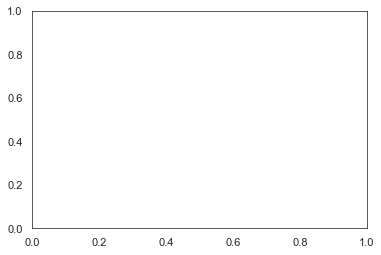

In [20]:
# Stacked Barplots

def stackedbarplots(ResultsDF):
    r = [0,1,2,3]
    l,f1,f2,f3,f4 = 'Label','SKNW:Ratio of Endpoint-to-endpoint (isolated branch)','SKNW:Ratio of Junction-to-endpoints','SKNW:Ratio of Junction-to-junctions','SKNW:Ratio of Isolated cycles'
    data = pd.concat([ResultsDF[f1],ResultsDF[f2],ResultsDF[f3],ResultsDF[f4]],axis=1)
    
    colors = ["#2ECC71","#FFA500","#E74C3C","#BC544B"]
    labels = ['WT','Dup41_46','Del38_46','Mut394']
    pairs  = [(('WT', 'Dup41_46')), (('WT', 'Del38_46')), (('WT', 'Mut394'))]
    
    # From raw value to percentage
    totals = [i+j+k+w for i,j,k,w in zip(ResultsDF[f1], ResultsDF[f2], ResultsDF[f3],ResultsDF[f4])]
    greenBars = [i / j * 100 for i,j in zip(ResultsDF[f1], totals)]
    orangeBars = [i / j * 100 for i,j in zip(ResultsDF[f2], totals)]
    blueBars = [i / j * 100 for i,j in zip(ResultsDF[f3], totals)]
    fourBars = [i / j * 100 for i,j in zip(ResultsDF[f4], totals)]

    # plot
    barWidth = 0.85
    names = ('A','B','C','D','E')
    # Create green Bars
    plt.bar(r, greenBars, color='#b5ffb9', edgecolor='white', width=barWidth)
    # Create orange Bars
    plt.bar(r, orangeBars, bottom=greenBars, color='#f9bc86', edgecolor='white', width=barWidth)
    # Create blue Bars
    plt.bar(r, blueBars, bottom=[i+j for i,j in zip(greenBars, orangeBars)], color='#a3acff', edgecolor='white', width=barWidth)
    # Create last Bars
    plt.bar(r, fourBars, bottom=[i+j+k for i,j,k in zip(greenBars, orangeBars,blueBars)], color='#a3acff', edgecolor='white', width=barWidth)

    
    # Custom x axis
    #plt.xticks(r, names)
    #plt.xlabel("group")


    fig,ax = plt.subplots()
    sns.barplot(x=l, y=[f1,f2,f3,f4], data=data, estimator=sum, ci=95,  color='lightblue')
    plt.show()
    
stackedbarplots(ResultsDF)
    
#sns.barplot(x="Label", y=feat, data=data,order=['WT','Dup41_46','Del38_46','Mut394'],palette=colors,capsize=.1)


In [24]:
from pylsd.lsd import lsd
lines = lsd(skeleton)

   double sigma_scale = 0.6; /* Sigma for Gaussian filter is computed as
                                sigma = sigma_scale/scale.                    */
    double quant = 2.0;       /* Bound to the quantization error on the
                                gradient norm.                                */
    double ang_th = 22.5;     /* Gradient angle tolerance in degrees.           */
    double eps = 0.0;         /* Detection threshold, -log10(NFA).              */
    double density_th = 0.7;  /* Minimal density of region points in rectangle. */
    int n_bins = 1024;        /* Number of bins in pseudo-ordering of gradient
                               modulus.                                       */
    double max_grad = 255.0;  /* Gradient modulus in the highest bin. The
                               default value corresponds to the highest
                               gradient modulus on images with gray
                               levels in [0,255].   


lines

array([], shape=(0, 5), dtype=float64)

In [27]:
lines = lsd(skeleton,sigma_scale = 2.5)

TypeError: lsd() got an unexpected keyword argument 'sigma_scale'

In [26]:
lsd_old   = cv2.createLineSegmentDetector(cv2.LSD_REFINE_ADV,2.5,0.001,0,90,-200,0.5,2048)
lines_old = cv2toski(lsd.detect((patch * 255).astype(np.uint8))[0])

AttributeError: 'function' object has no attribute 'detect'

In [69]:
from pylsd import lsd
lines_ = lsd((patch*255).astype(np.uint8),scale=2.5,sigma_scale=0.001,quant=0,ang_th=90,eps=-200,density_th=0.5,n_bins=2048,max_grad=1)
lines_ = [((x[0],x[2]),(x[1],x[3])) for x in lines_]

plt.figure()
plt.imshow(patch,cmap='gray')
for line in lines_:
    p0,p1 = line
    
    plt.plot(p0,p1,color='r')
    
plt.show()

In [6]:
x,y
for line in lines:
    p0,p1 = line
    
    if np.linalg.norm(p0-centroid) > np.linalg.norm(p1-centroid):
        

[((797.786, 346.892), (802.031, 341.178)),
 ((826.491, 352.276), (824.517, 347.635)),
 ((830.557, 380.366), (834.499, 375.439)),
 ((812.213, 334.833), (817.874, 332.587)),
 ((780.867, 363.788), (776.118, 364.823)),
 ((790.724, 352.733), (795.647, 351.898)),
 ((816.025, 381.355), (822.188, 372.392)),
 ((809.679, 352.884), (811.968, 356.162)),
 ((826.706, 335.693), (822.193, 340.844)),
 ((818.475, 375.421), (815.386, 368.07)),
 ((780.081, 380.177), (784.22, 382.979)),
 ((818.818, 345.388), (815.48, 349.269)),
 ((788.097, 359.891), (786.713, 356.105)),
 ((810.732, 391.361), (825.946, 376.933)),
 ((810.638, 357.811), (801.929, 363.16)),
 ((780.707, 369.938), (786.612, 366.189)),
 ((800.149, 366.094), (810.059, 371.46)),
 ((768.152, 367.245), (780.161, 380.062)),
 ((832.553, 352.945), (833.893, 359.002)),
 ((805.428, 361.071), (811.402, 365.903)),
 ((802.291, 363.479), (797.977, 371.073)),
 ((800.5, 345.91), (805.69, 352.487)),
 ((781.153, 392.076), (788.124, 395.361)),
 ((789.973, 322.634)

In [106]:
#graph = ResultsDF['Graph'][0][0]
graph = sknw.build_sknw(skeleton * DeconvDF['Image'][row['Index']])


plt.figure(figsize=(15,15))
plt.imshow(np.zeros_like(skeleton), cmap='gray')
# draw edges by pts
for (s,e) in graph.edges():
    ps = graph[s][e]['pts']
    plt.plot(ps[:,1], ps[:,0], 'white')
# draw node by o
nodes = graph.nodes()
ps_ = np.array([nodes[i]['o'] for i in nodes])
plt.plot(ps_[:,1], ps_[:,0], 'r.')
plt.title('Cytoskeleton Graph')
plt.axis('off')


plt.ylim([min(x_), max(x_)])
plt.xlim([min(y_), max(y_)])
plt.show()

In [24]:
plt.figure()
# a = 
# plt.imshow(OriginalDF['Image'][row['Index']],cmap='gray')


copia = copy.deepcopy(OriginalDF['Image'][row['Index']])
auxiliar = row['ROImask'] * OriginalDF['Image'][row['Index']][:,:,2]
xxx,yyy = np.where(auxiliar != 0)
helpp = np.zeros_like(auxiliar[min(xxx):max(xxx),min(yyy):max(yyy)])
auxiliar = np.stack((auxiliar[min(xxx):max(xxx),min(yyy):max(yyy)],helpp,helpp),axis=2)


plt.imshow(auxiliar)


